- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=3

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=3


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 256  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric_augmented"
)
print(datestring)

cifar10_1.0_1024_256____2020_08_06_16_00_22_032853__learned-metric_augmented


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [10]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [11]:
batch_size = 256

In [12]:
img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
    rotation_range=10,       # random rotation degrees
    width_shift_range=0.1,   # random shift 10%
    height_shift_range=0.1,
    horizontal_flip=True,
    brightness_range = (0.5, 1.5),
    ##rescale = 0.1,
    zoom_range = 0.2,
    rescale=1./255,  
    #shear_range = 6,
    ##zca_whitening = True,
)

In [13]:
labeled_batch_size = 128
labeled_iter = tf.data.Dataset.from_generator(
    lambda: img_data_gen.flow(X_labeled, y=Y_labeled, batch_size=labeled_batch_size),
    (tf.float32, tf.int32),
).prefetch(10)#.batch(10)

In [14]:
X, y = next(iter(labeled_iter))

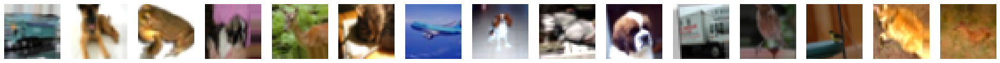

In [15]:
# view augmentations
nex = 15
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [20]:
from umap import UMAP

In [21]:
from tfumap.paths import MODEL_DIR

In [22]:
load_loc = "cifar10_0.0_1024_256____2020_08_01_08_40_18_540610_augmented"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [23]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [24]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [25]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [26]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.5247


In [27]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 16:00:46 2020 Finding Nearest Neighbors
Thu Aug  6 16:00:46 2020 Building RP forest with 10 trees
Thu Aug  6 16:00:48 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 16:01:01 2020 Finished Nearest Neighbor Search
Thu Aug  6 16:01:04 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 16:01:19 2020 Finished embedding


In [28]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 16:01:23 2020 Finding Nearest Neighbors
Thu Aug  6 16:01:23 2020 Building RP forest with 10 trees
Thu Aug  6 16:01:23 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 16:01:24 2020 Finished Nearest Neighbor Search
Thu Aug  6 16:01:24 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 16:01:38 2020 Finished embedding


In [29]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

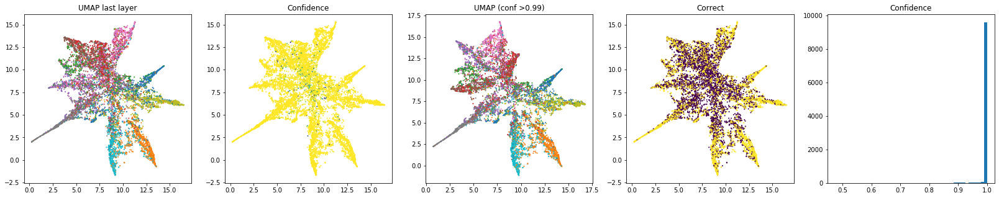

In [30]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [31]:
len(z_pred[Y_valid])

10000

In [32]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

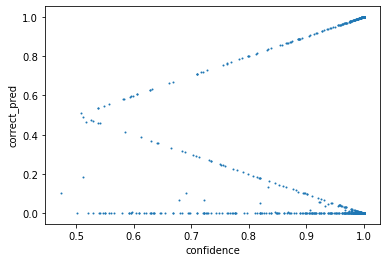

In [33]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [34]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [35]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [36]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [37]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [38]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


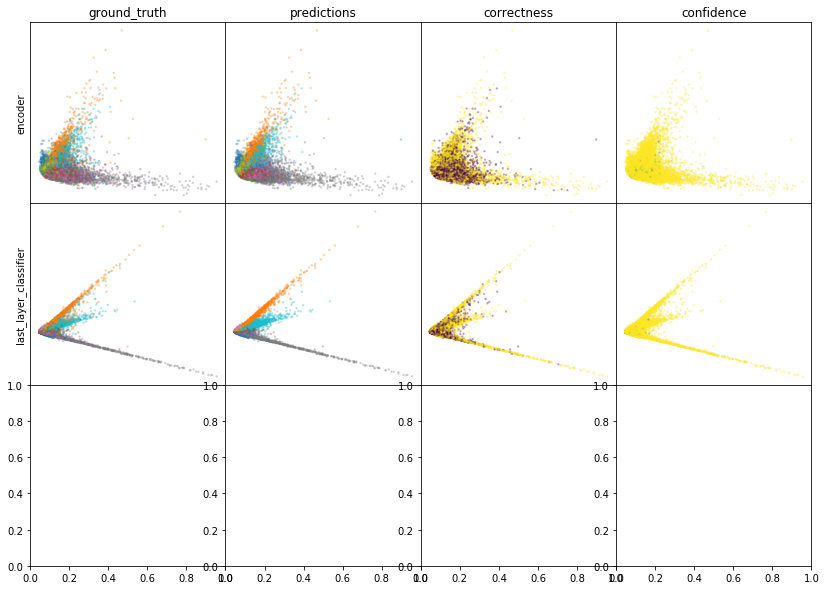

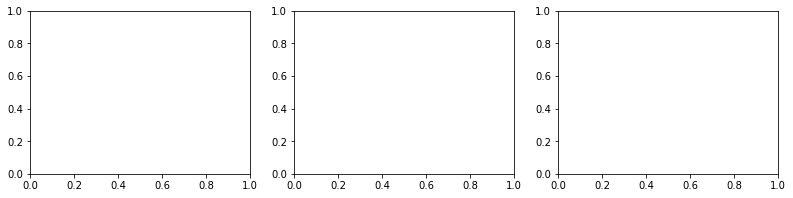

In [39]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [40]:
for i in tqdm(range(100)):
    test = next(img_data_gen.flow(X_labeled[:128], batch_size=128, shuffle=False))

In [41]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

    def augmentation_generator():  # edges_to, edges_from, batch_size
        """
        https://github.com/keras-team/keras/issues/5834
        """
        
        img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
            rotation_range=10,       # random rotation degrees
            width_shift_range=0.1,   # random shift 10%
            height_shift_range=0.1,
            horizontal_flip=True,
            brightness_range = (0.5, 1.5),
            ##rescale = 0.1,
            zoom_range = 0.2,
            rescale=1./255,  
            #shear_range = 6,
            ##zca_whitening = True,
        )
        
        n_batches = int(len(edges_from_exp) / batch_size)
        to_batches = np.reshape(
            edges_to_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        from_batches = np.reshape(
            edges_from_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        for batch_to, batch_from in zip(to_batches, from_batches):
            # yield X_train[batch_to], X_train[batch_from]
            yield (
                next(
                    img_data_gen.flow(
                        X_train[batch_to], batch_size=batch_size, shuffle=False
                    )
                ),
                next(
                    img_data_gen.flow(
                        X_train[batch_from], batch_size=batch_size, shuffle=False
                    )
                ),
            )

    nthreads = 10
    edge_iter = tf.data.Dataset.from_tensor_slices(
        ["Gen_" + str(i) for i in range(nthreads)]
    )
    edge_iter = ds.interleave(
        lambda x: tf.data.Dataset.from_generator(
            augmentation_generator, (tf.float32, tf.float32)
        ),
        cycle_length=nthreads,
        block_length=1,
        num_parallel_calls=nthreads,
    )

    return edge_iter, len(edges_to_exp)

In [42]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

        
    edge_iter = (
        tf.data.Dataset.from_tensor_slices((edges_to_exp, edges_from_exp))
    ).batch(batch_size).prefetch(5)
    
    return edge_iter, len(edges_to_exp)

In [43]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [44]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [45]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [46]:
from tfumap.paths import MODEL_DIR

In [47]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [48]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [49]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [50]:
repeat_augment_tolerance = 25 # augmentations are allowed to be repeated up until this many times 
# we could also have a bank of sampleable augmentations per exemplar

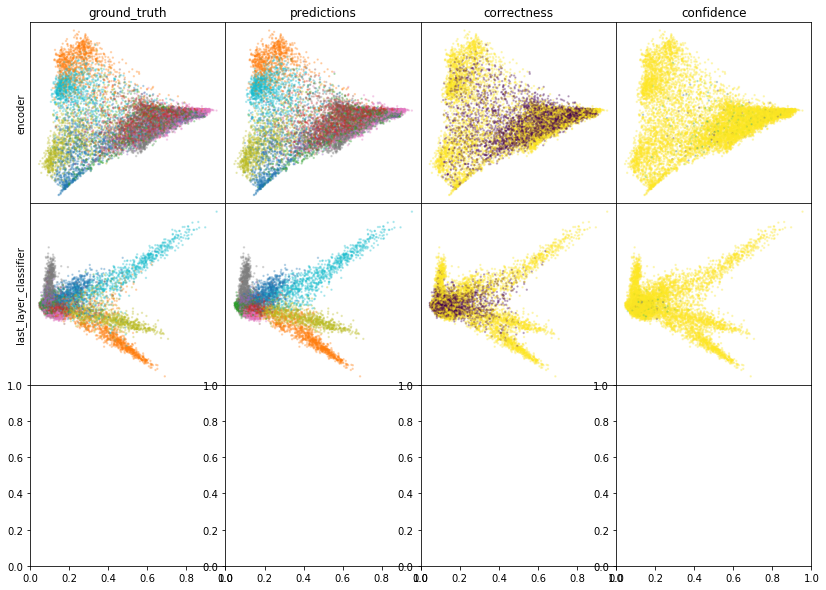

W0807 22:37:45.169551 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:37:46.638299 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:37:47.994680 140336071132928 legend.py:1282] No handles with labels found to put in legend.


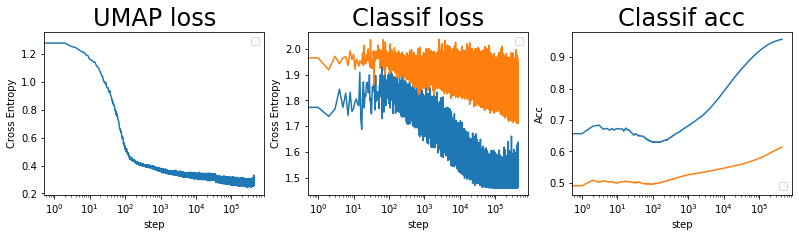

batch: 435000 | train acc: 0.957 | val acc: 0.6134


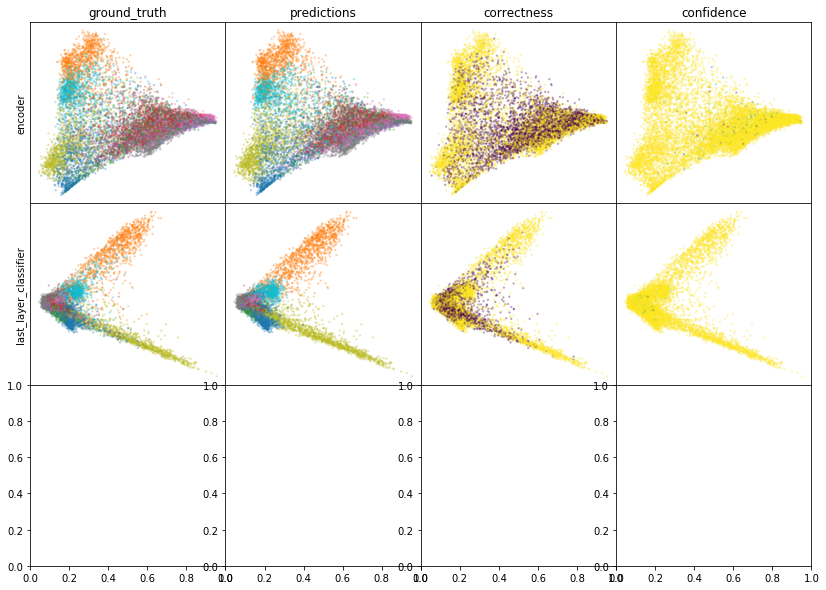

W0807 22:43:25.315160 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:43:26.789355 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:43:28.148974 140336071132928 legend.py:1282] No handles with labels found to put in legend.


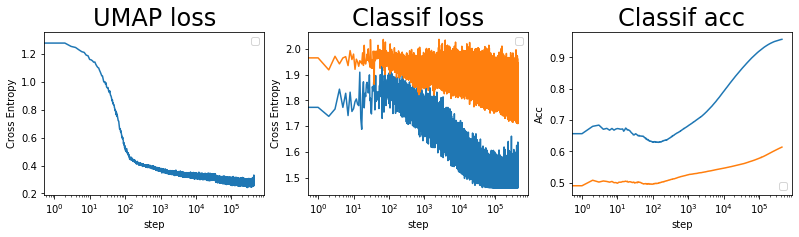

batch: 436000 | train acc: 0.9571 | val acc: 0.6135


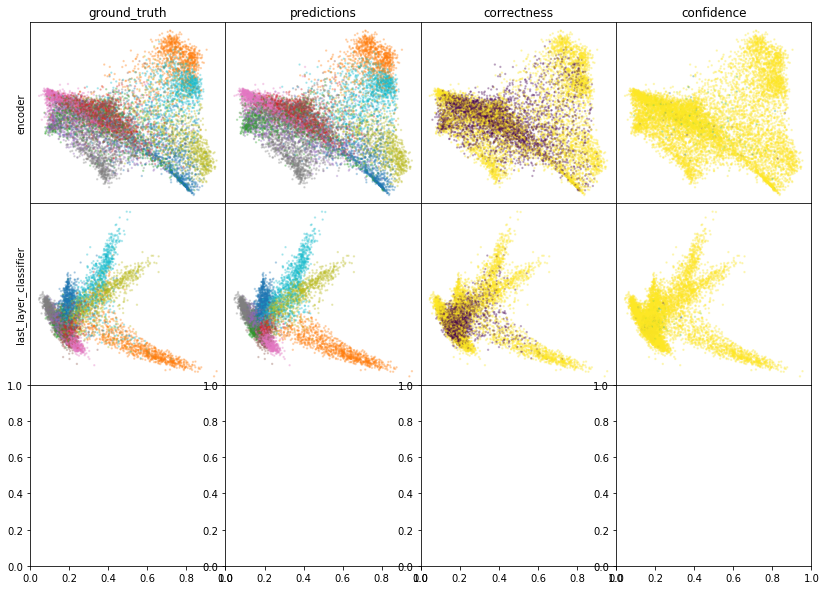

W0807 22:49:32.170273 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:49:33.644006 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:49:35.001364 140336071132928 legend.py:1282] No handles with labels found to put in legend.


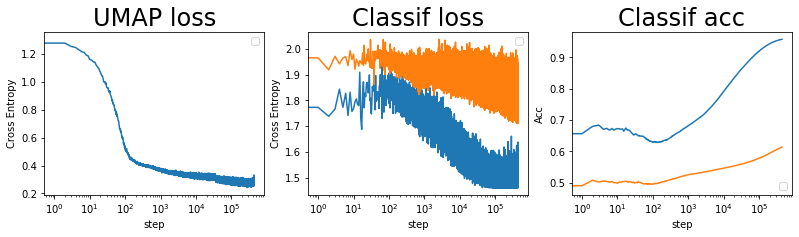

batch: 437000 | train acc: 0.9571 | val acc: 0.6135


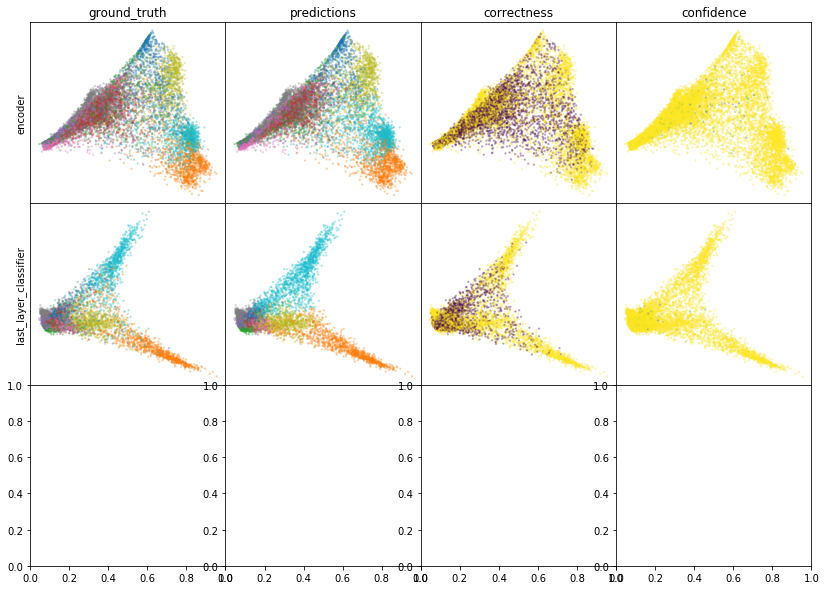

W0807 22:55:04.018450 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:55:05.482587 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 22:55:06.840816 140336071132928 legend.py:1282] No handles with labels found to put in legend.


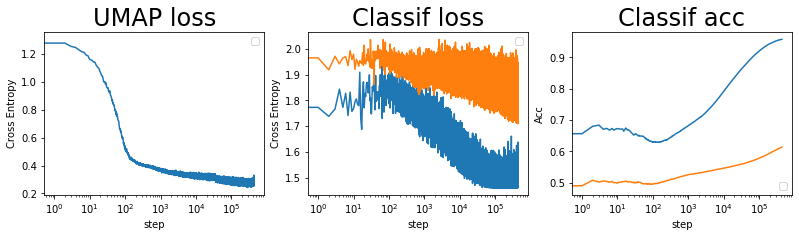

batch: 438000 | train acc: 0.9571 | val acc: 0.6136


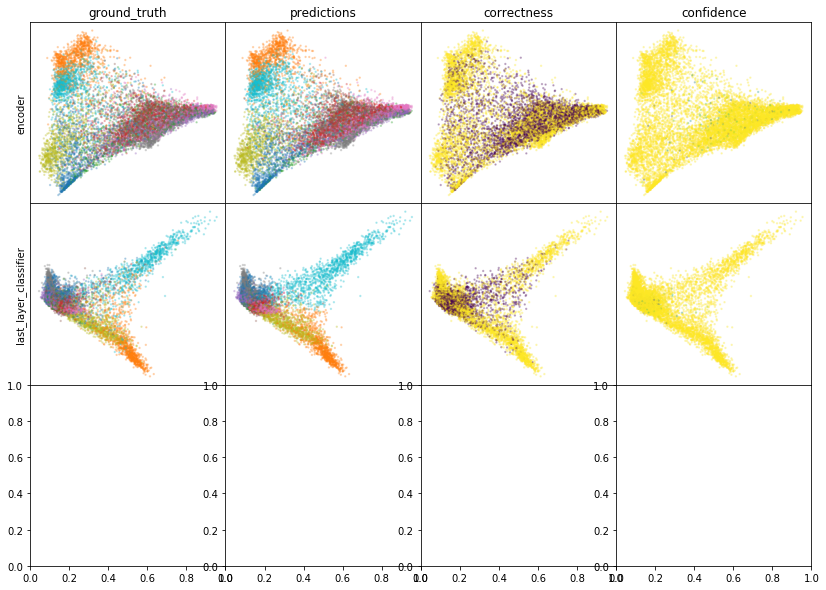

W0807 23:01:04.771530 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:01:06.373184 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:01:07.902605 140336071132928 legend.py:1282] No handles with labels found to put in legend.


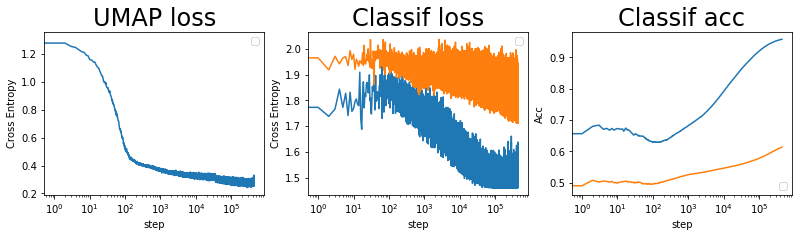

batch: 439000 | train acc: 0.9571 | val acc: 0.6136


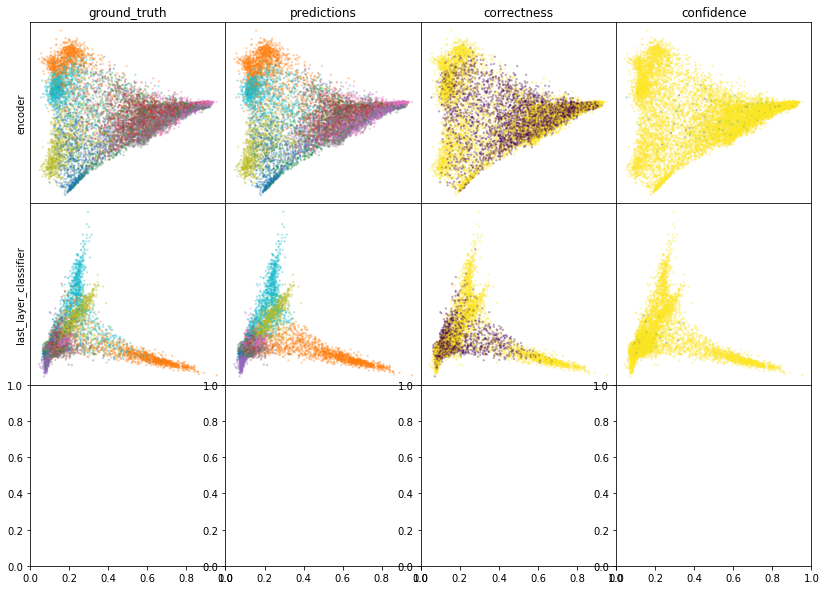

W0807 23:06:59.196826 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:07:00.881522 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:07:02.464737 140336071132928 legend.py:1282] No handles with labels found to put in legend.


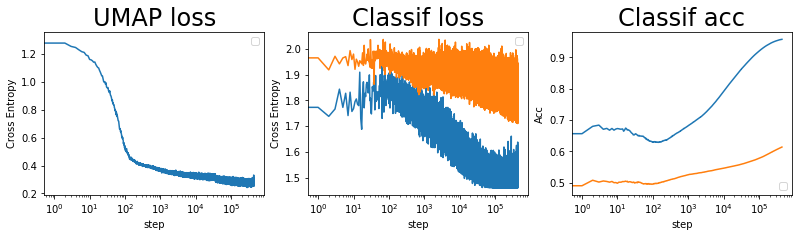

batch: 440000 | train acc: 0.9571 | val acc: 0.6137


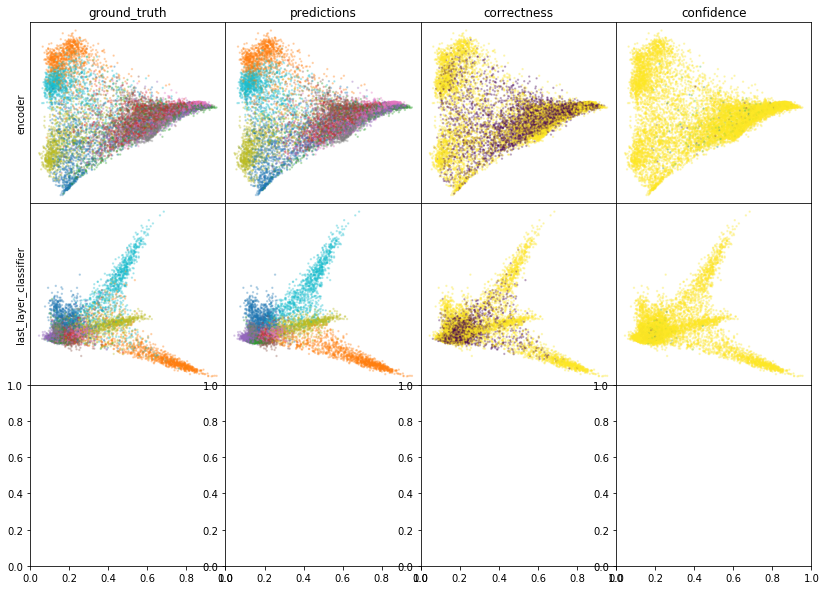

W0807 23:13:56.458908 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:58.080036 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:59.593153 140336071132928 legend.py:1282] No handles with labels found to put in legend.


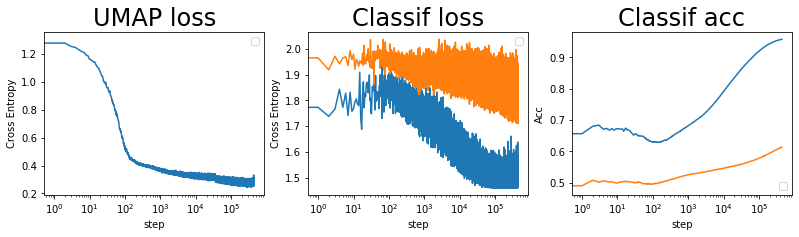

batch: 441000 | train acc: 0.9572 | val acc: 0.6137


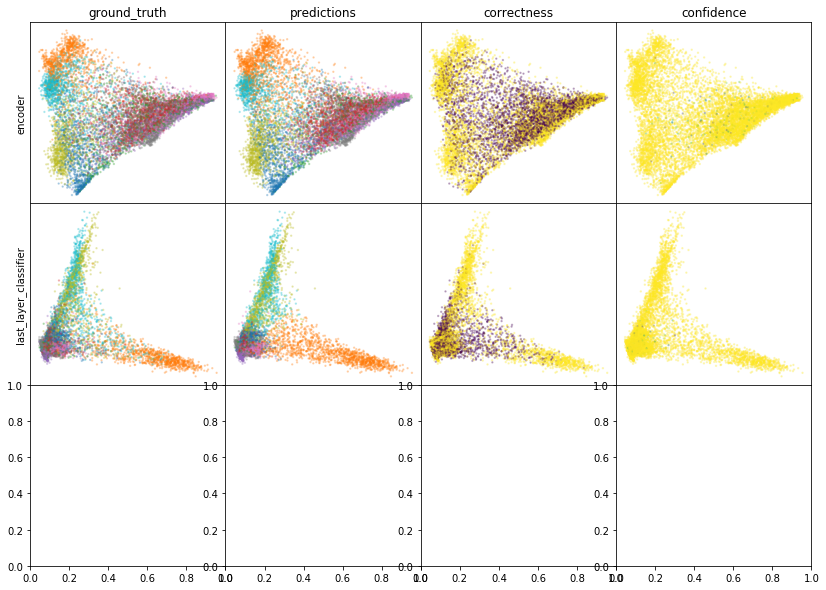

W0807 23:20:43.085152 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:44.633438 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:46.087579 140336071132928 legend.py:1282] No handles with labels found to put in legend.


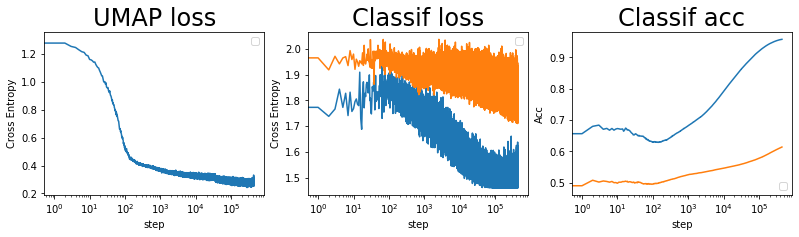

batch: 442000 | train acc: 0.9572 | val acc: 0.6137


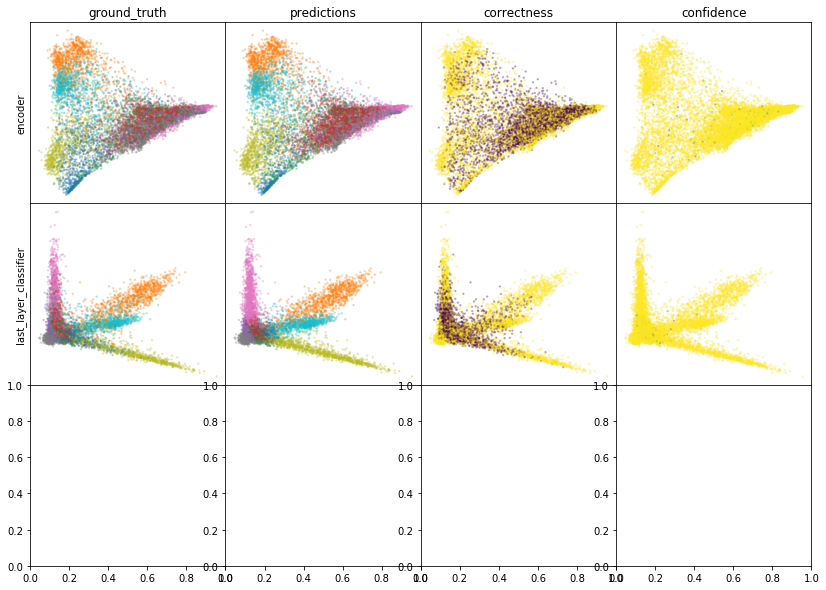

W0807 23:27:56.189877 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:27:57.757472 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:27:59.270822 140336071132928 legend.py:1282] No handles with labels found to put in legend.


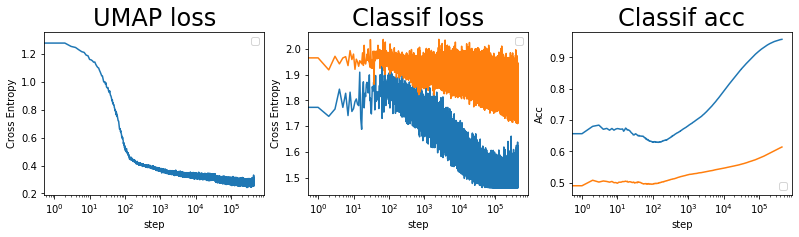

batch: 443000 | train acc: 0.9572 | val acc: 0.6138


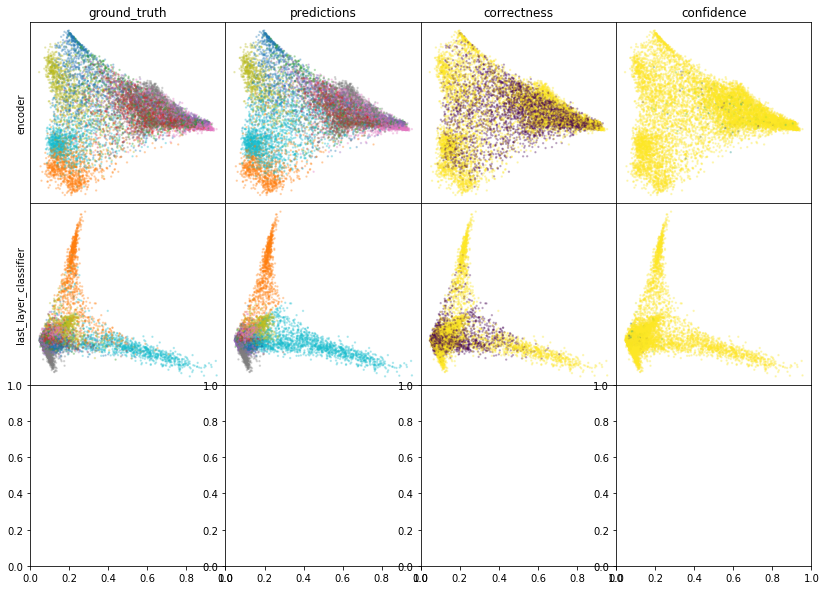

W0807 23:34:46.116117 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:47.712969 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:49.193033 140336071132928 legend.py:1282] No handles with labels found to put in legend.


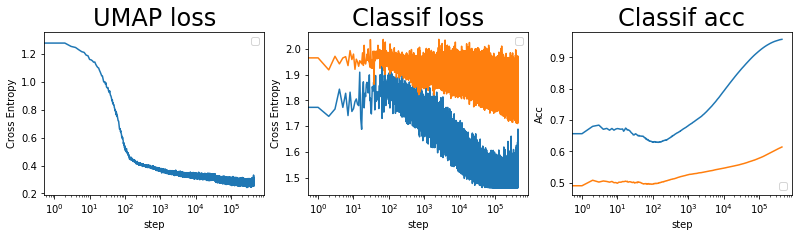

batch: 444000 | train acc: 0.9572 | val acc: 0.6138


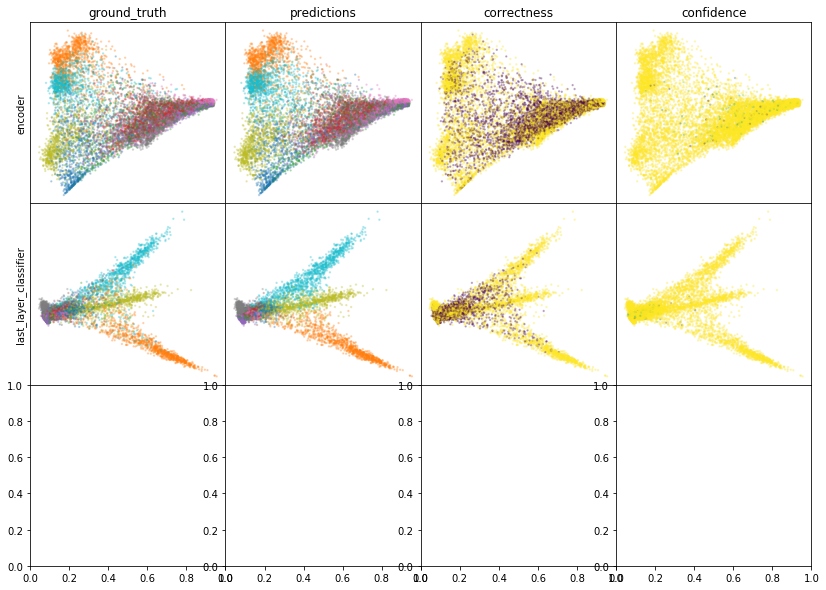

W0807 23:41:55.387823 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:57.051964 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:58.558801 140336071132928 legend.py:1282] No handles with labels found to put in legend.


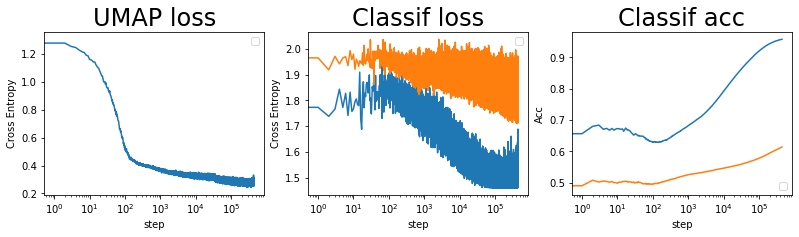

batch: 445000 | train acc: 0.9572 | val acc: 0.6139


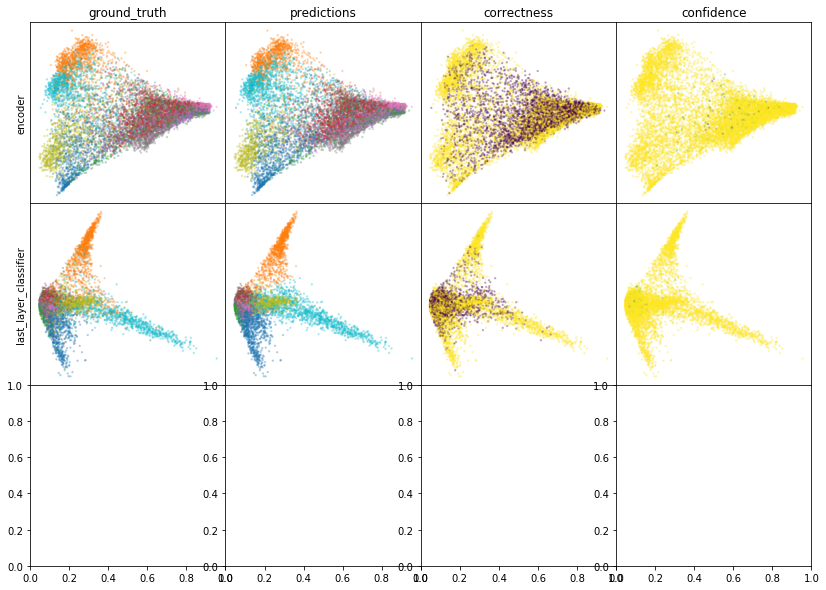

W0807 23:48:41.729998 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:48:43.346740 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:48:44.860386 140336071132928 legend.py:1282] No handles with labels found to put in legend.


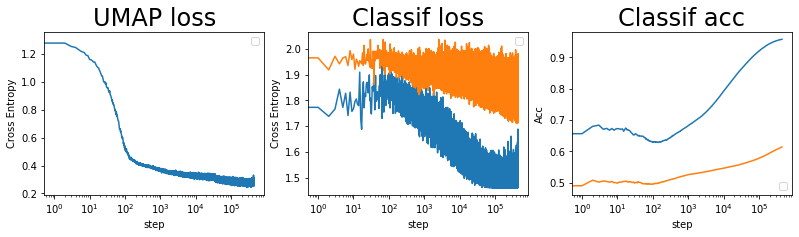

batch: 446000 | train acc: 0.9572 | val acc: 0.6139


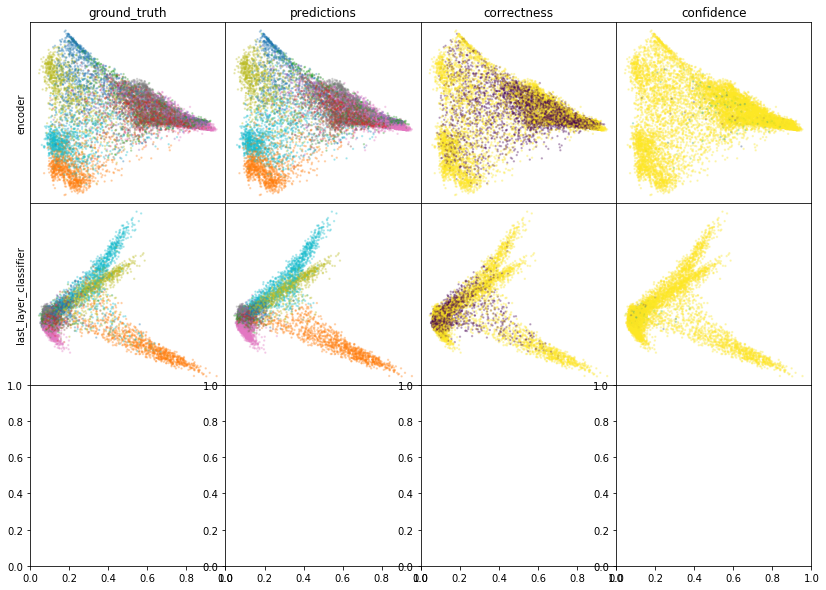

W0807 23:56:02.476913 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:04.084929 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:05.611046 140336071132928 legend.py:1282] No handles with labels found to put in legend.


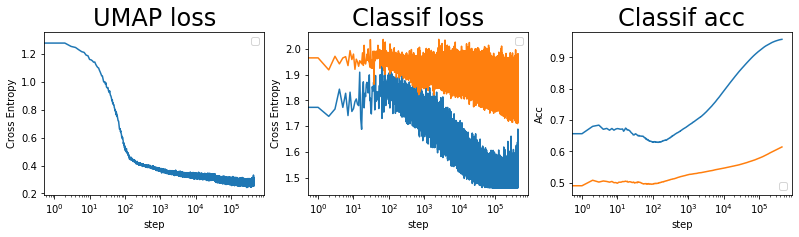

batch: 447000 | train acc: 0.9573 | val acc: 0.614


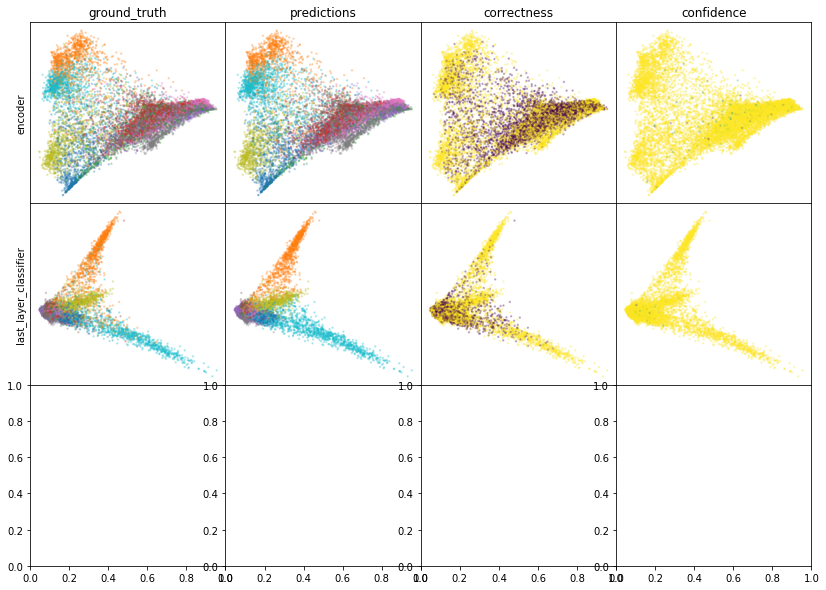

W0808 00:02:50.766280 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:52.448857 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:54.074850 140336071132928 legend.py:1282] No handles with labels found to put in legend.


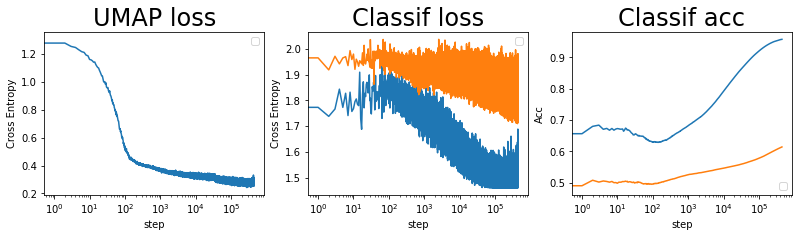

batch: 448000 | train acc: 0.9573 | val acc: 0.614


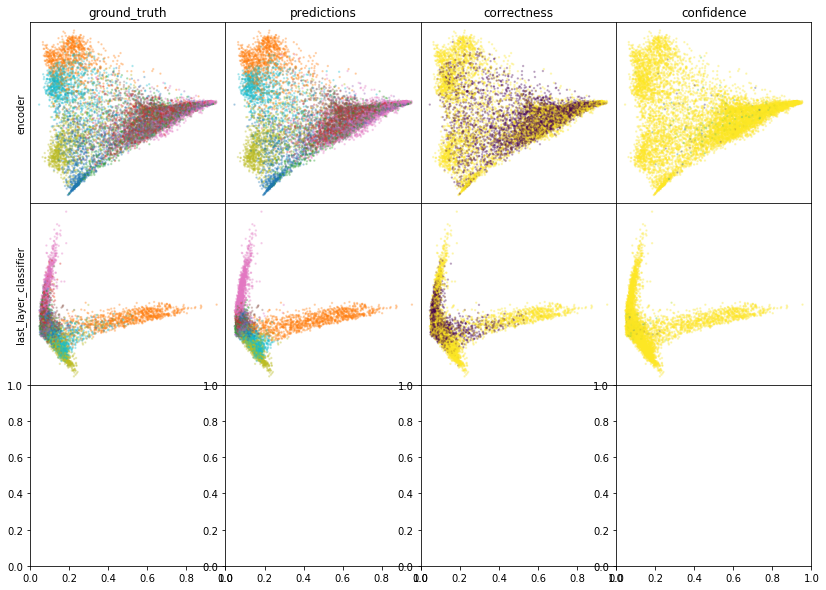

W0808 00:09:56.175247 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:57.832431 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:59.359065 140336071132928 legend.py:1282] No handles with labels found to put in legend.


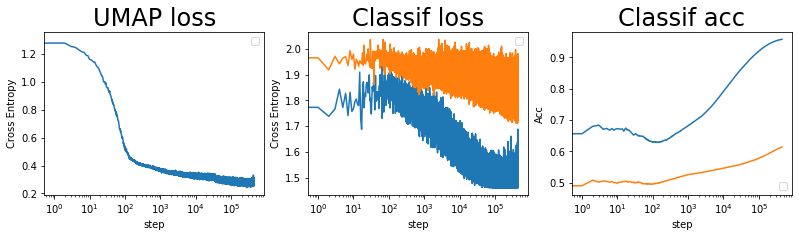

batch: 449000 | train acc: 0.9573 | val acc: 0.6141


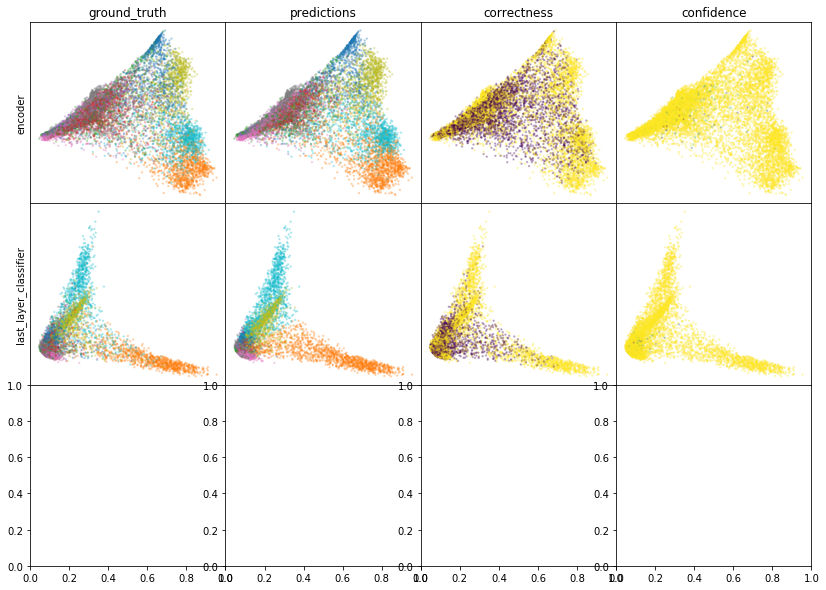

W0808 00:16:36.847990 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:38.494611 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:40.022405 140336071132928 legend.py:1282] No handles with labels found to put in legend.


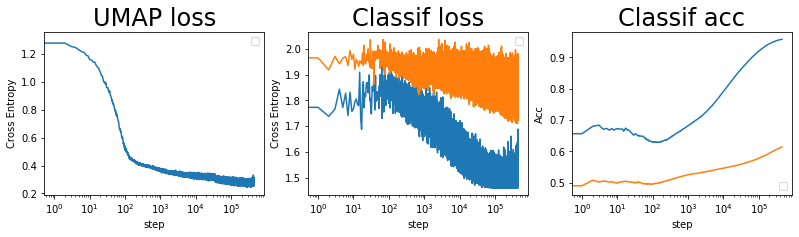

batch: 450000 | train acc: 0.9573 | val acc: 0.6141


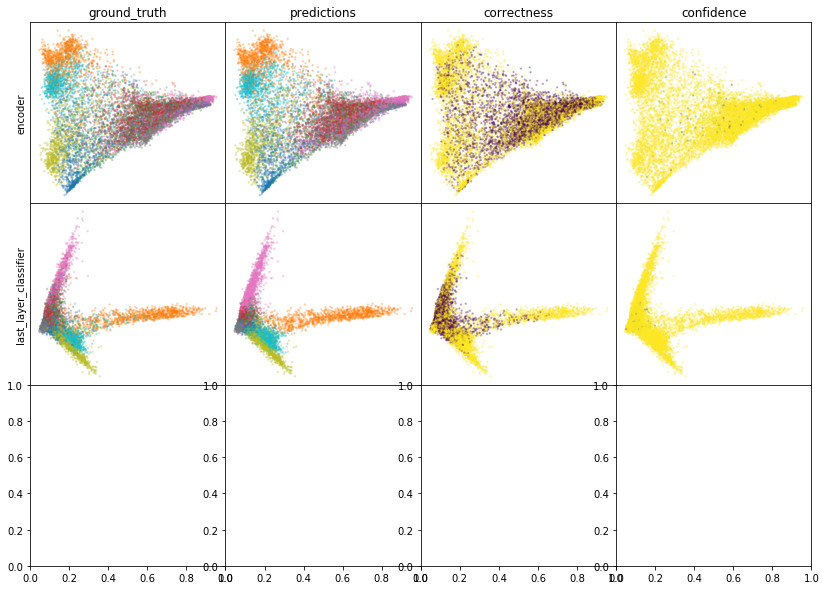

W0808 00:23:52.099409 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:23:53.717720 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:23:55.228735 140336071132928 legend.py:1282] No handles with labels found to put in legend.


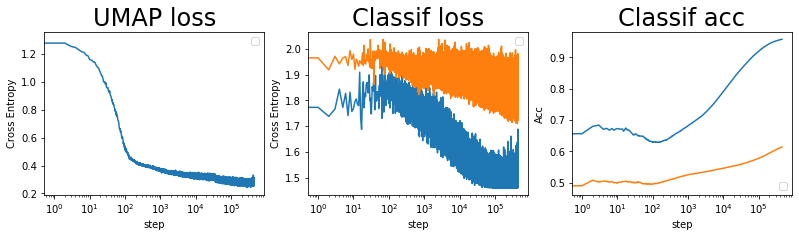

batch: 451000 | train acc: 0.9573 | val acc: 0.6141


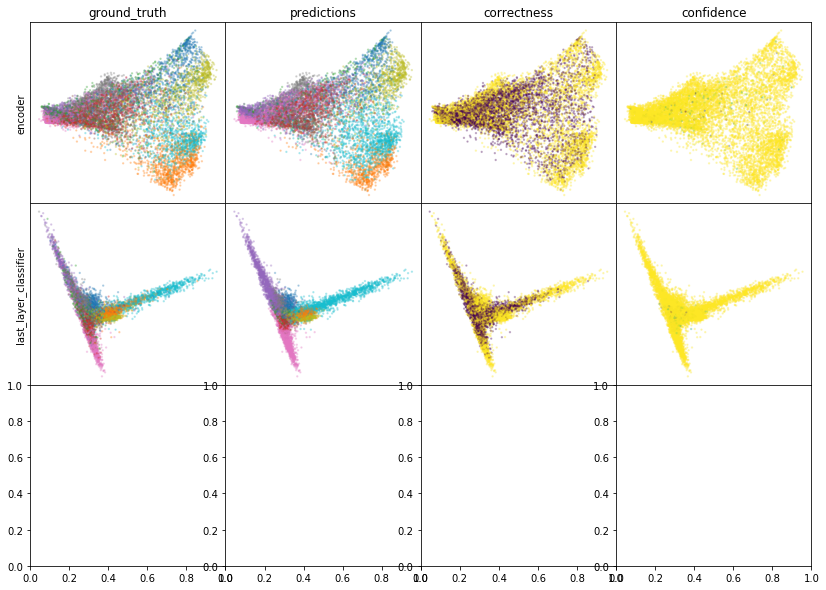

W0808 00:30:33.527096 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:35.156790 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:36.667368 140336071132928 legend.py:1282] No handles with labels found to put in legend.


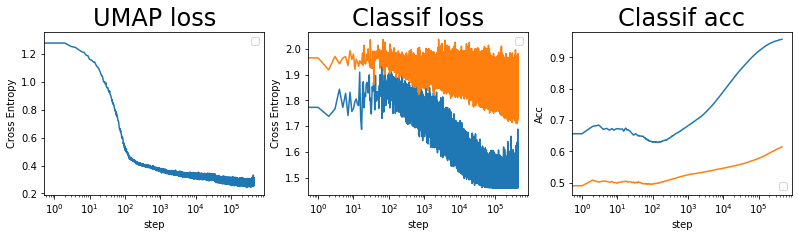

batch: 452000 | train acc: 0.9573 | val acc: 0.6142


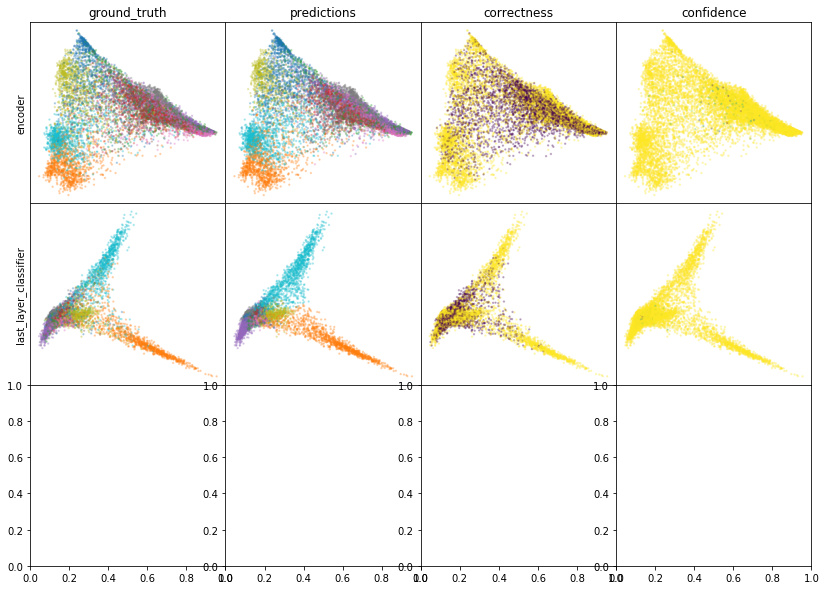

W0808 00:37:55.728577 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:57.364292 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:58.873531 140336071132928 legend.py:1282] No handles with labels found to put in legend.


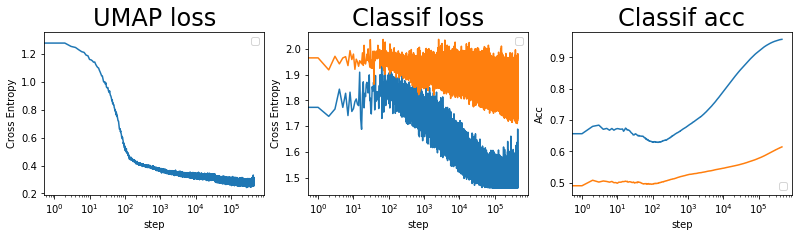

batch: 453000 | train acc: 0.9573 | val acc: 0.6142


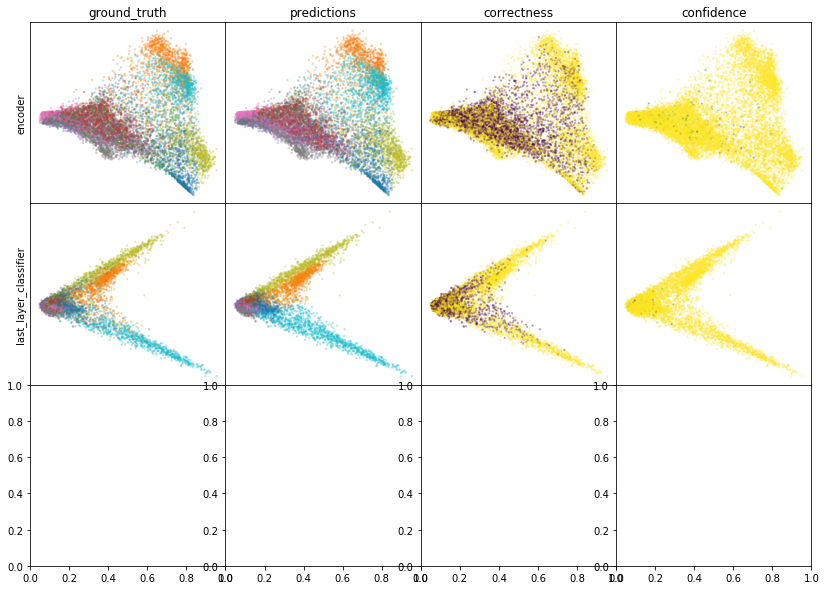

W0808 00:44:34.177444 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:35.840437 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:37.414747 140336071132928 legend.py:1282] No handles with labels found to put in legend.


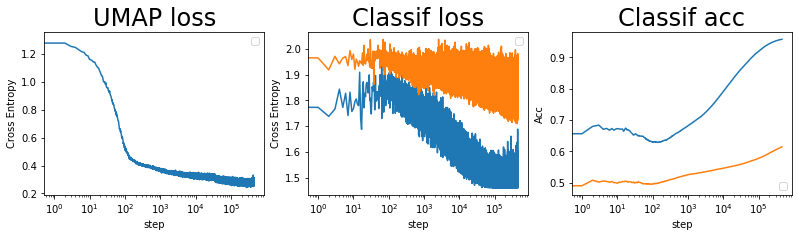

batch: 454000 | train acc: 0.9574 | val acc: 0.6143


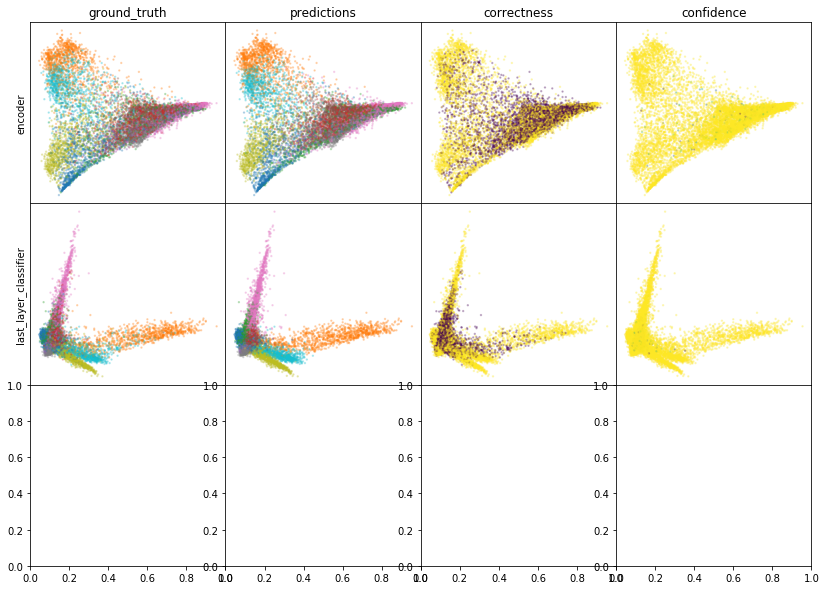

W0808 00:51:31.821954 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:33.473118 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:34.964225 140336071132928 legend.py:1282] No handles with labels found to put in legend.


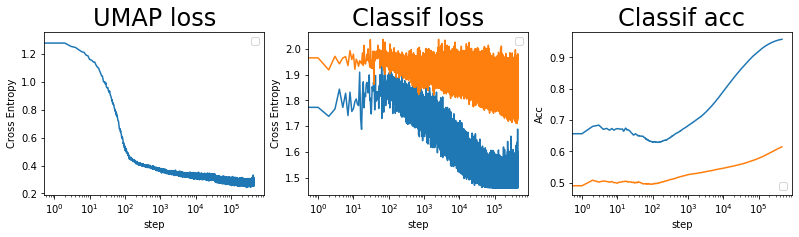

batch: 455000 | train acc: 0.9574 | val acc: 0.6143


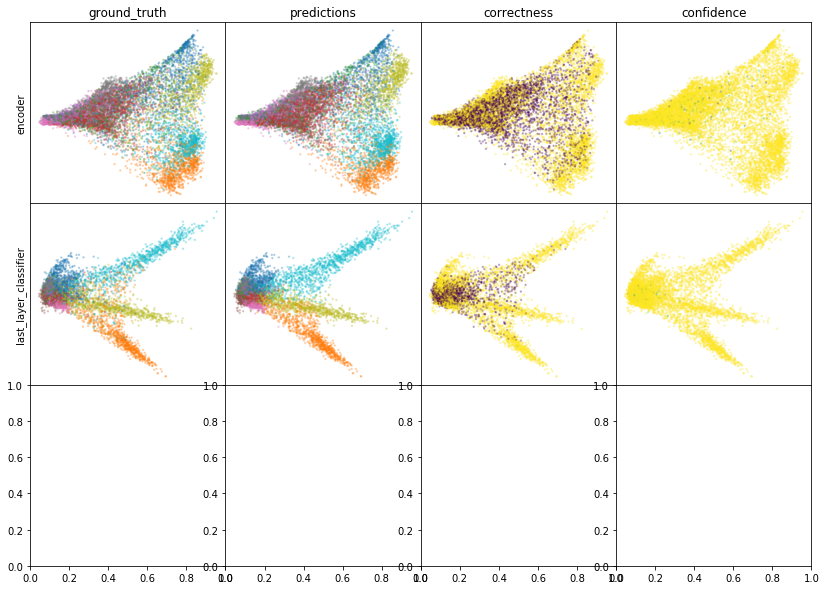

W0808 00:58:13.309636 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:58:14.999444 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 00:58:16.527377 140336071132928 legend.py:1282] No handles with labels found to put in legend.


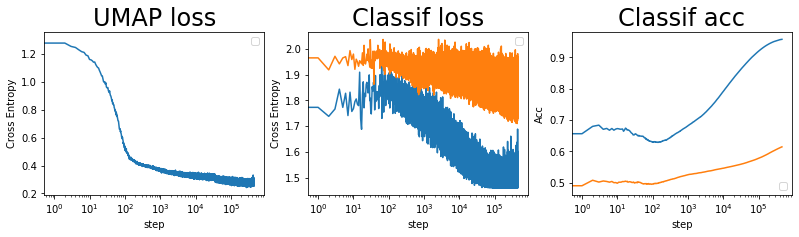

batch: 456000 | train acc: 0.9574 | val acc: 0.6143


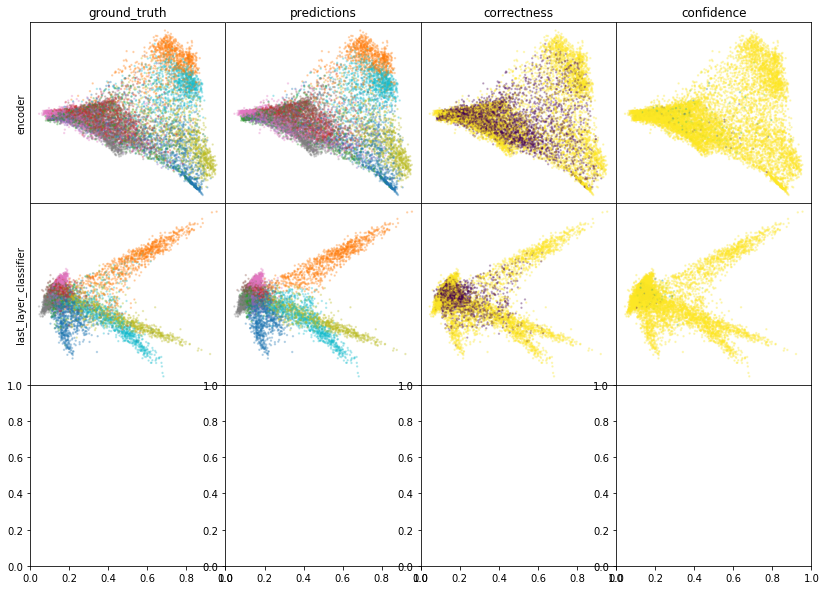

W0808 01:05:15.682253 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:17.331409 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:18.866998 140336071132928 legend.py:1282] No handles with labels found to put in legend.


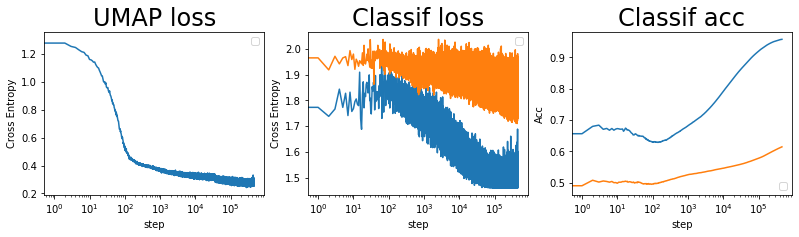

batch: 457000 | train acc: 0.9574 | val acc: 0.6144


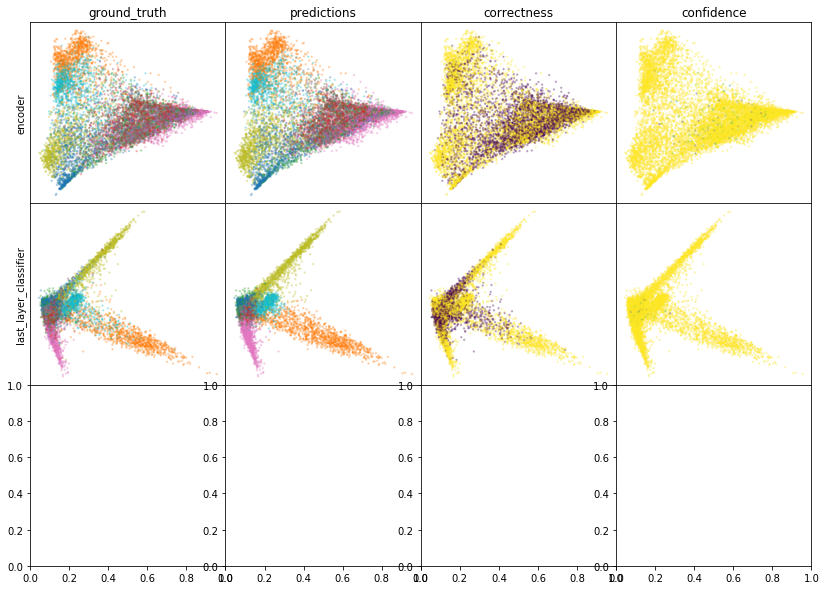

W0808 01:11:55.781332 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:11:57.447702 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:11:58.969109 140336071132928 legend.py:1282] No handles with labels found to put in legend.


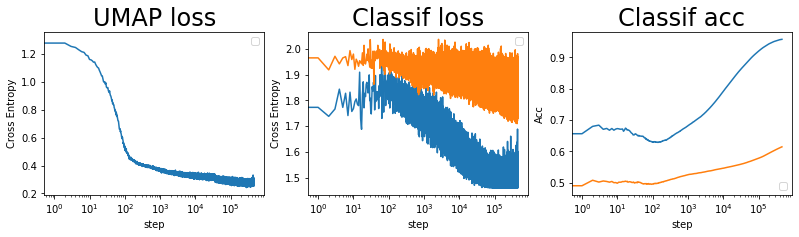

batch: 458000 | train acc: 0.9574 | val acc: 0.6144


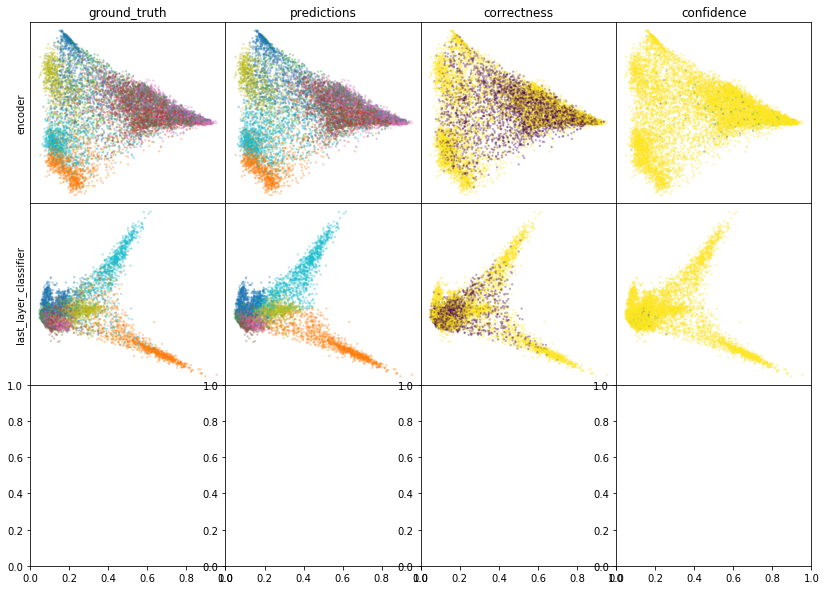

W0808 01:19:21.590804 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:19:23.255879 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:19:24.788789 140336071132928 legend.py:1282] No handles with labels found to put in legend.


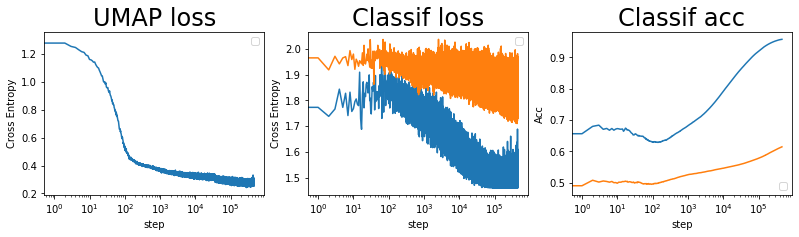

batch: 459000 | train acc: 0.9574 | val acc: 0.6145


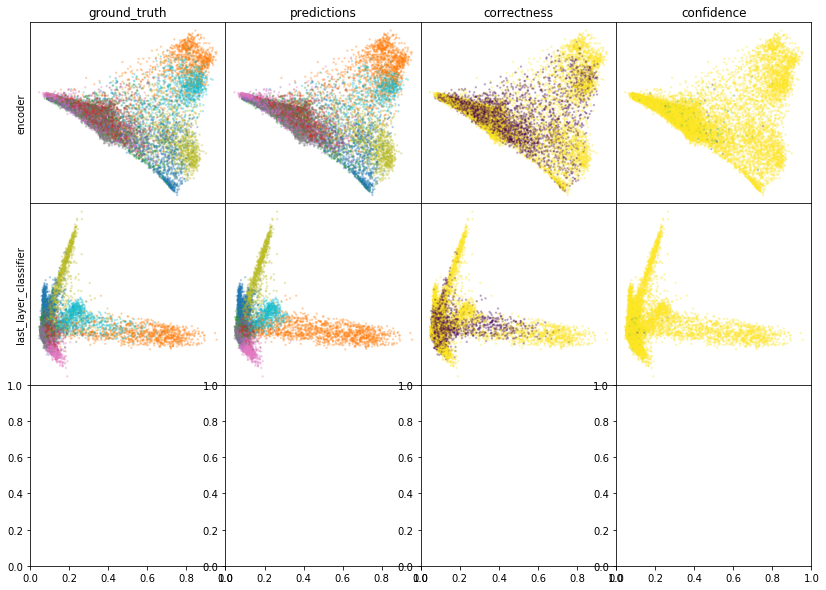

W0808 01:25:59.033900 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:26:00.747814 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:26:02.286395 140336071132928 legend.py:1282] No handles with labels found to put in legend.


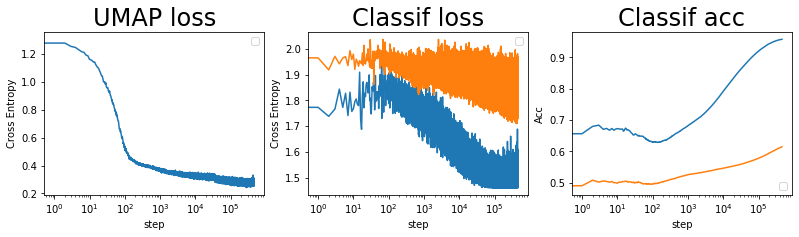

batch: 460000 | train acc: 0.9575 | val acc: 0.6145


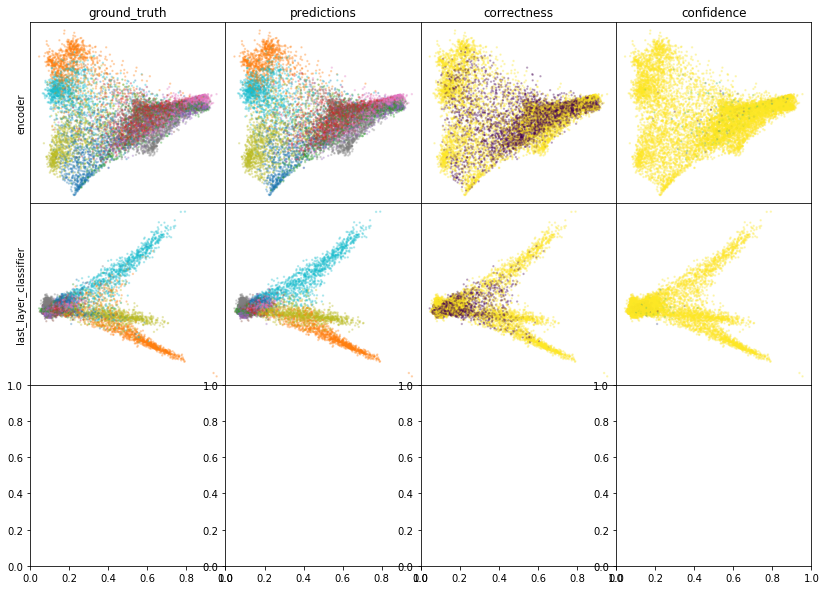

W0808 01:33:28.752258 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:33:30.454968 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:33:32.026219 140336071132928 legend.py:1282] No handles with labels found to put in legend.


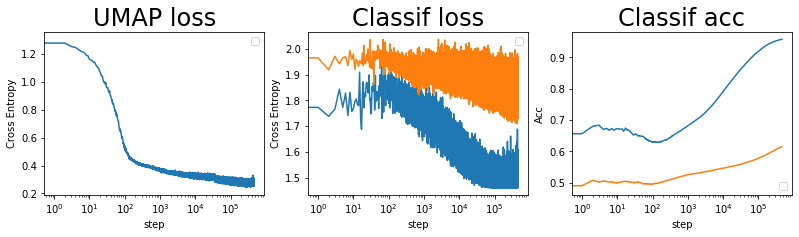

batch: 461000 | train acc: 0.9575 | val acc: 0.6145


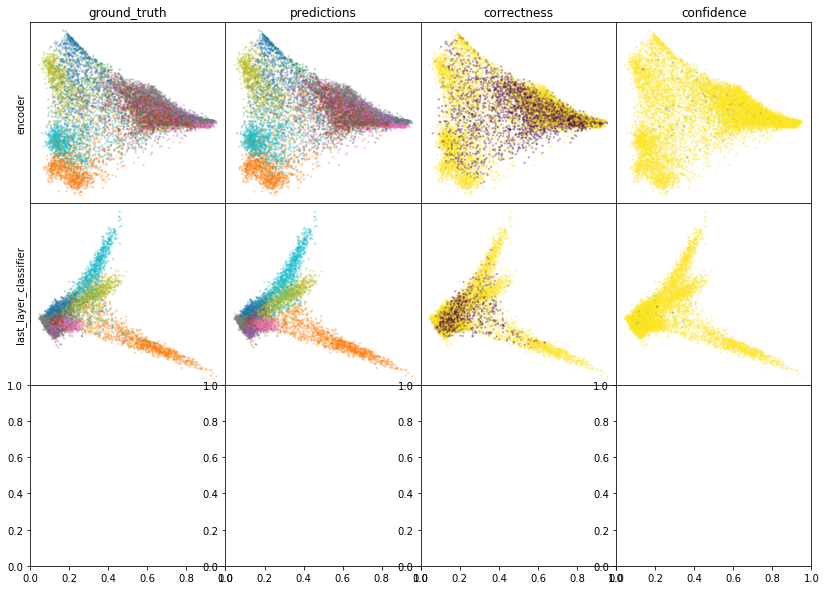

W0808 01:40:06.374262 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:08.044349 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:09.574406 140336071132928 legend.py:1282] No handles with labels found to put in legend.


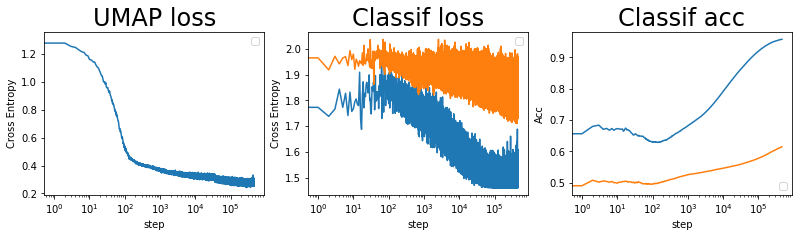

batch: 462000 | train acc: 0.9575 | val acc: 0.6146


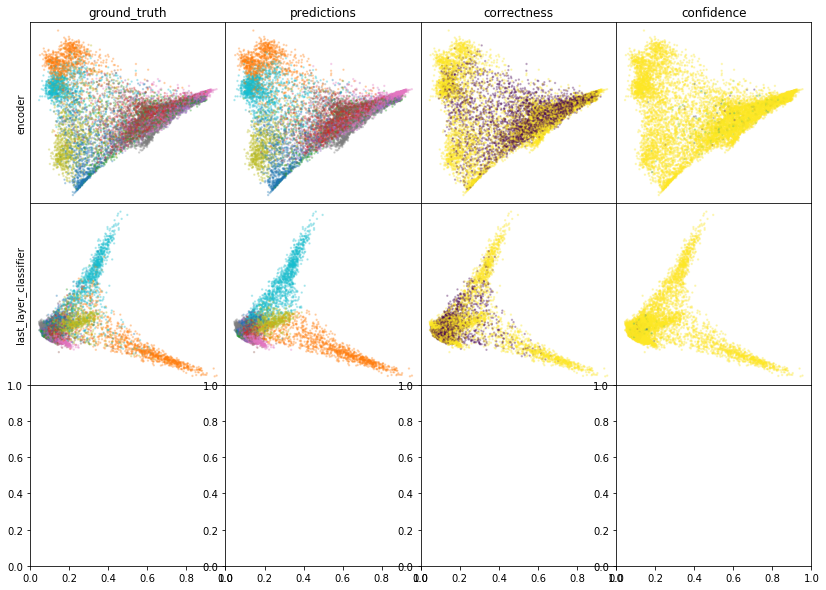

W0808 01:46:54.249337 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:46:55.933827 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:46:57.516227 140336071132928 legend.py:1282] No handles with labels found to put in legend.


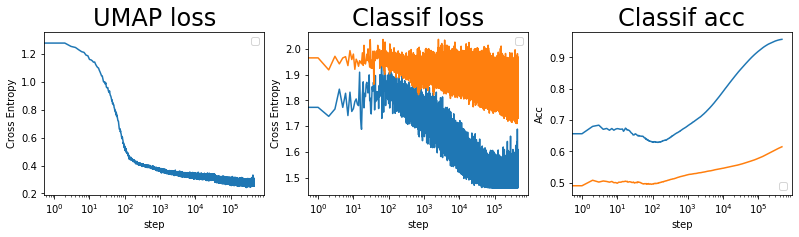

batch: 463000 | train acc: 0.9575 | val acc: 0.6146


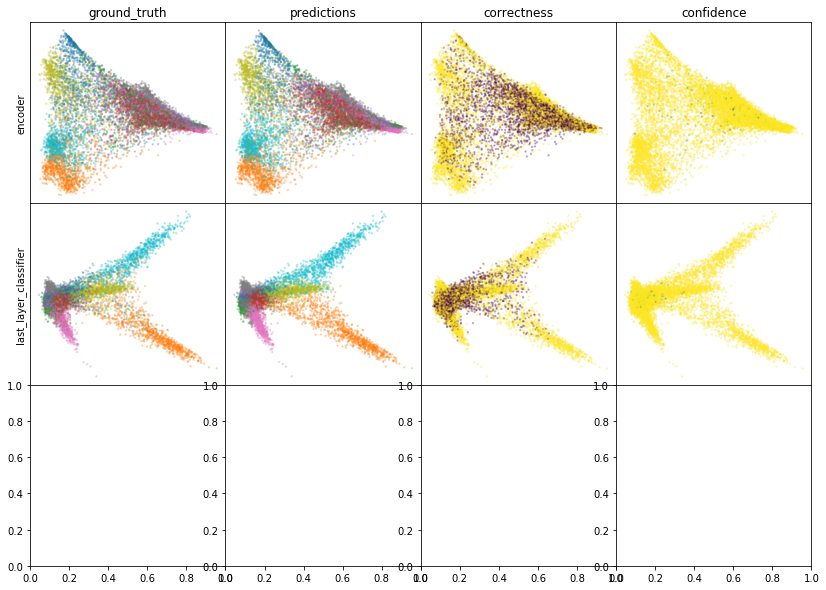

W0808 01:53:34.453221 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:36.129021 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:37.671591 140336071132928 legend.py:1282] No handles with labels found to put in legend.


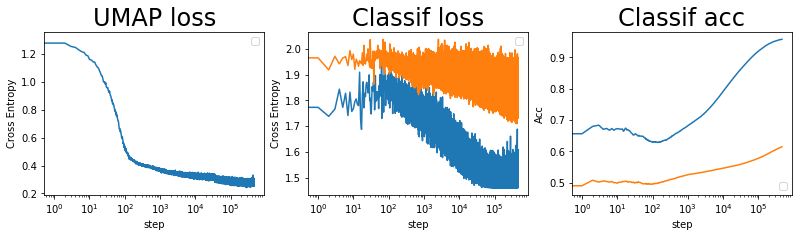

batch: 464000 | train acc: 0.9575 | val acc: 0.6147


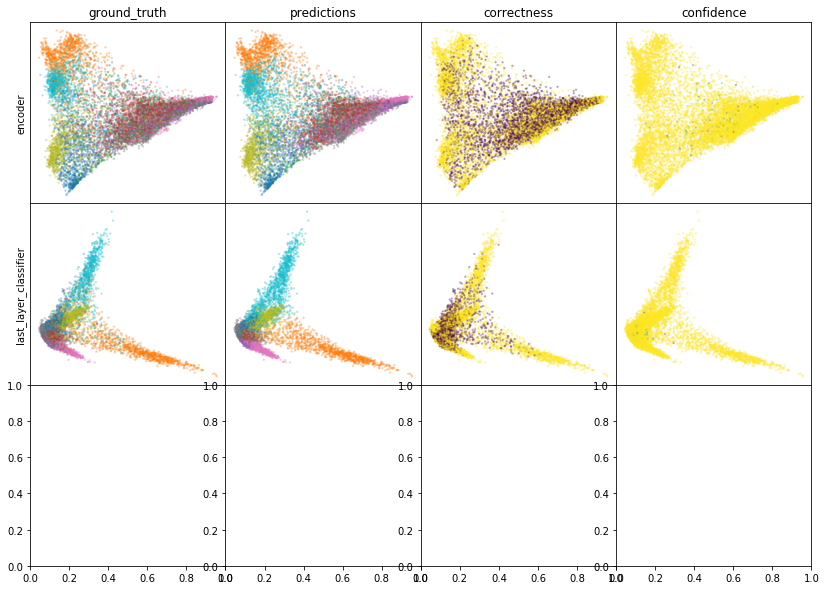

W0808 02:00:29.998933 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:00:31.689162 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:00:33.253307 140336071132928 legend.py:1282] No handles with labels found to put in legend.


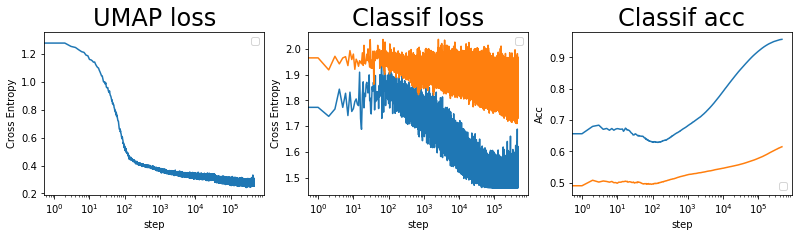

batch: 465000 | train acc: 0.9576 | val acc: 0.6147


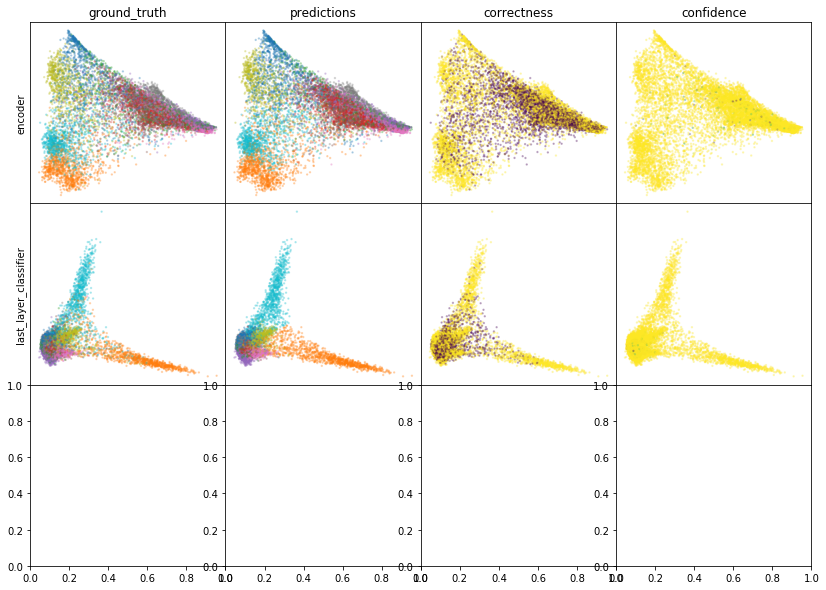

W0808 02:07:13.437780 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:15.157319 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:16.719038 140336071132928 legend.py:1282] No handles with labels found to put in legend.


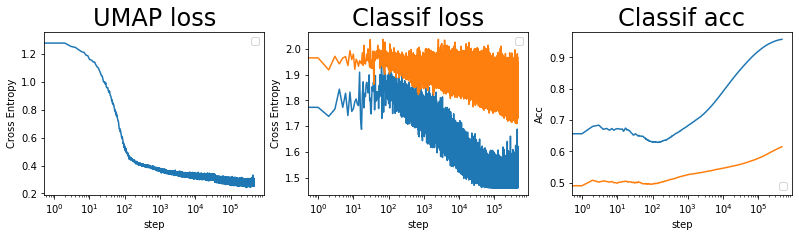

batch: 466000 | train acc: 0.9576 | val acc: 0.6148


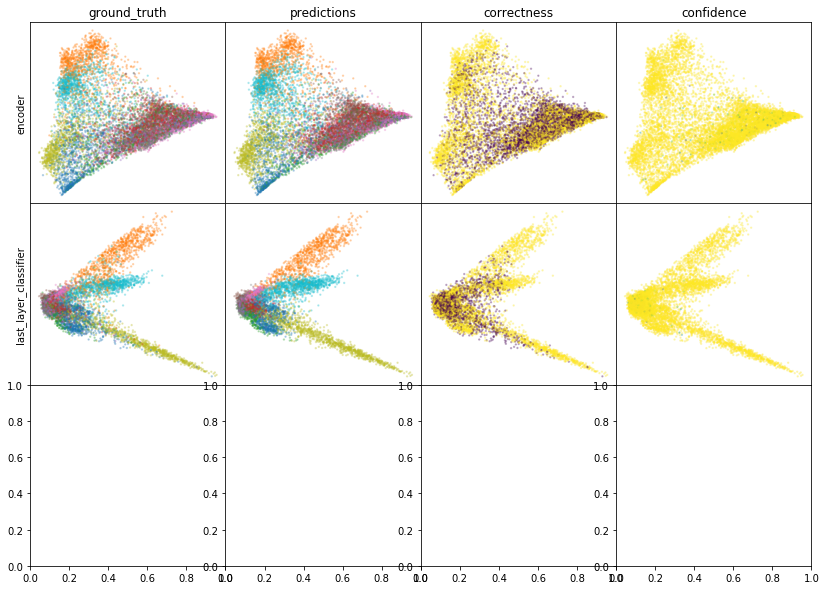

W0808 02:14:07.257477 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:08.956972 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:10.499747 140336071132928 legend.py:1282] No handles with labels found to put in legend.


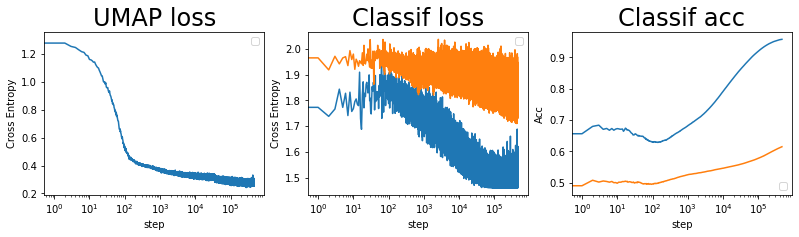

batch: 467000 | train acc: 0.9576 | val acc: 0.6148


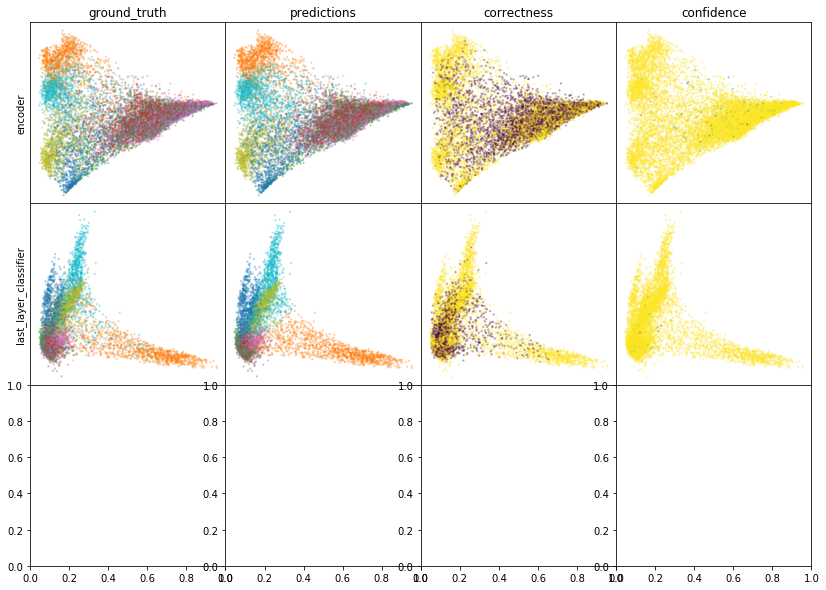

W0808 02:20:50.074521 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:20:51.824594 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:20:53.454712 140336071132928 legend.py:1282] No handles with labels found to put in legend.


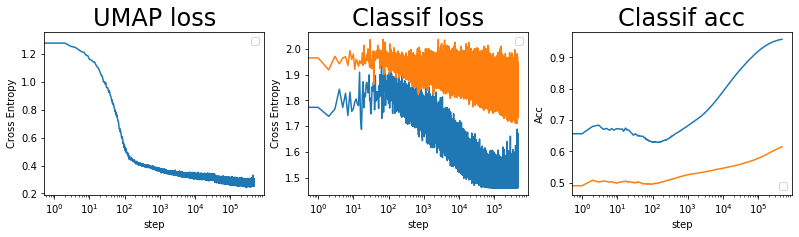

batch: 468000 | train acc: 0.9576 | val acc: 0.6148


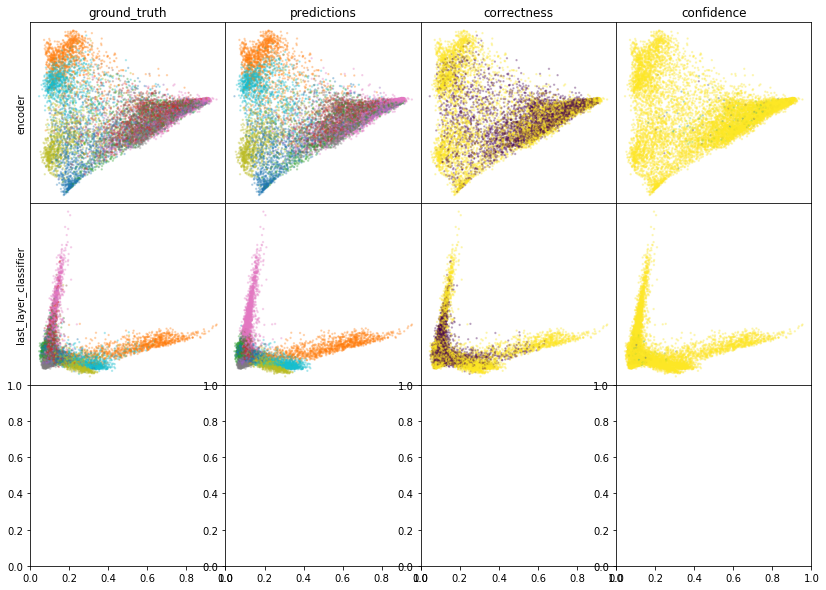

W0808 02:27:54.579825 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:27:56.271279 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:27:57.826617 140336071132928 legend.py:1282] No handles with labels found to put in legend.


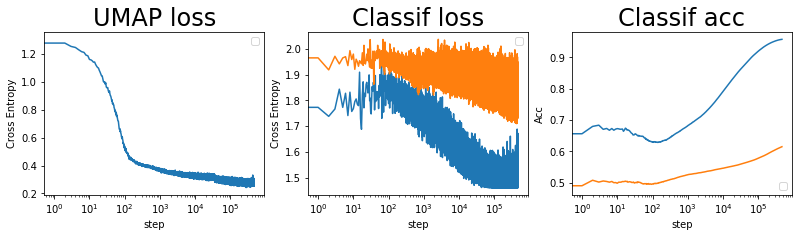

batch: 469000 | train acc: 0.9576 | val acc: 0.6149


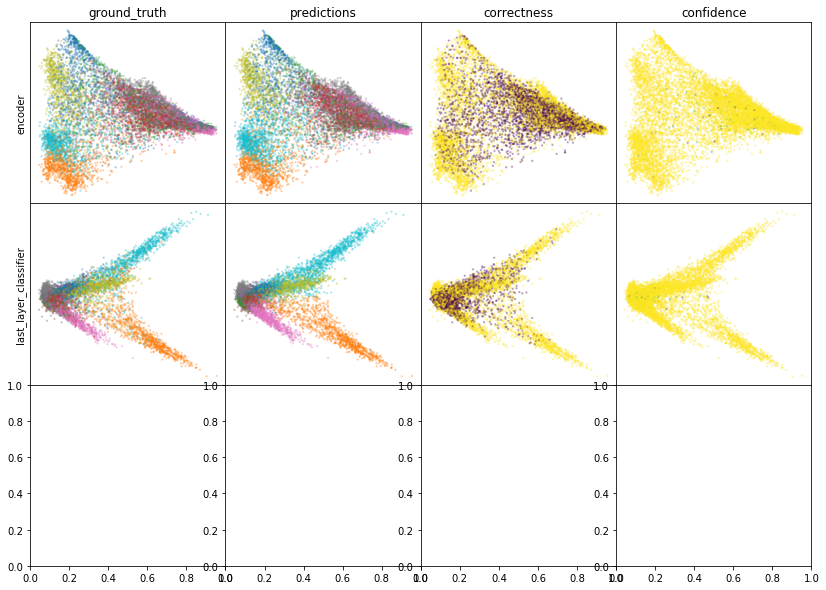

W0808 02:34:40.993089 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:34:42.791229 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:34:44.416748 140336071132928 legend.py:1282] No handles with labels found to put in legend.


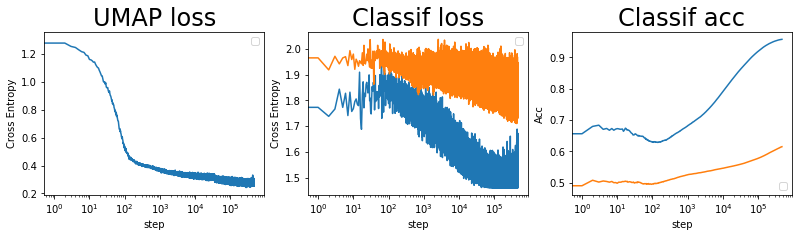

batch: 470000 | train acc: 0.9576 | val acc: 0.6149


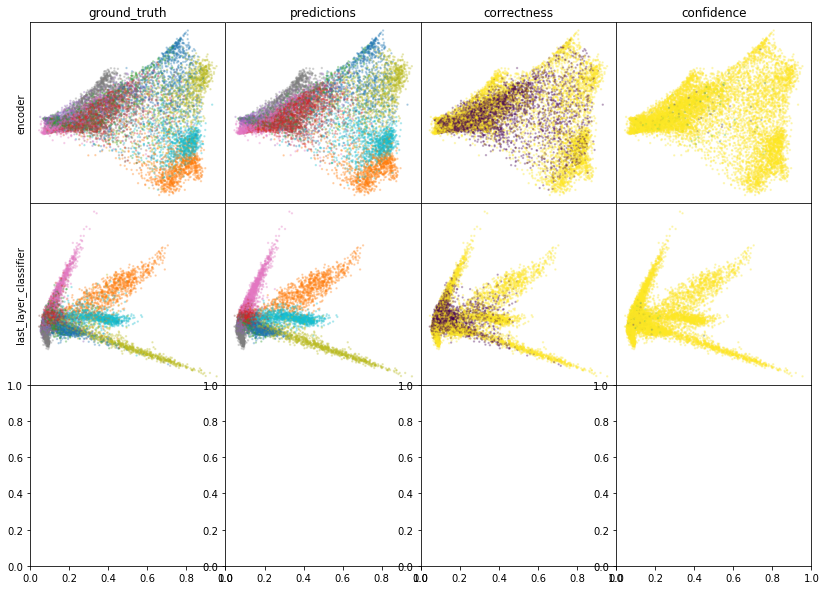

W0808 02:42:41.504184 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:42:43.222905 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:42:44.812203 140336071132928 legend.py:1282] No handles with labels found to put in legend.


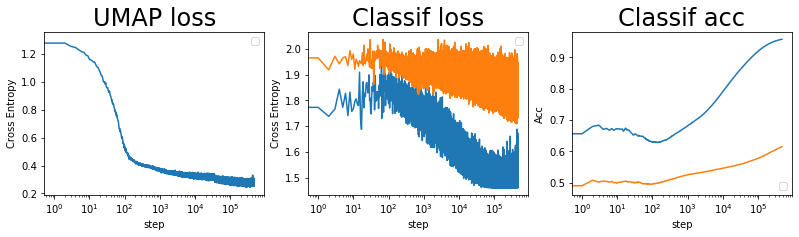

batch: 471000 | train acc: 0.9576 | val acc: 0.6149


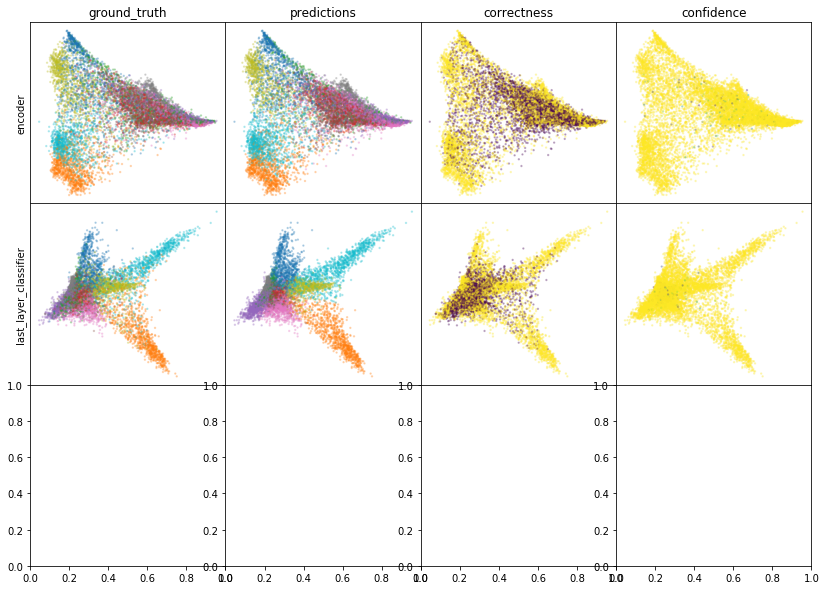

W0808 02:49:26.010225 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:49:27.738990 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:49:29.332916 140336071132928 legend.py:1282] No handles with labels found to put in legend.


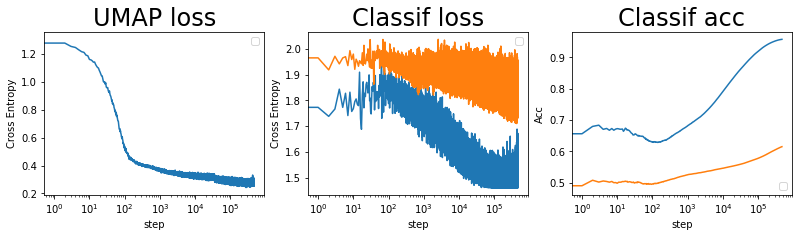

batch: 472000 | train acc: 0.9577 | val acc: 0.615


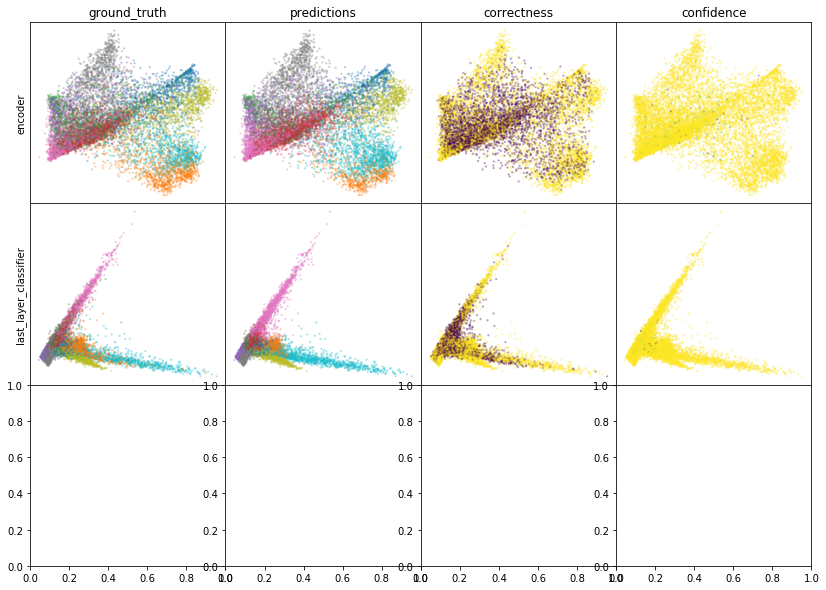

W0808 02:56:21.708996 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:56:23.488058 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 02:56:25.111257 140336071132928 legend.py:1282] No handles with labels found to put in legend.


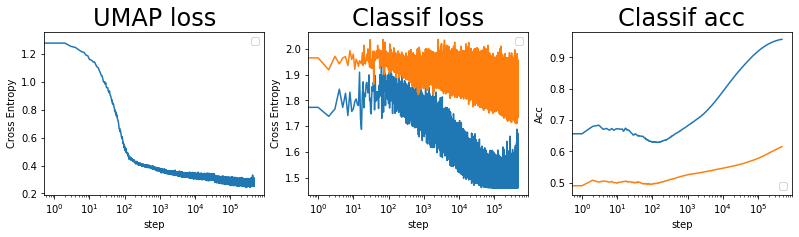

batch: 473000 | train acc: 0.9577 | val acc: 0.615


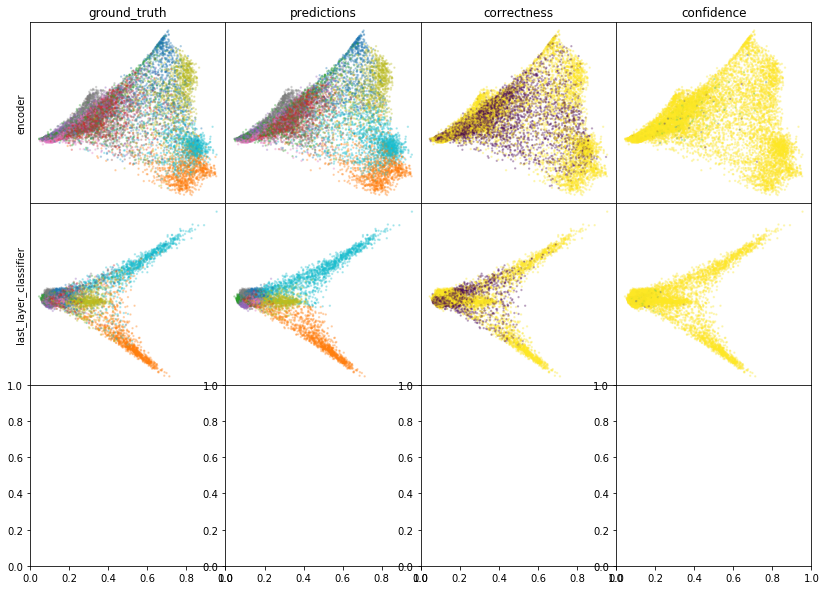

W0808 03:02:54.208099 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:55.934006 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:57.543638 140336071132928 legend.py:1282] No handles with labels found to put in legend.


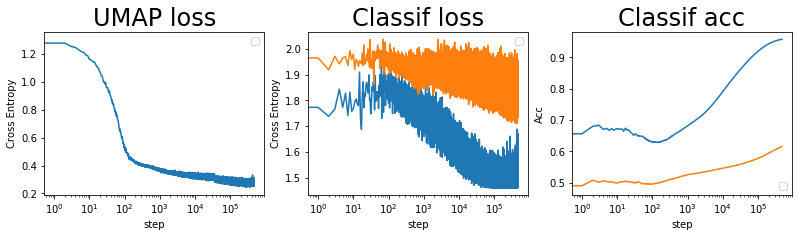

batch: 474000 | train acc: 0.9577 | val acc: 0.6151


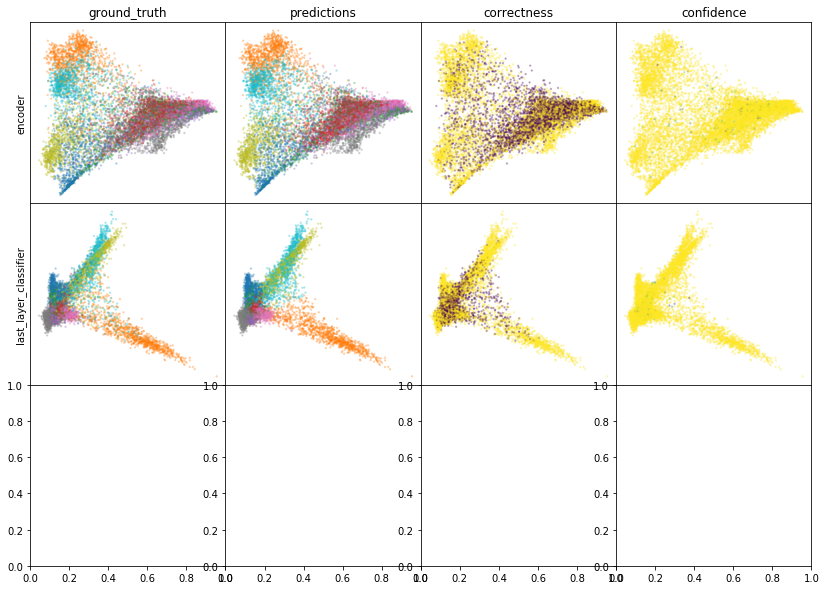

W0808 03:10:26.692721 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:10:28.556712 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:10:30.199455 140336071132928 legend.py:1282] No handles with labels found to put in legend.


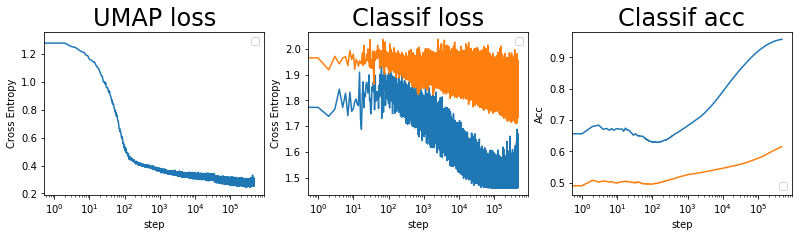

batch: 475000 | train acc: 0.9577 | val acc: 0.6151


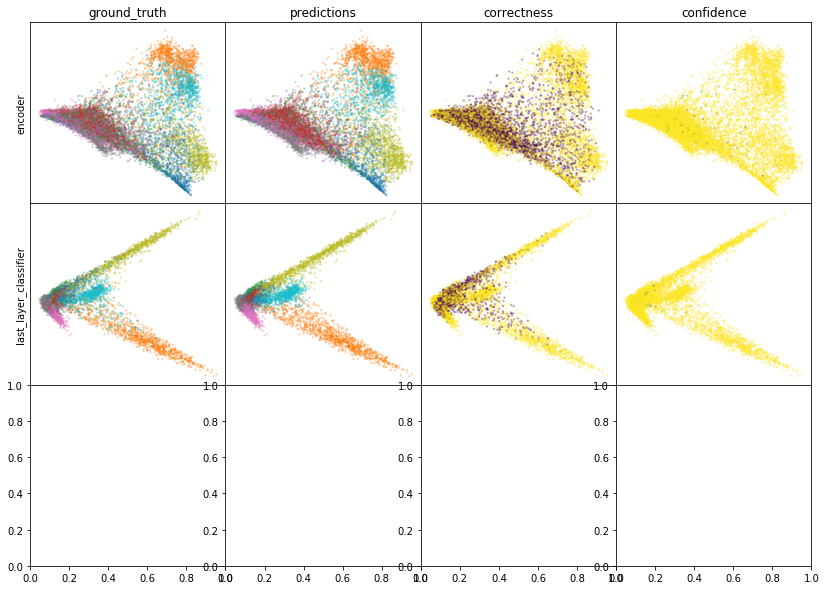

W0808 03:17:05.342772 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:17:07.057299 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:17:08.651590 140336071132928 legend.py:1282] No handles with labels found to put in legend.


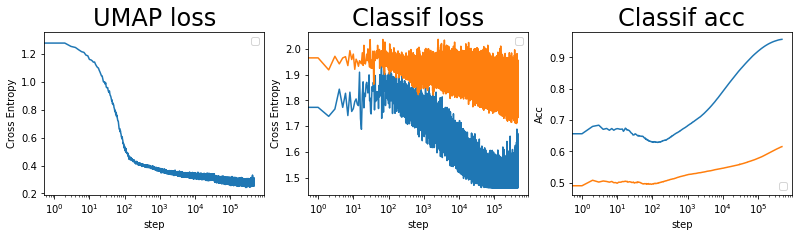

batch: 476000 | train acc: 0.9577 | val acc: 0.6151


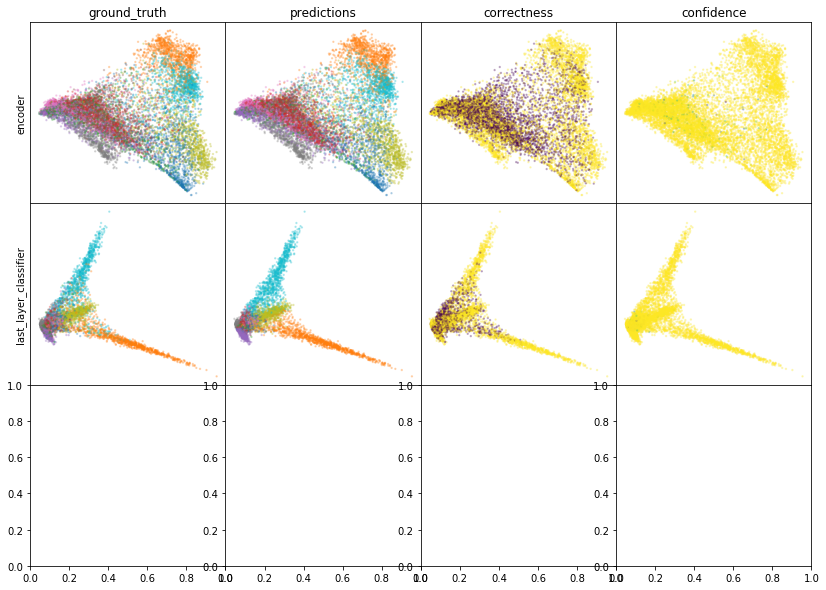

W0808 03:24:05.759919 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:24:07.537863 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:24:09.185937 140336071132928 legend.py:1282] No handles with labels found to put in legend.


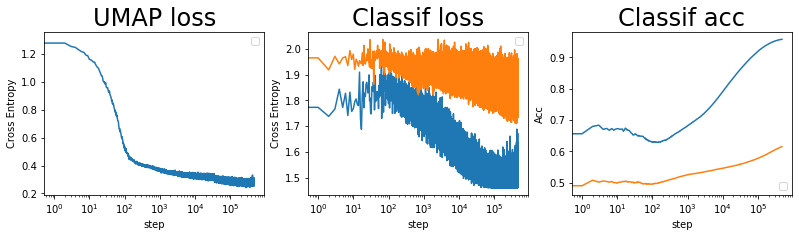

batch: 477000 | train acc: 0.9577 | val acc: 0.6152


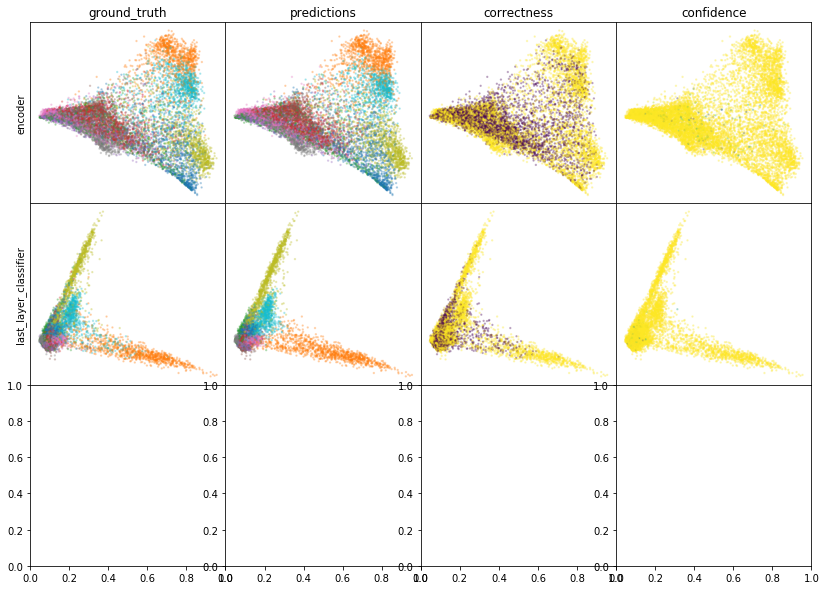

W0808 03:30:37.838713 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:30:39.621112 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:30:41.291637 140336071132928 legend.py:1282] No handles with labels found to put in legend.


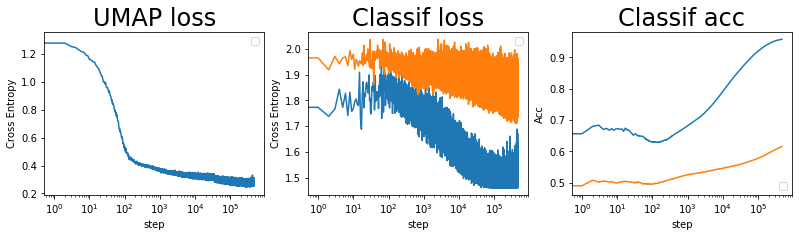

batch: 478000 | train acc: 0.9577 | val acc: 0.6152


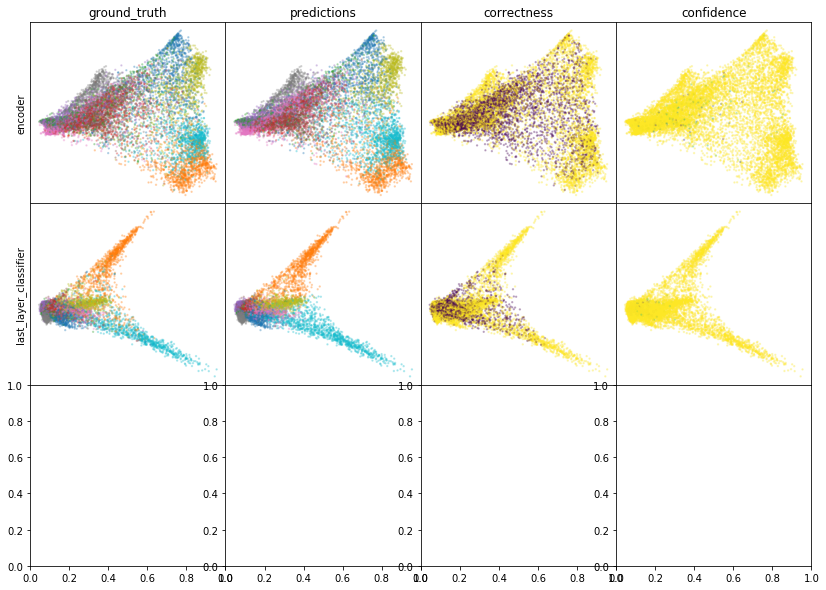

W0808 03:37:49.724312 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:37:51.414072 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:37:52.964679 140336071132928 legend.py:1282] No handles with labels found to put in legend.


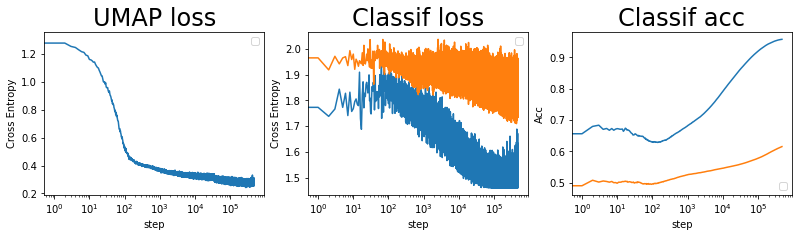

batch: 479000 | train acc: 0.9577 | val acc: 0.6153


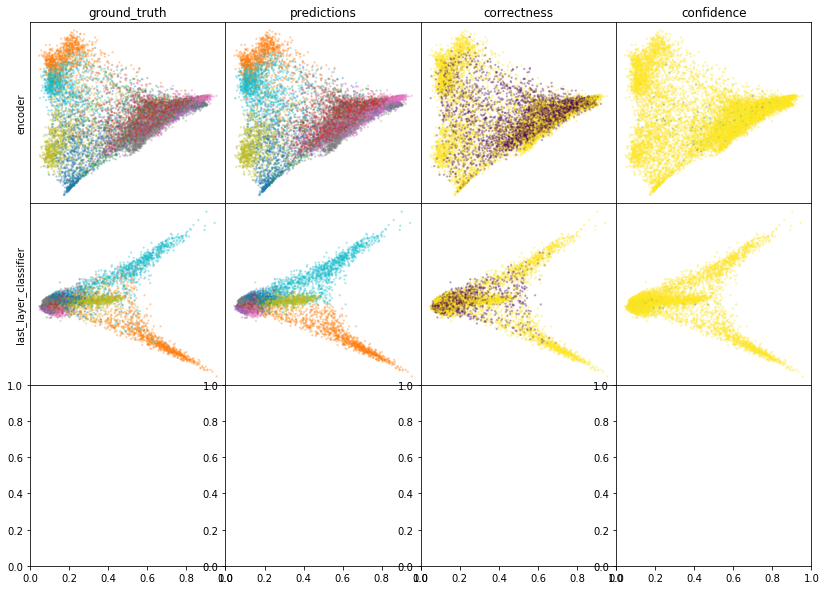

W0808 03:44:40.980818 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:44:42.747114 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:44:44.378599 140336071132928 legend.py:1282] No handles with labels found to put in legend.


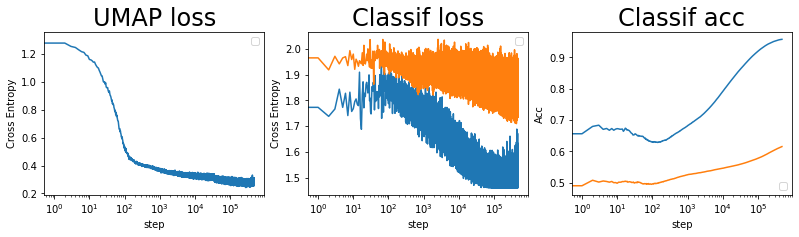

batch: 480000 | train acc: 0.9577 | val acc: 0.6153


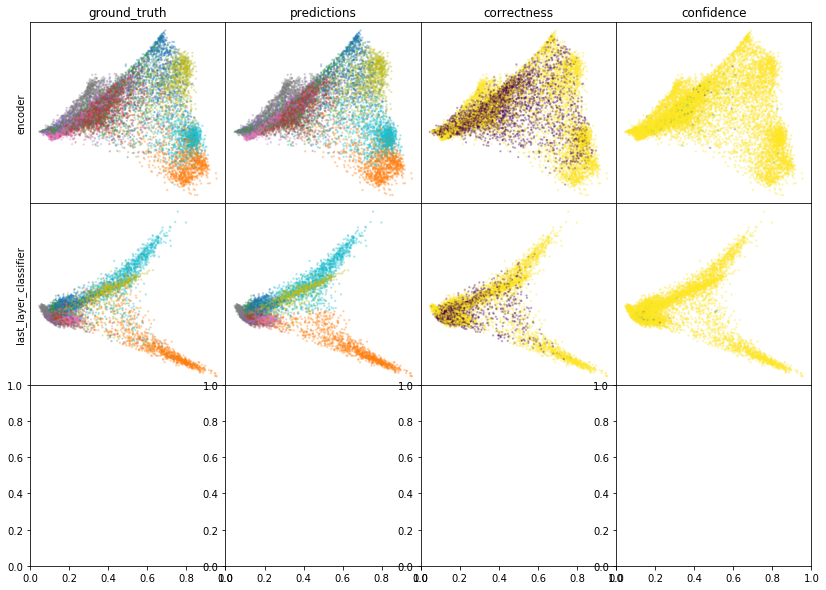

W0808 03:52:11.823871 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:52:13.544551 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:52:15.137919 140336071132928 legend.py:1282] No handles with labels found to put in legend.


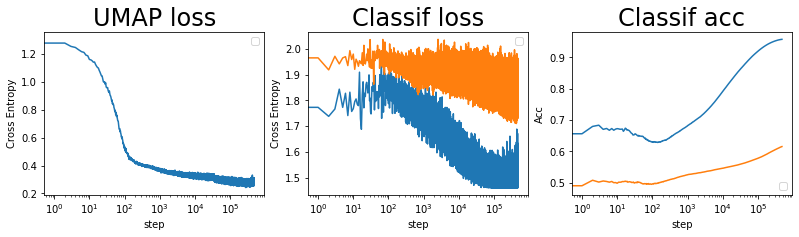

batch: 481000 | train acc: 0.9578 | val acc: 0.6153


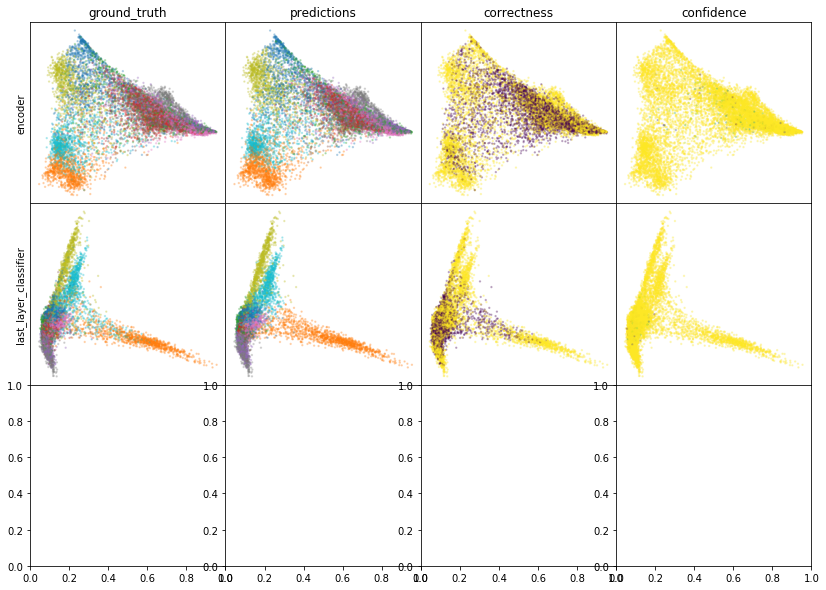

W0808 03:58:46.750812 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:58:48.482417 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 03:58:50.088484 140336071132928 legend.py:1282] No handles with labels found to put in legend.


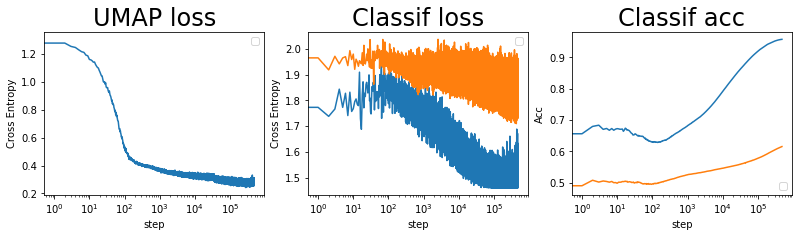

batch: 482000 | train acc: 0.9578 | val acc: 0.6154


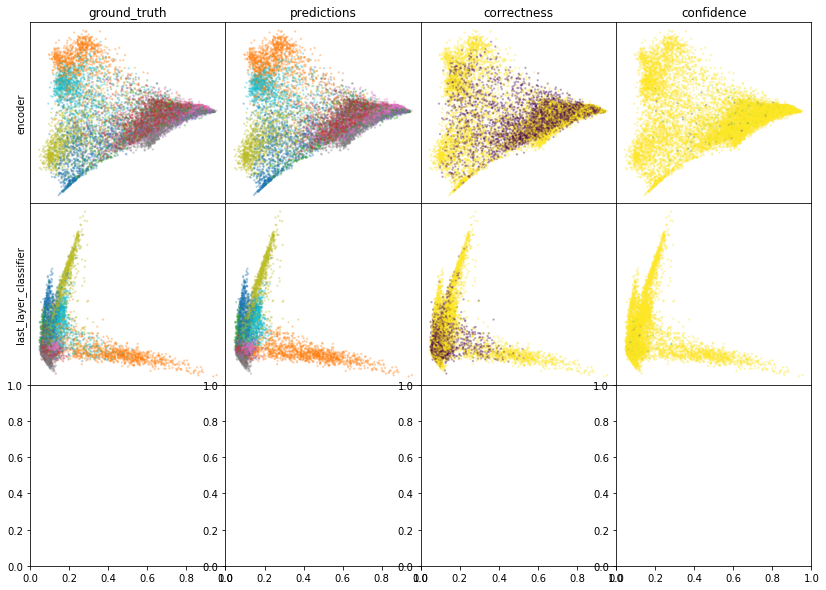

W0808 04:06:05.657656 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:07.496090 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:09.182980 140336071132928 legend.py:1282] No handles with labels found to put in legend.


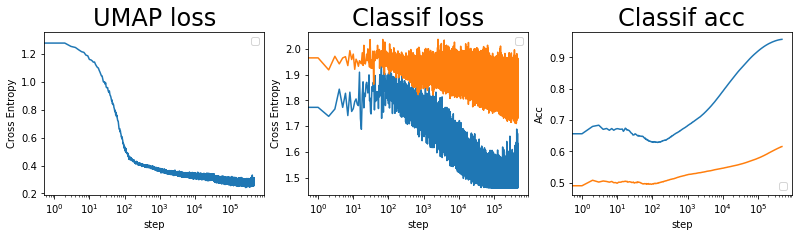

batch: 483000 | train acc: 0.9578 | val acc: 0.6154


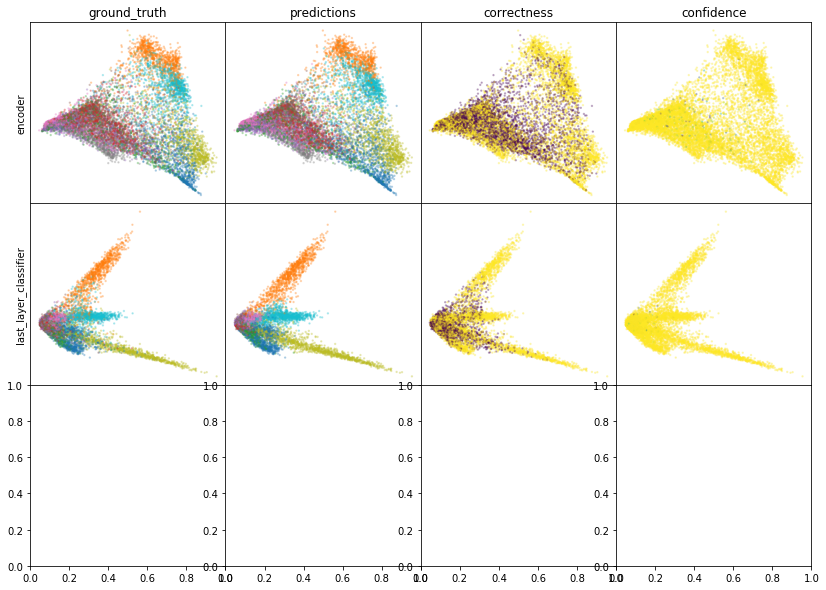

W0808 04:12:35.211030 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:12:36.946406 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:12:38.535492 140336071132928 legend.py:1282] No handles with labels found to put in legend.


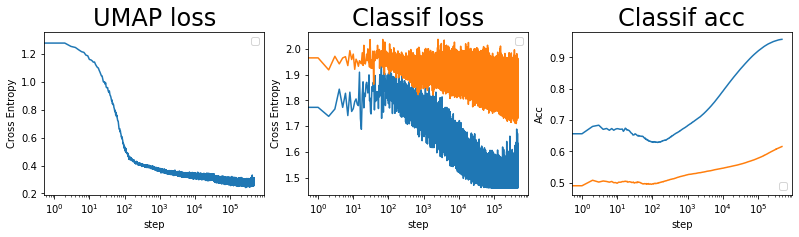

batch: 484000 | train acc: 0.9578 | val acc: 0.6154


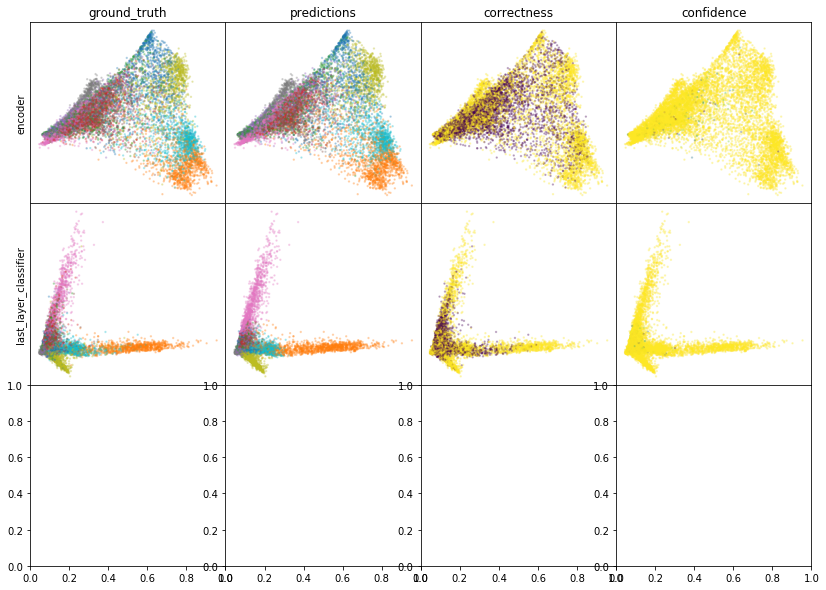

W0808 04:19:50.426021 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:19:52.197590 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:19:53.818648 140336071132928 legend.py:1282] No handles with labels found to put in legend.


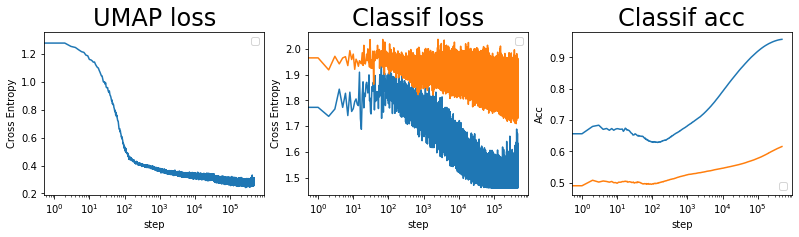

batch: 485000 | train acc: 0.9578 | val acc: 0.6155


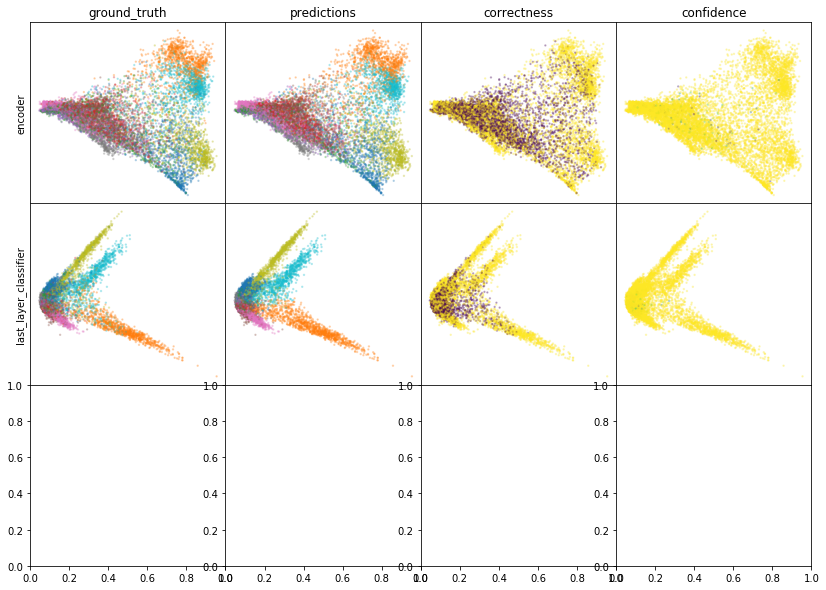

W0808 04:26:20.056169 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:21.786548 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:23.378800 140336071132928 legend.py:1282] No handles with labels found to put in legend.


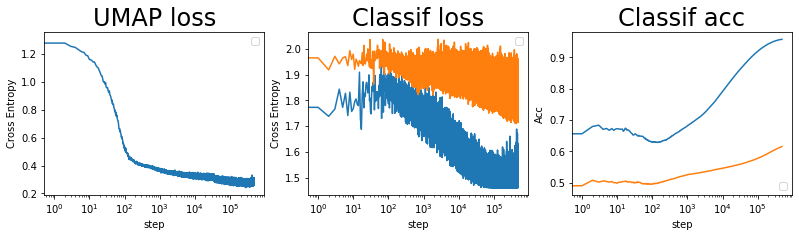

batch: 486000 | train acc: 0.9578 | val acc: 0.6155


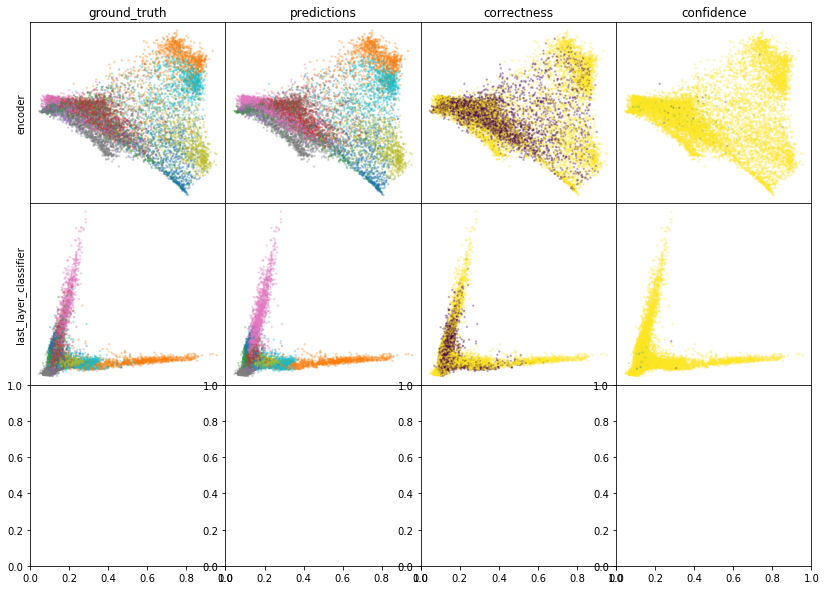

W0808 04:33:28.277450 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:33:30.055698 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:33:31.678699 140336071132928 legend.py:1282] No handles with labels found to put in legend.


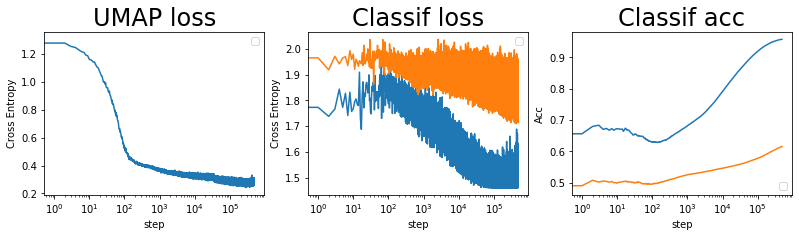

batch: 487000 | train acc: 0.9578 | val acc: 0.6156


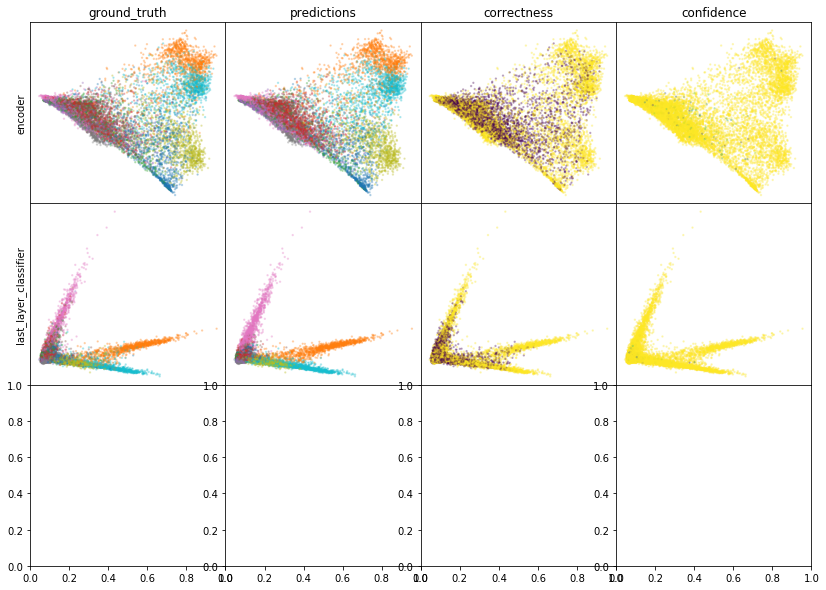

W0808 04:40:08.851086 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:10.642639 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:12.319485 140336071132928 legend.py:1282] No handles with labels found to put in legend.


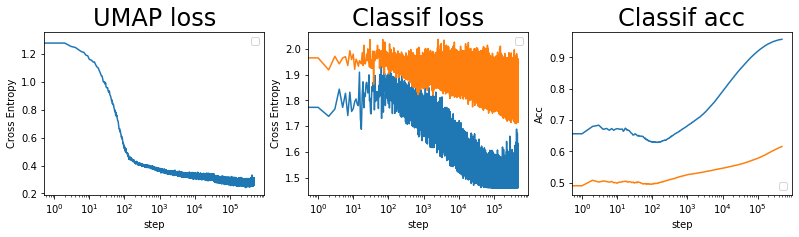

batch: 488000 | train acc: 0.9578 | val acc: 0.6156


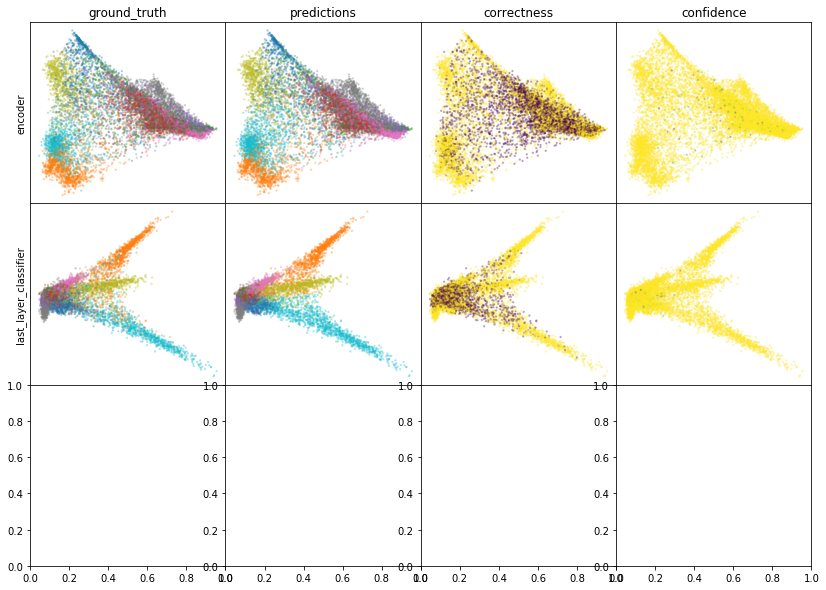

W0808 04:47:13.001176 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:47:14.733854 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:47:16.347447 140336071132928 legend.py:1282] No handles with labels found to put in legend.


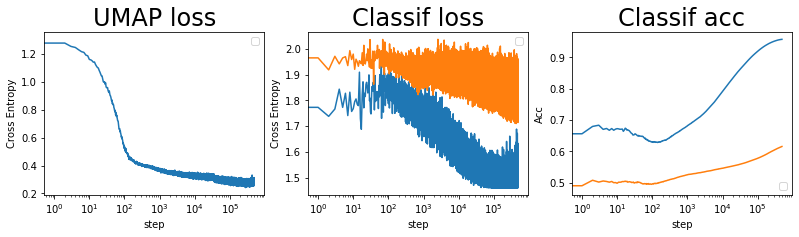

batch: 489000 | train acc: 0.9579 | val acc: 0.6157


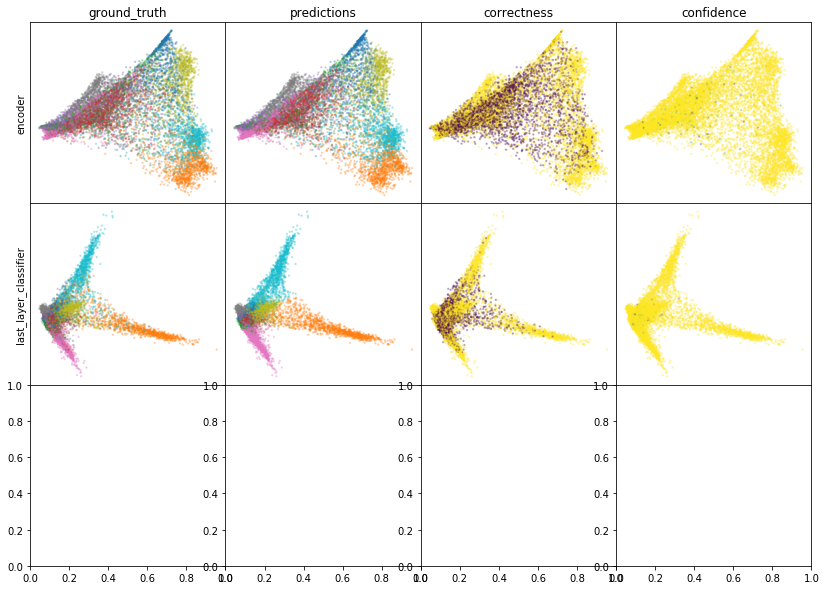

W0808 04:53:54.909139 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:53:56.687725 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 04:53:58.365055 140336071132928 legend.py:1282] No handles with labels found to put in legend.


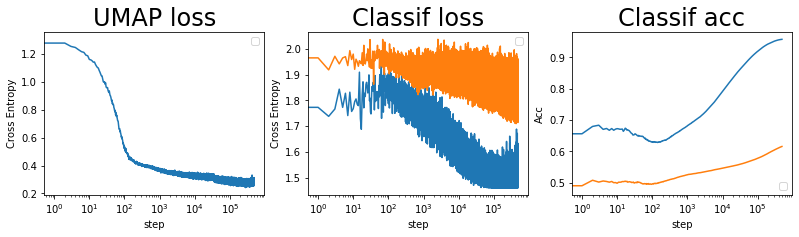

batch: 490000 | train acc: 0.9579 | val acc: 0.6157


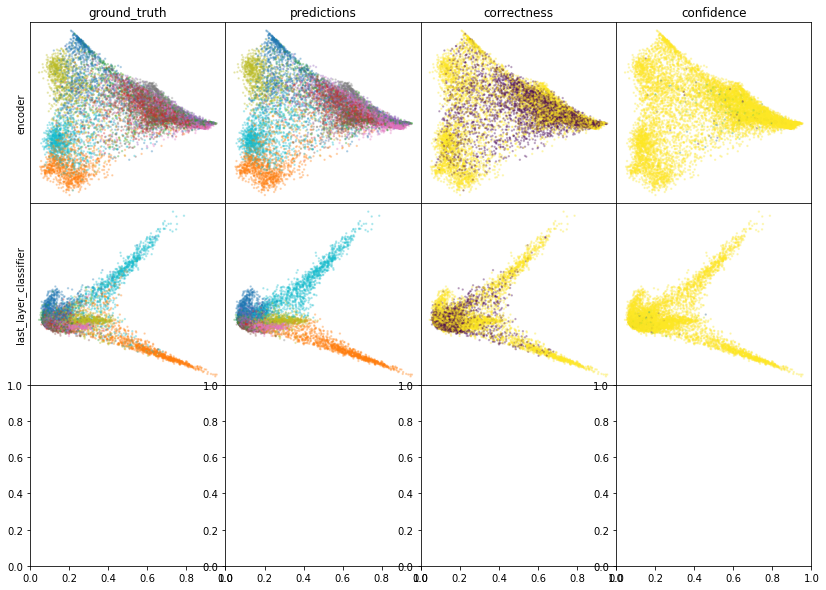

W0808 05:01:05.418344 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:01:07.185670 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:01:08.821435 140336071132928 legend.py:1282] No handles with labels found to put in legend.


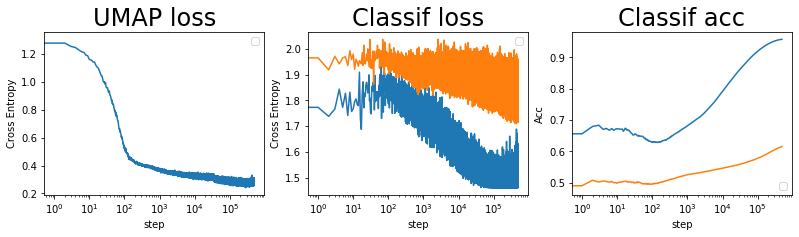

batch: 491000 | train acc: 0.9579 | val acc: 0.6157


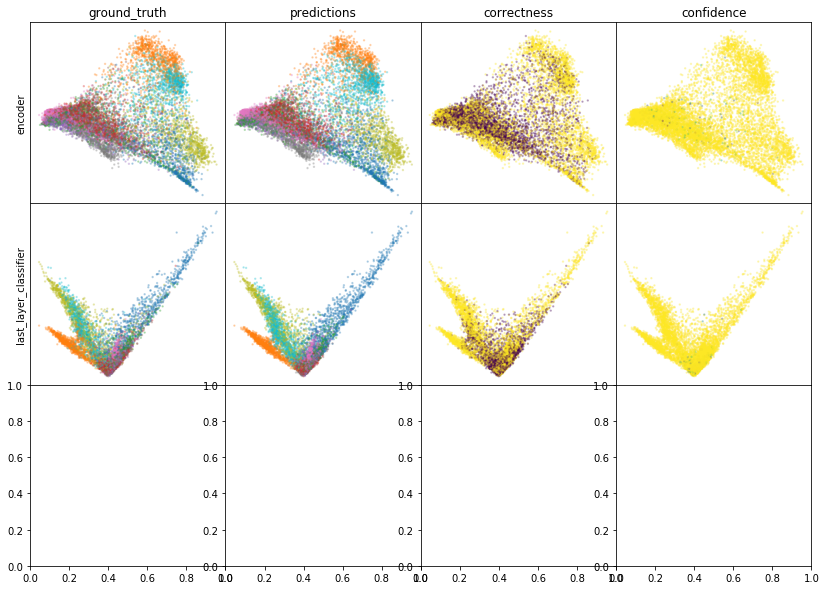

W0808 05:08:13.049357 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:08:14.823646 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:08:16.489162 140336071132928 legend.py:1282] No handles with labels found to put in legend.


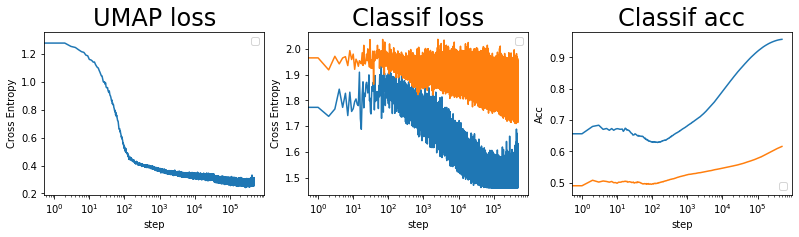

batch: 492000 | train acc: 0.9579 | val acc: 0.6158


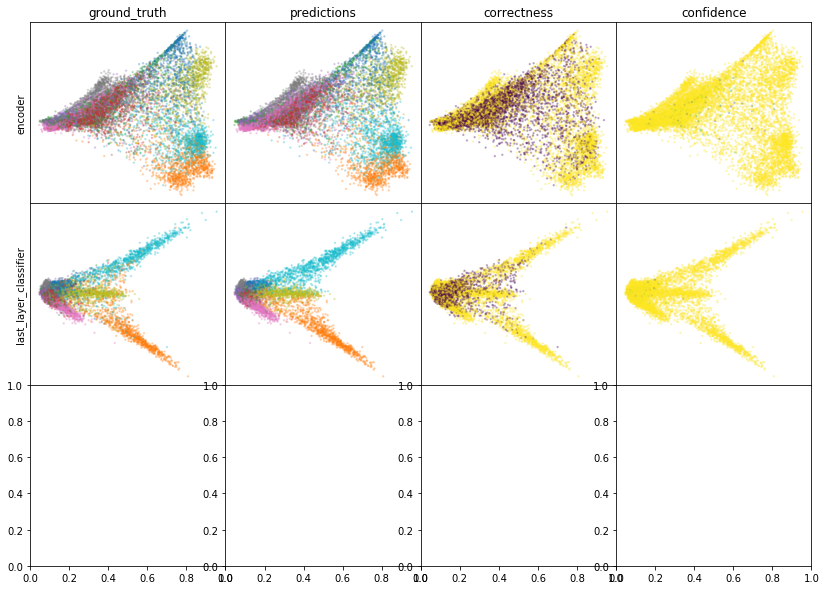

W0808 05:14:58.056108 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:14:59.869826 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:15:01.496762 140336071132928 legend.py:1282] No handles with labels found to put in legend.


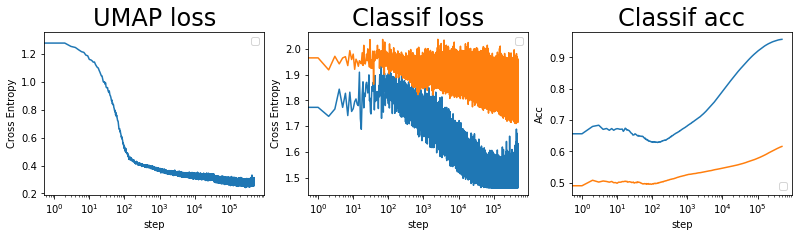

batch: 493000 | train acc: 0.9579 | val acc: 0.6158


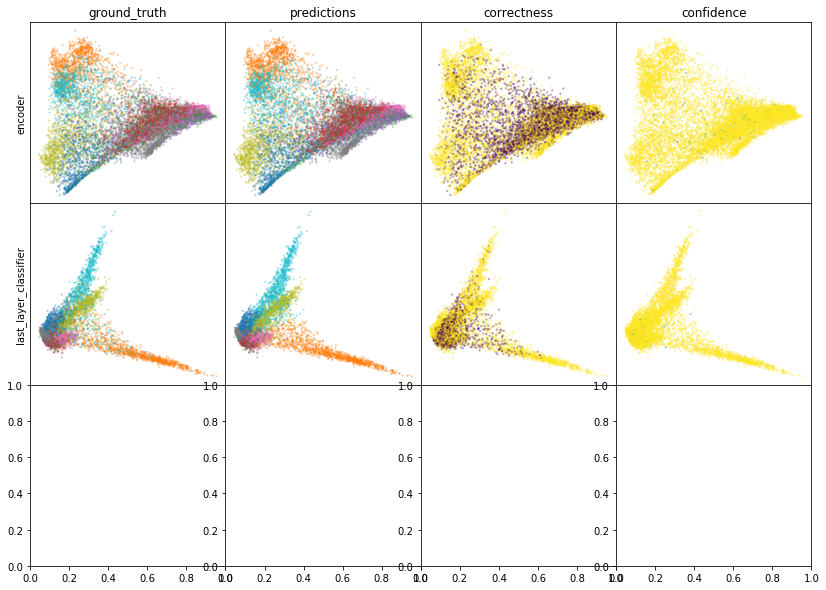

W0808 05:22:00.836640 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:22:02.664674 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:22:04.324757 140336071132928 legend.py:1282] No handles with labels found to put in legend.


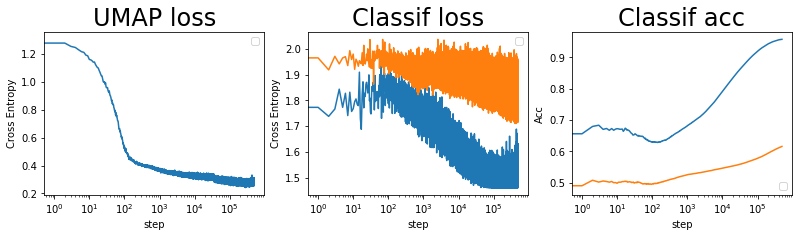

batch: 494000 | train acc: 0.9579 | val acc: 0.6158


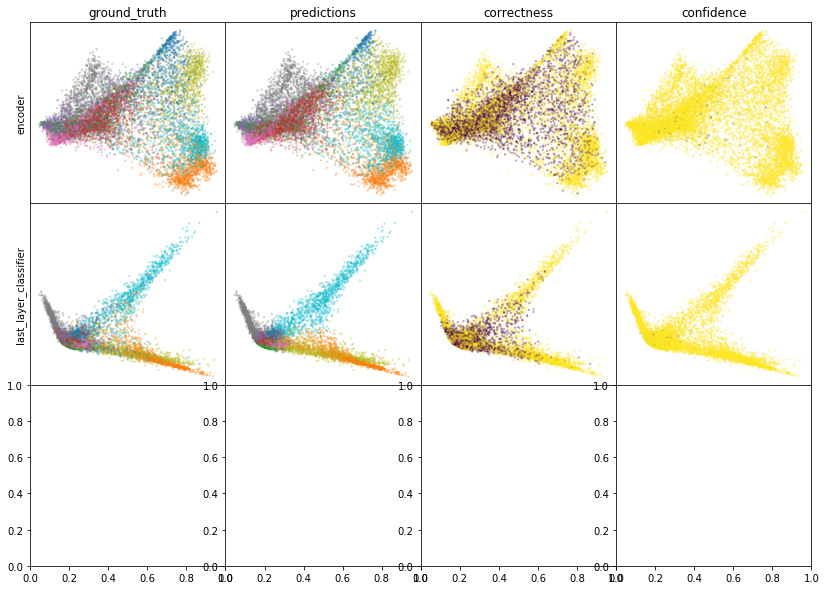

W0808 05:28:59.493022 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:29:01.236288 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:29:02.857543 140336071132928 legend.py:1282] No handles with labels found to put in legend.


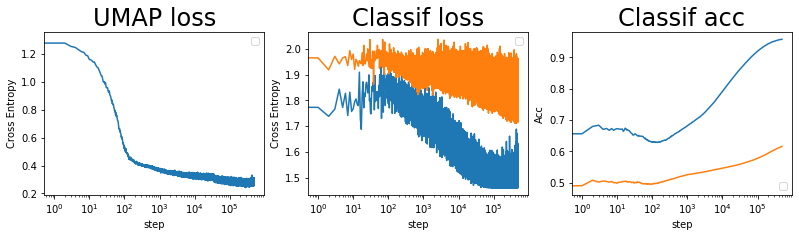

batch: 495000 | train acc: 0.9579 | val acc: 0.6159


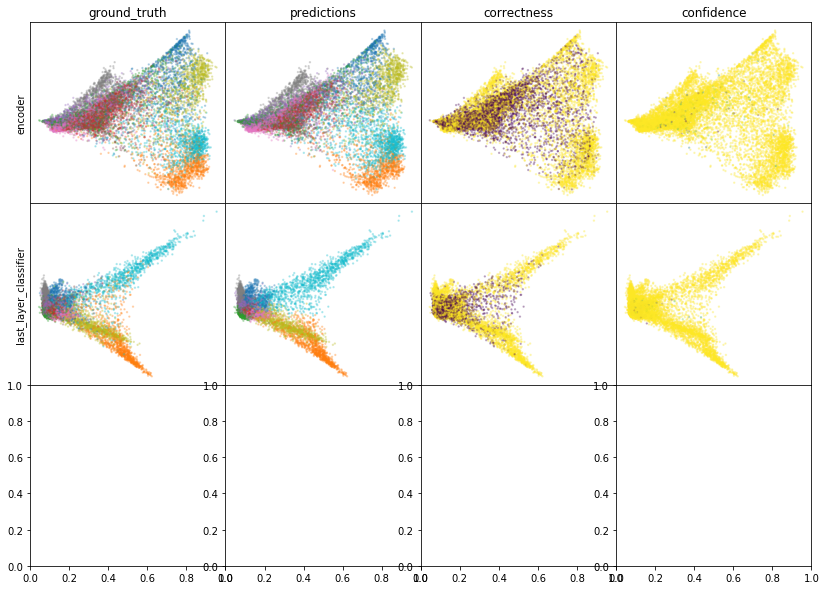

W0808 05:36:16.177847 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:36:17.952460 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:36:19.587652 140336071132928 legend.py:1282] No handles with labels found to put in legend.


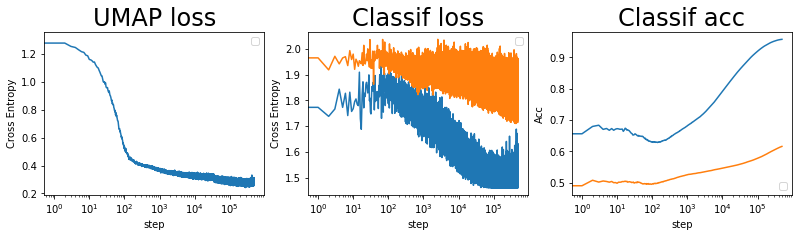

batch: 496000 | train acc: 0.9579 | val acc: 0.6159


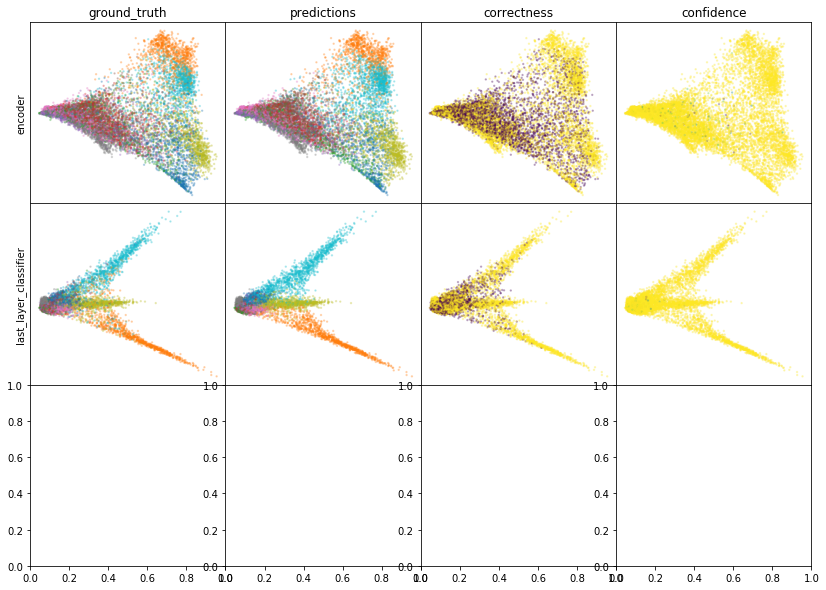

W0808 05:43:16.927046 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:18.837402 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:20.560417 140336071132928 legend.py:1282] No handles with labels found to put in legend.


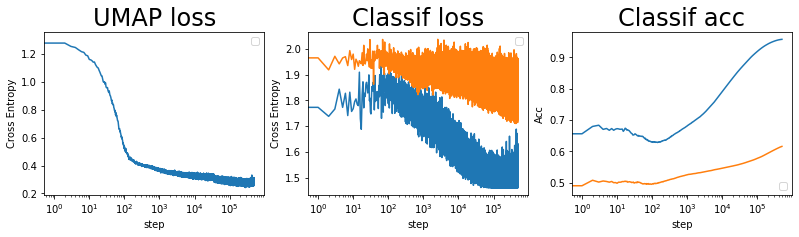

batch: 497000 | train acc: 0.9579 | val acc: 0.6159


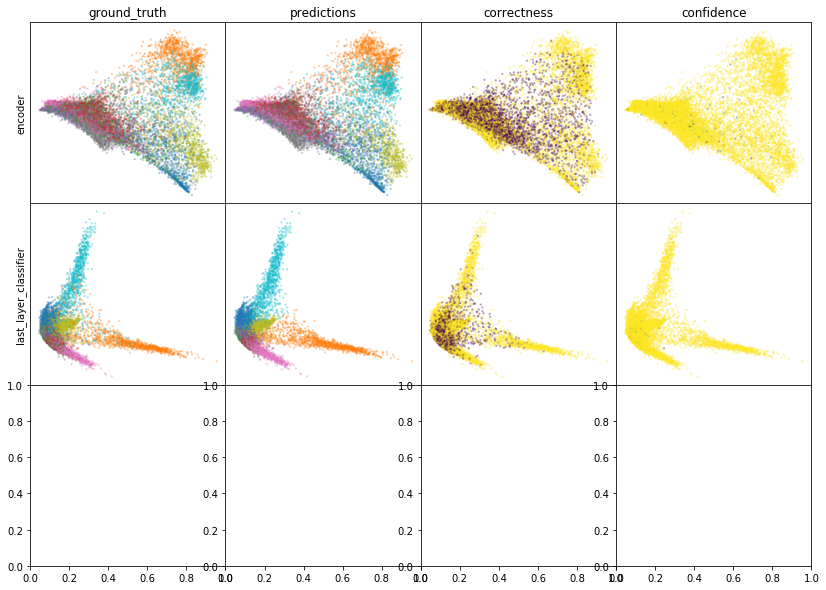

W0808 05:50:38.972345 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:50:40.796458 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:50:42.427861 140336071132928 legend.py:1282] No handles with labels found to put in legend.


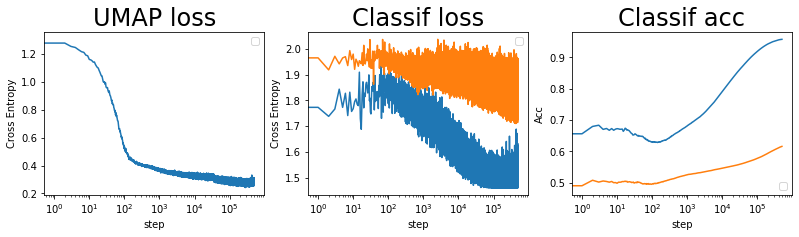

batch: 498000 | train acc: 0.958 | val acc: 0.616


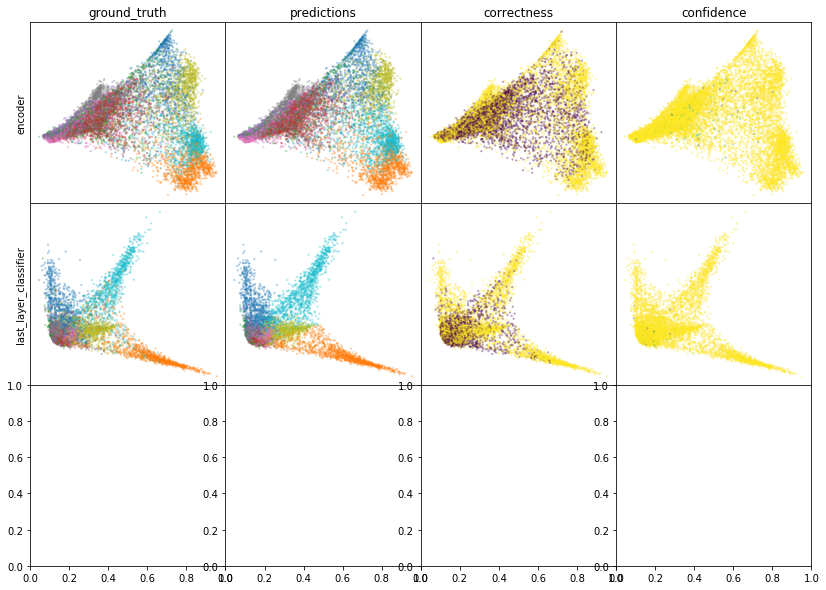

W0808 05:57:07.169071 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:08.957221 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:10.630744 140336071132928 legend.py:1282] No handles with labels found to put in legend.


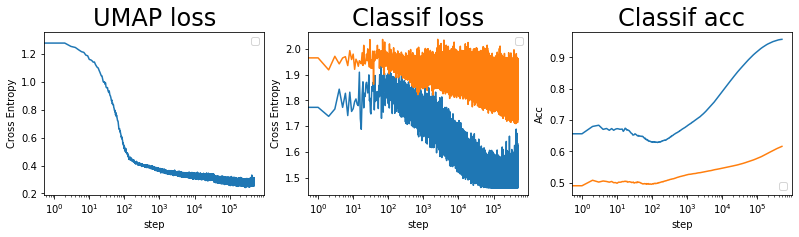

batch: 499000 | train acc: 0.958 | val acc: 0.616


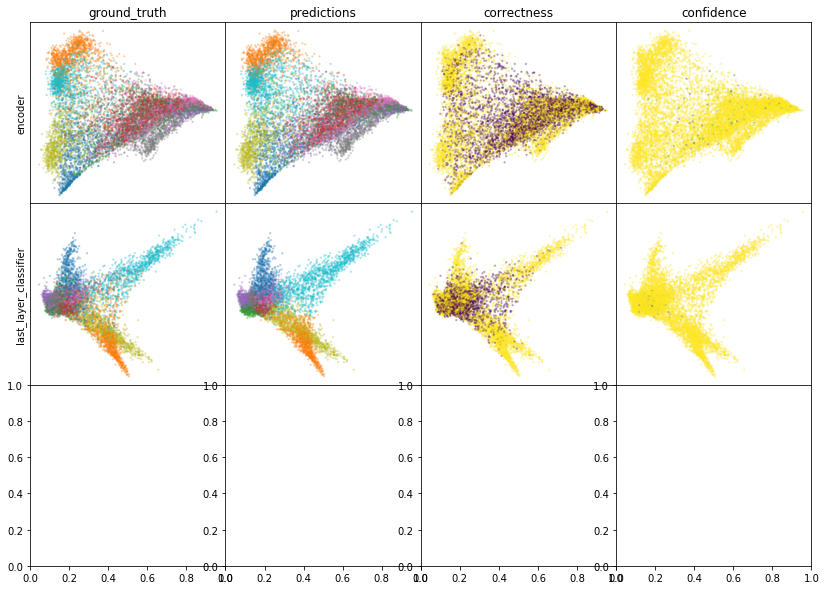

W0808 06:04:25.428203 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:04:27.244374 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:04:28.920144 140336071132928 legend.py:1282] No handles with labels found to put in legend.


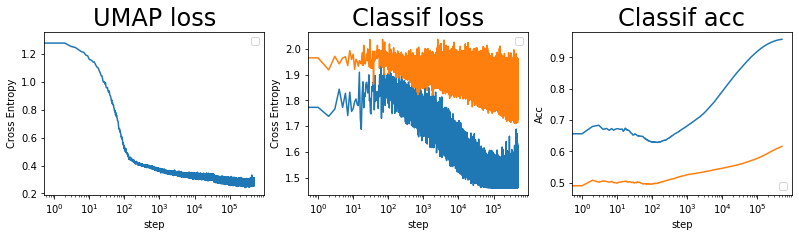

batch: 500000 | train acc: 0.958 | val acc: 0.6161


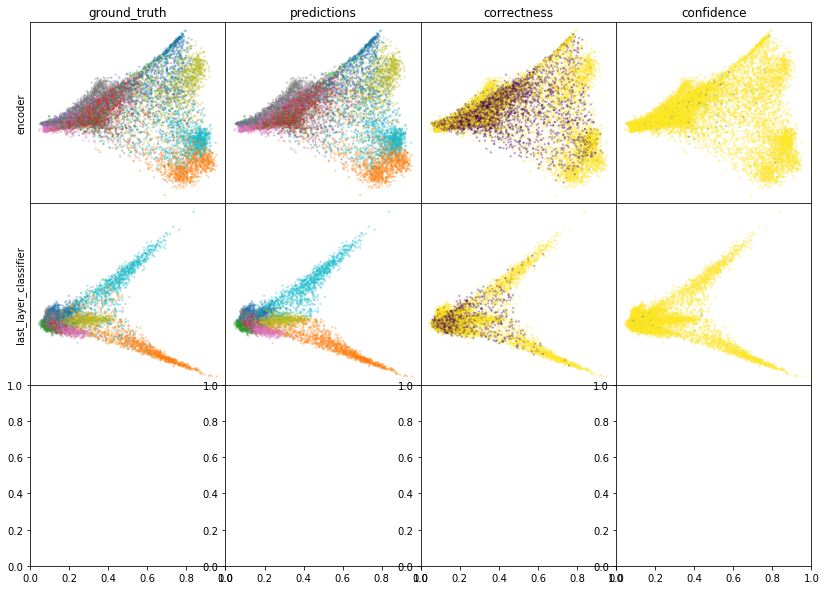

W0808 06:11:03.310149 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:11:05.096830 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:11:06.753984 140336071132928 legend.py:1282] No handles with labels found to put in legend.


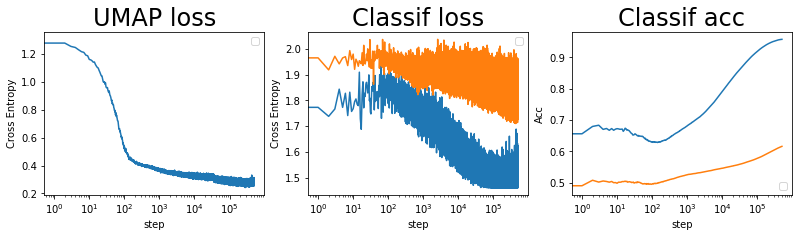

batch: 501000 | train acc: 0.958 | val acc: 0.6161


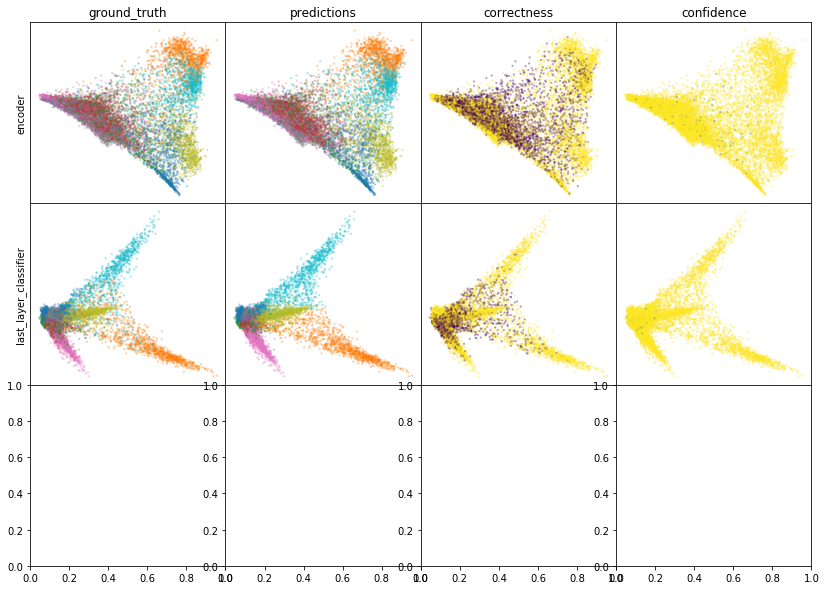

W0808 06:18:08.475614 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:10.296507 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:11.975561 140336071132928 legend.py:1282] No handles with labels found to put in legend.


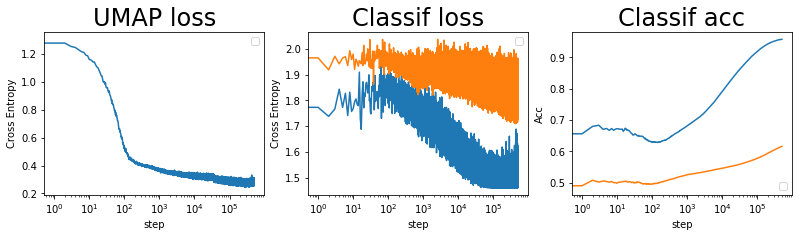

batch: 502000 | train acc: 0.958 | val acc: 0.6161


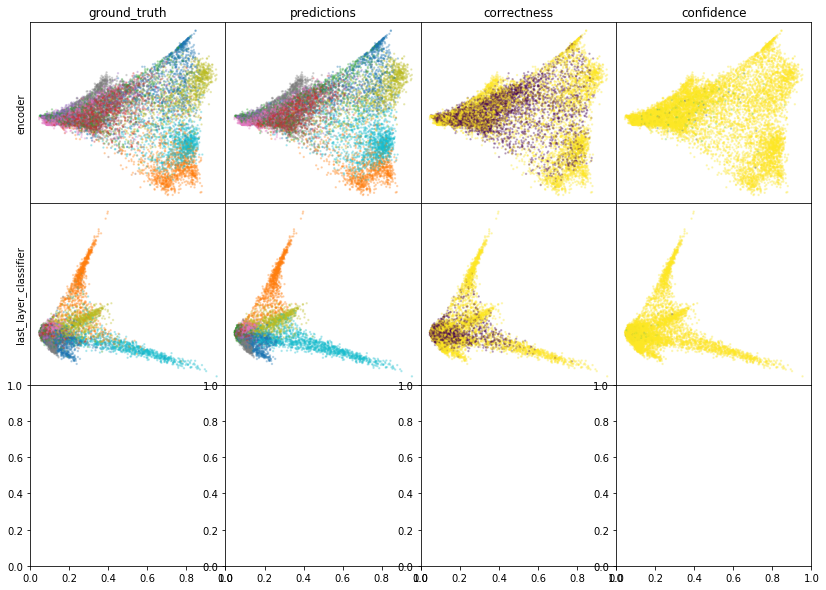

W0808 06:25:09.810940 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:25:11.663143 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:25:13.347566 140336071132928 legend.py:1282] No handles with labels found to put in legend.


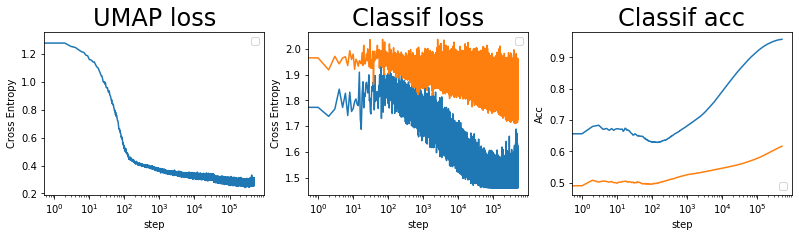

batch: 503000 | train acc: 0.958 | val acc: 0.6161


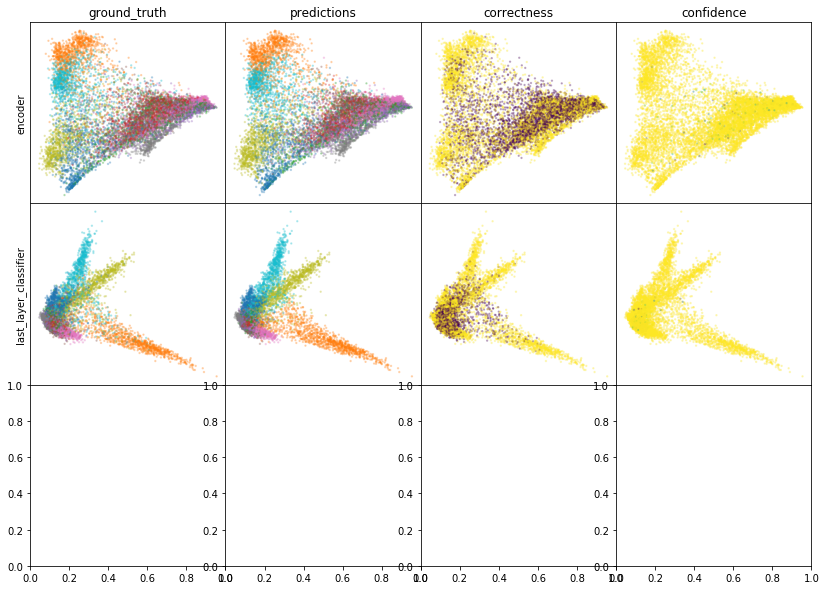

W0808 06:32:39.843075 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:32:41.672201 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:32:43.323421 140336071132928 legend.py:1282] No handles with labels found to put in legend.


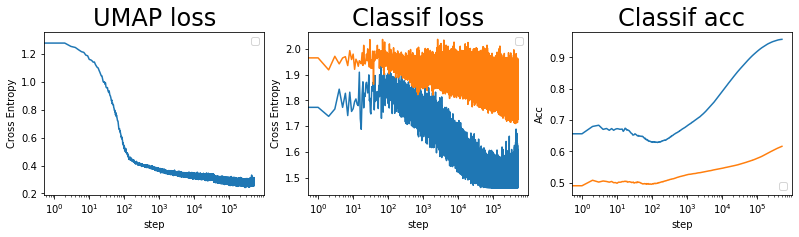

batch: 504000 | train acc: 0.958 | val acc: 0.6162


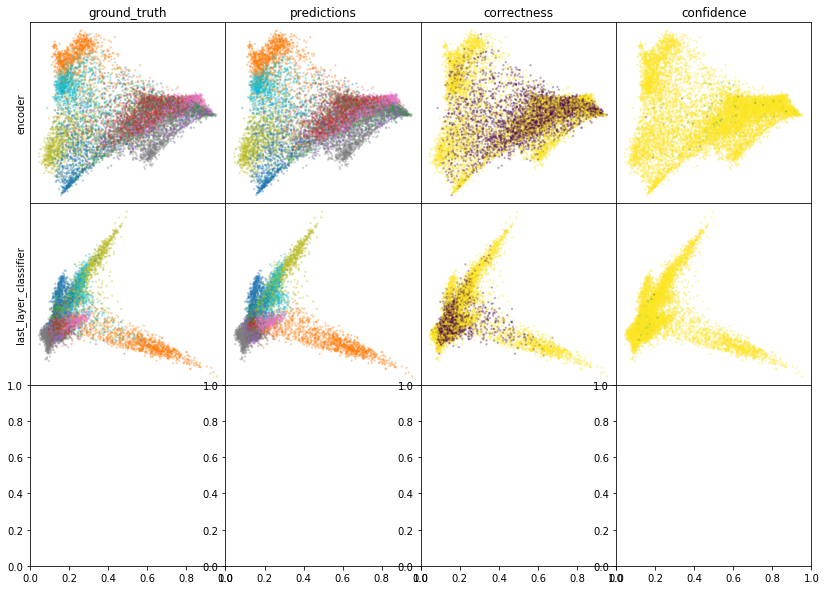

W0808 06:39:09.153464 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:39:11.040388 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:39:12.731185 140336071132928 legend.py:1282] No handles with labels found to put in legend.


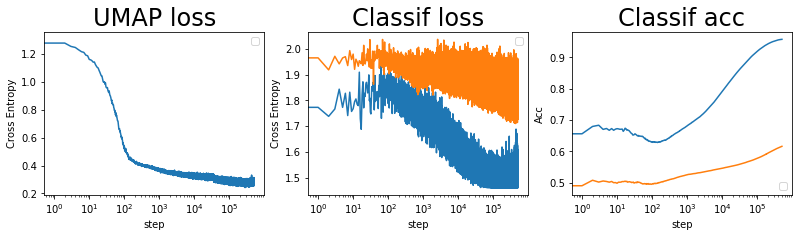

batch: 505000 | train acc: 0.958 | val acc: 0.6162


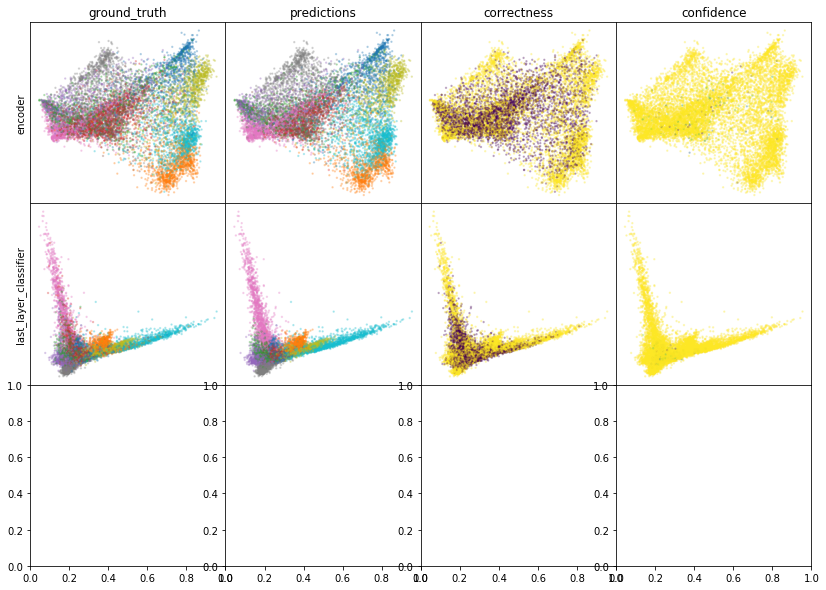

W0808 06:46:24.085309 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:25.911831 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:27.564173 140336071132928 legend.py:1282] No handles with labels found to put in legend.


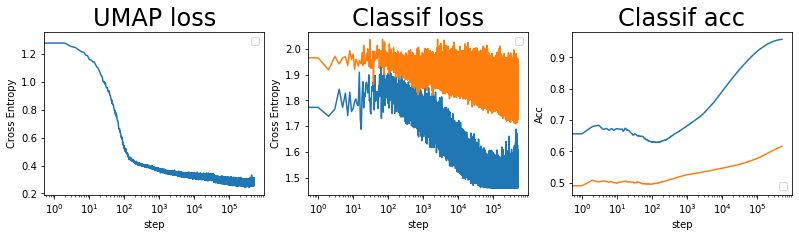

batch: 506000 | train acc: 0.958 | val acc: 0.6162


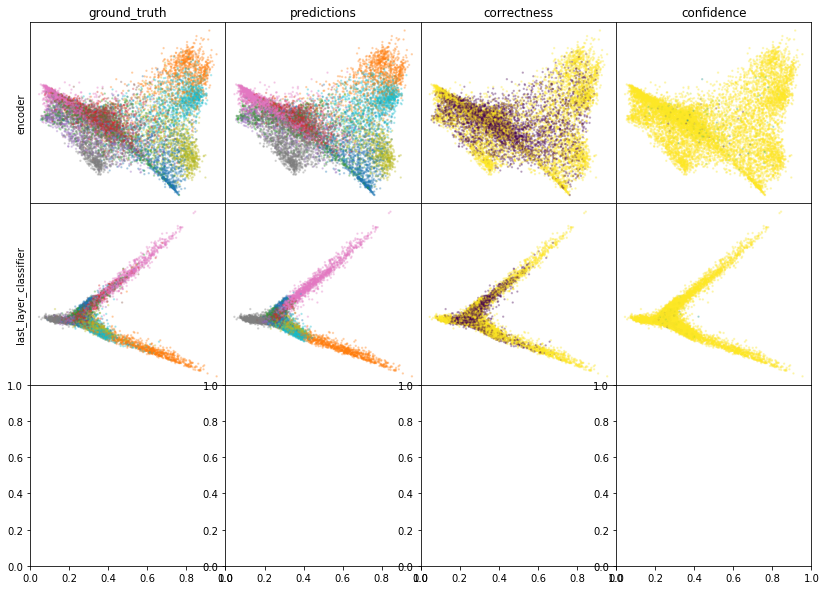

W0808 06:53:49.319575 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:53:51.263169 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 06:53:53.108136 140336071132928 legend.py:1282] No handles with labels found to put in legend.


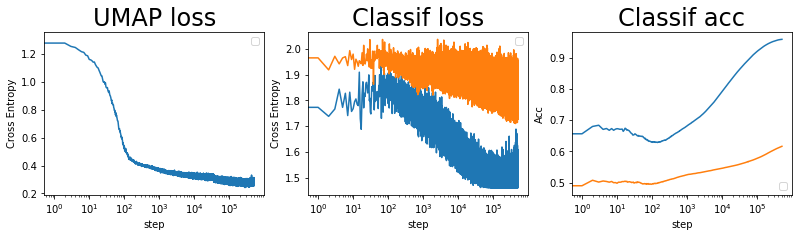

batch: 507000 | train acc: 0.958 | val acc: 0.6163


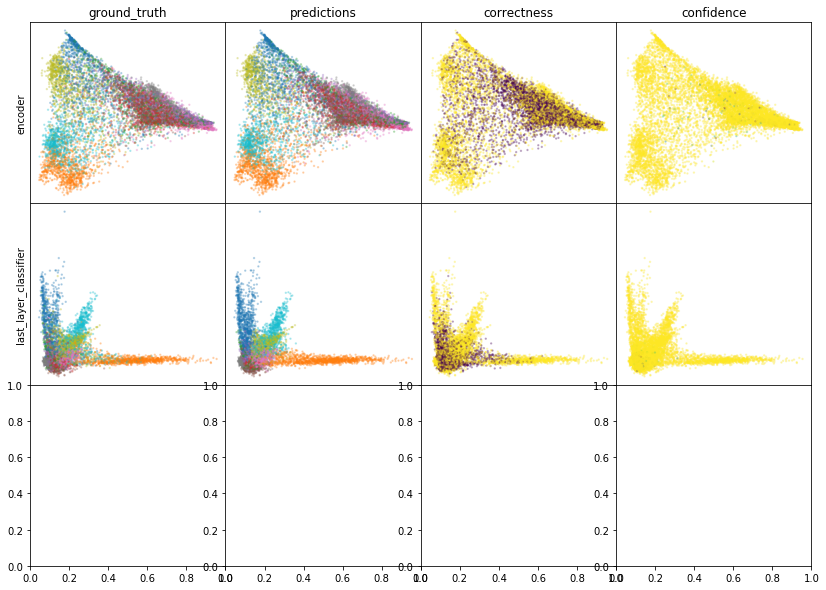

W0808 07:01:04.179242 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:06.074072 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:07.825722 140336071132928 legend.py:1282] No handles with labels found to put in legend.


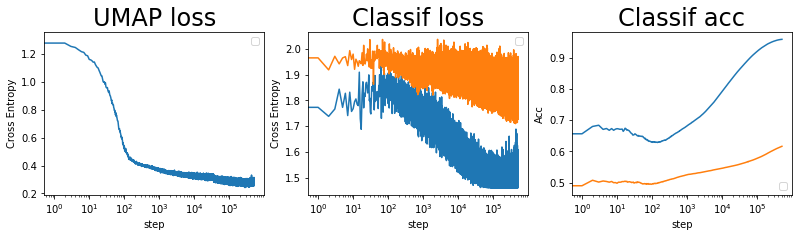

batch: 508000 | train acc: 0.958 | val acc: 0.6163


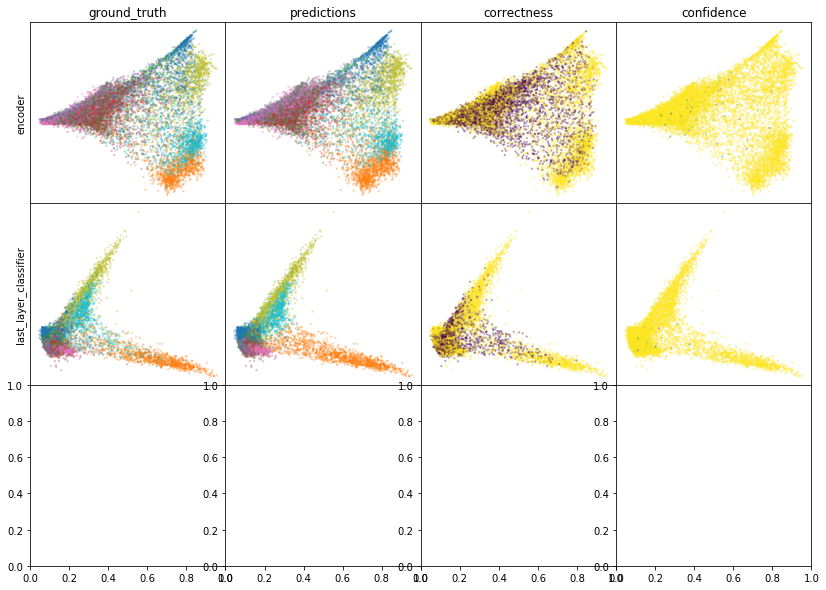

W0808 07:08:08.927738 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:08:10.798793 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:08:12.470800 140336071132928 legend.py:1282] No handles with labels found to put in legend.


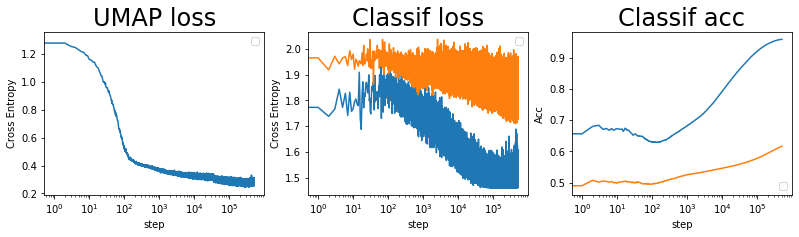

batch: 509000 | train acc: 0.9581 | val acc: 0.6163


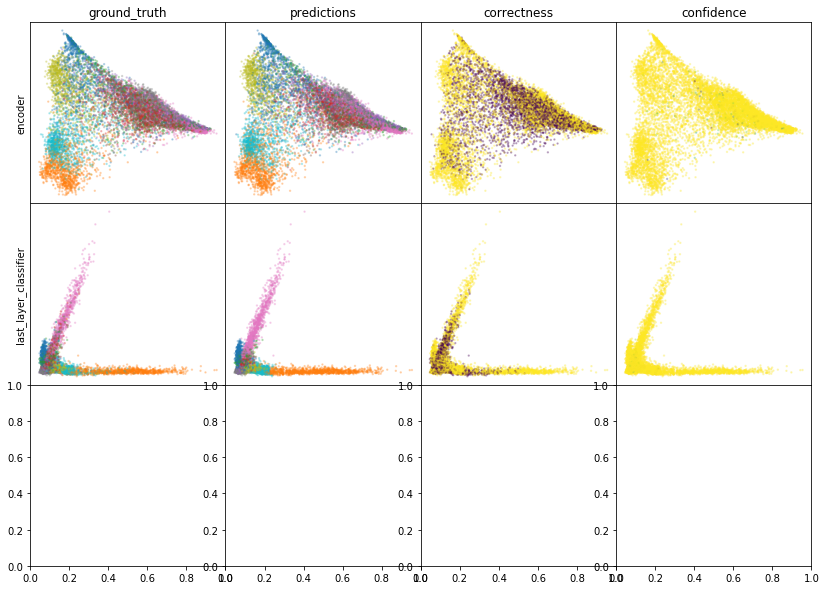

W0808 07:15:43.617641 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:15:45.513830 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:15:47.290189 140336071132928 legend.py:1282] No handles with labels found to put in legend.


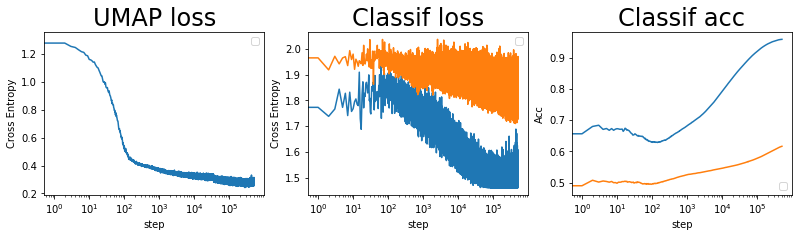

batch: 510000 | train acc: 0.9581 | val acc: 0.6163
saving weights | batch = 510793 | acc = 61.637


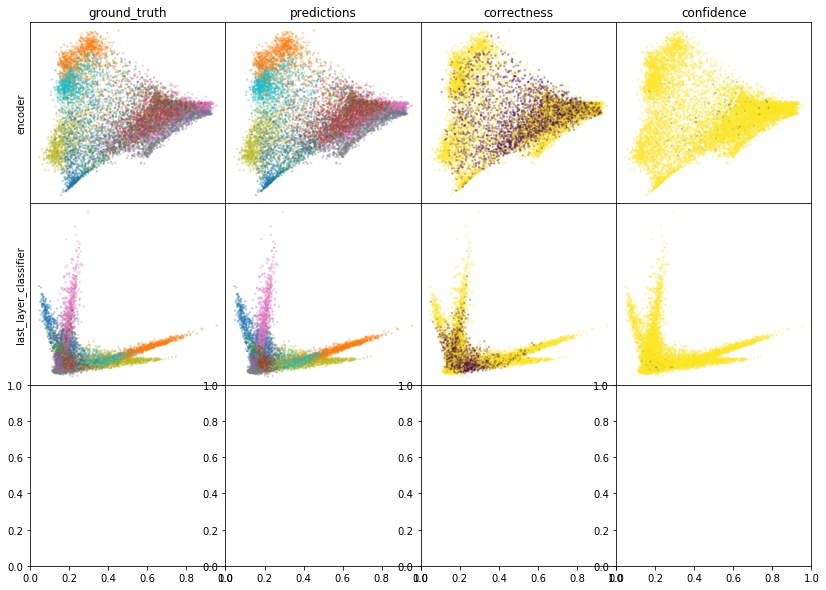

W0808 07:22:08.450027 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:22:10.401487 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:22:12.093281 140336071132928 legend.py:1282] No handles with labels found to put in legend.


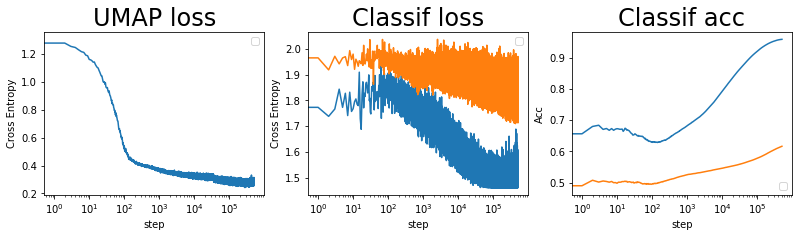

batch: 511000 | train acc: 0.9581 | val acc: 0.6164


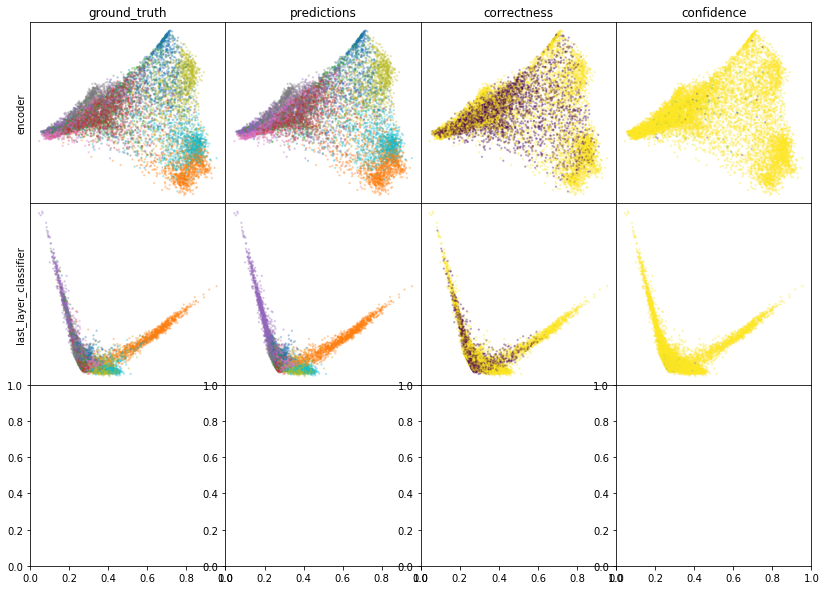

W0808 07:29:12.974702 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:29:14.823504 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:29:16.485027 140336071132928 legend.py:1282] No handles with labels found to put in legend.


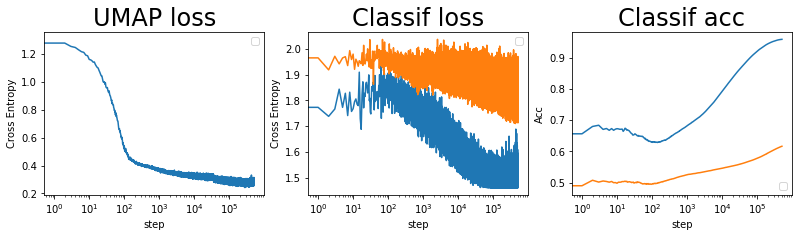

batch: 512000 | train acc: 0.9581 | val acc: 0.6164


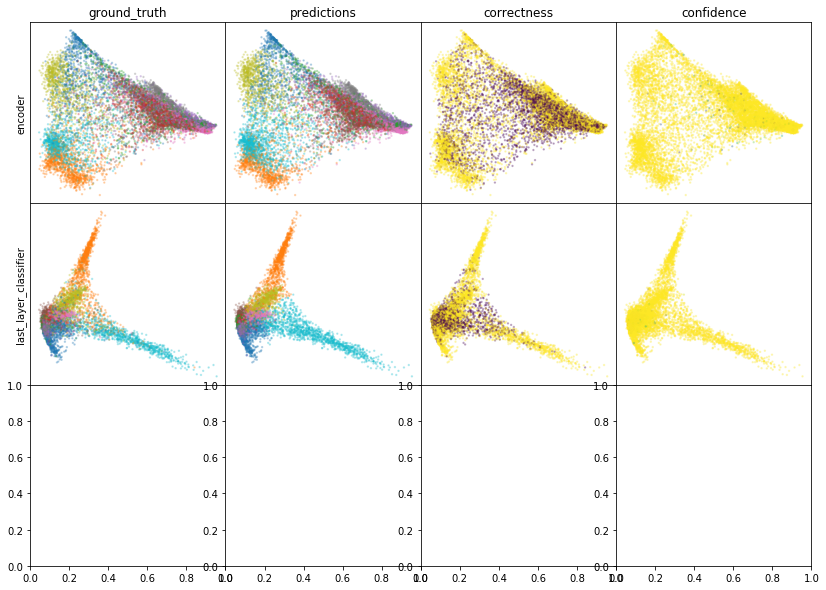

W0808 07:36:17.913542 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:36:19.813389 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:36:21.531736 140336071132928 legend.py:1282] No handles with labels found to put in legend.


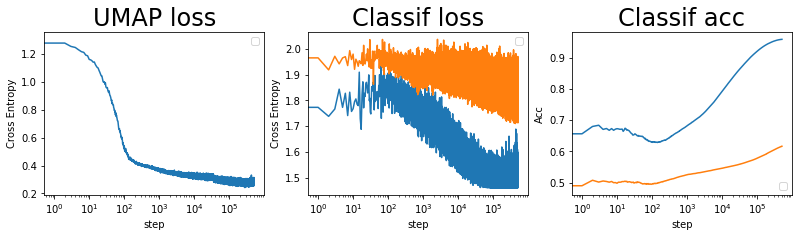

batch: 513000 | train acc: 0.9581 | val acc: 0.6165


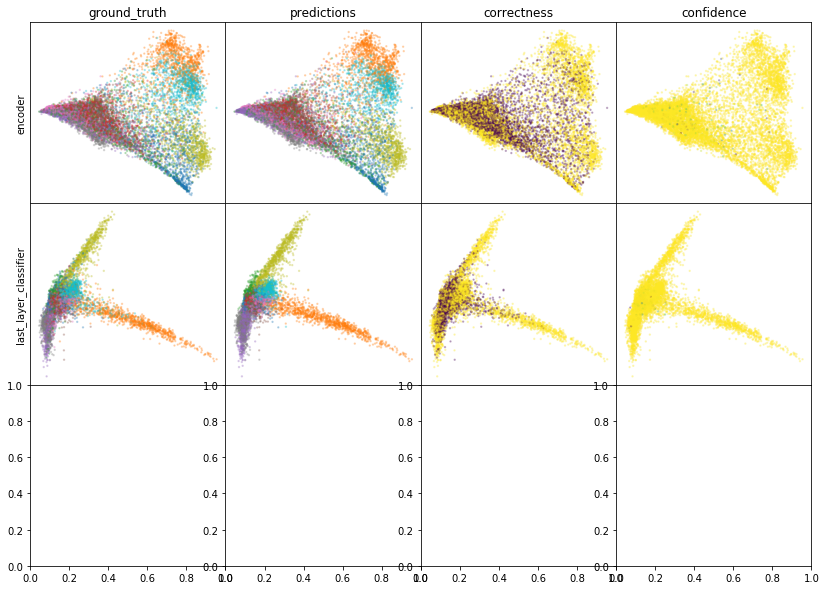

W0808 07:44:00.972647 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:44:02.874389 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:44:04.603945 140336071132928 legend.py:1282] No handles with labels found to put in legend.


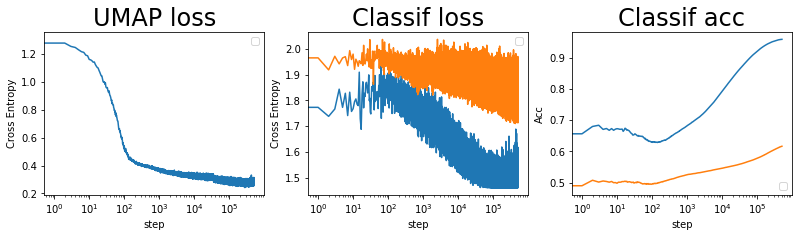

batch: 514000 | train acc: 0.9581 | val acc: 0.6165


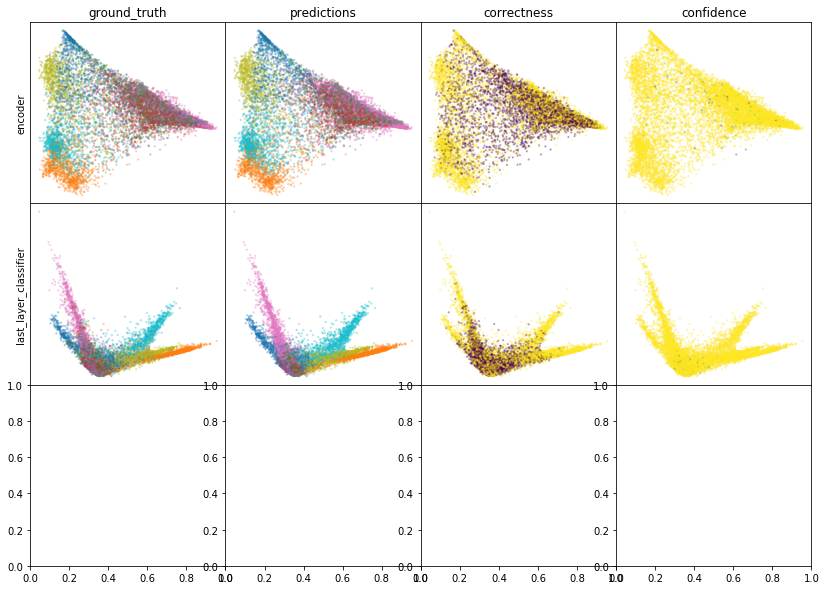

W0808 07:50:43.262844 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:50:45.150868 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:50:46.871601 140336071132928 legend.py:1282] No handles with labels found to put in legend.


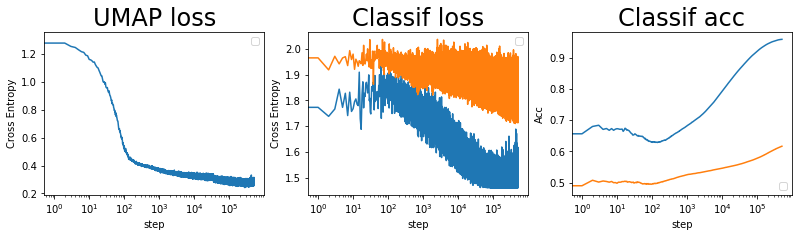

batch: 515000 | train acc: 0.9581 | val acc: 0.6165


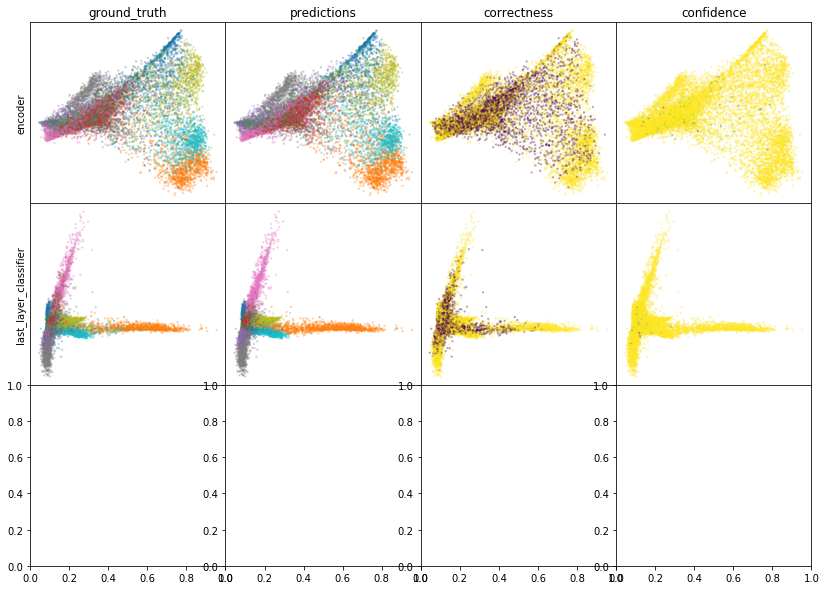

W0808 07:58:03.357178 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:58:05.226540 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 07:58:06.923801 140336071132928 legend.py:1282] No handles with labels found to put in legend.


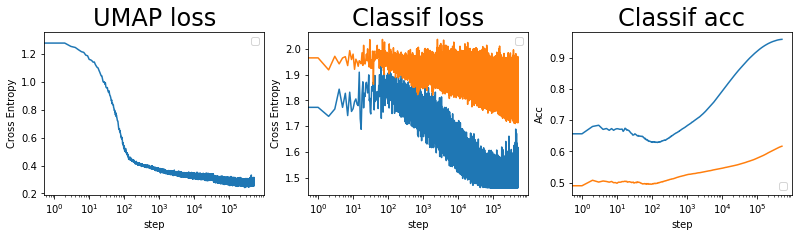

batch: 516000 | train acc: 0.9581 | val acc: 0.6166


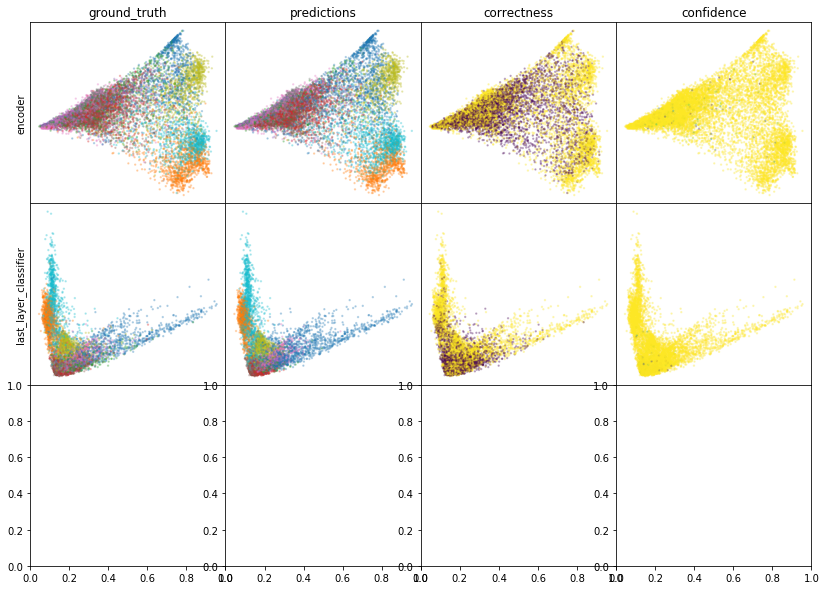

W0808 08:04:44.472666 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:04:46.404824 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:04:48.134993 140336071132928 legend.py:1282] No handles with labels found to put in legend.


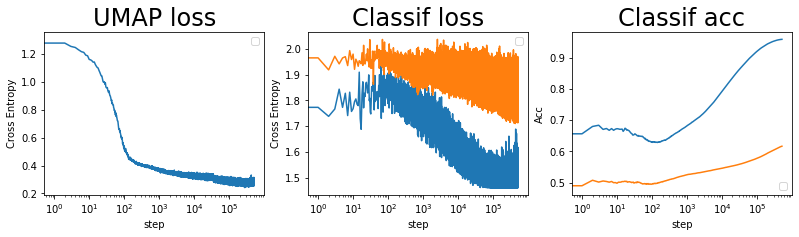

batch: 517000 | train acc: 0.9581 | val acc: 0.6166


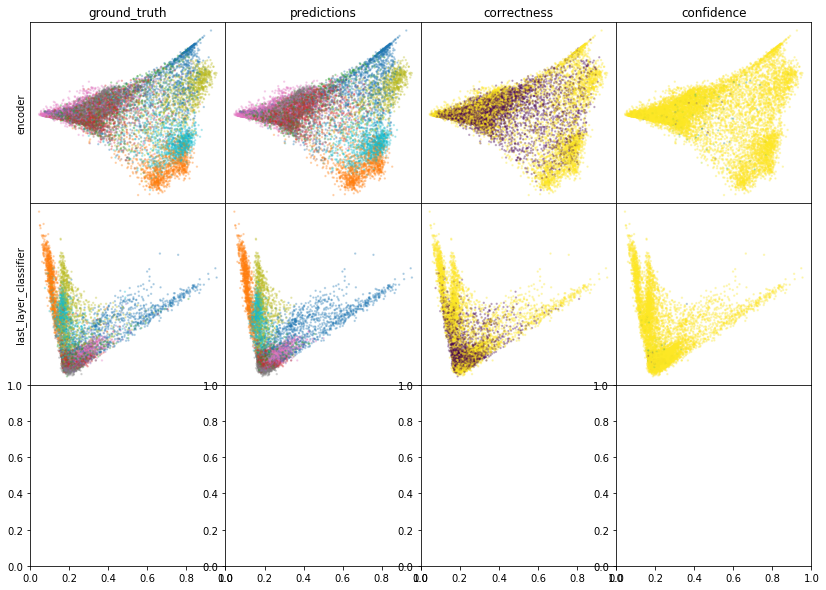

W0808 08:12:05.023608 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:06.910336 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:08.655649 140336071132928 legend.py:1282] No handles with labels found to put in legend.


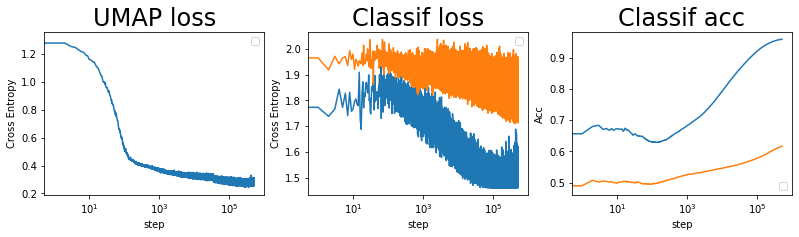

batch: 518000 | train acc: 0.9581 | val acc: 0.6166


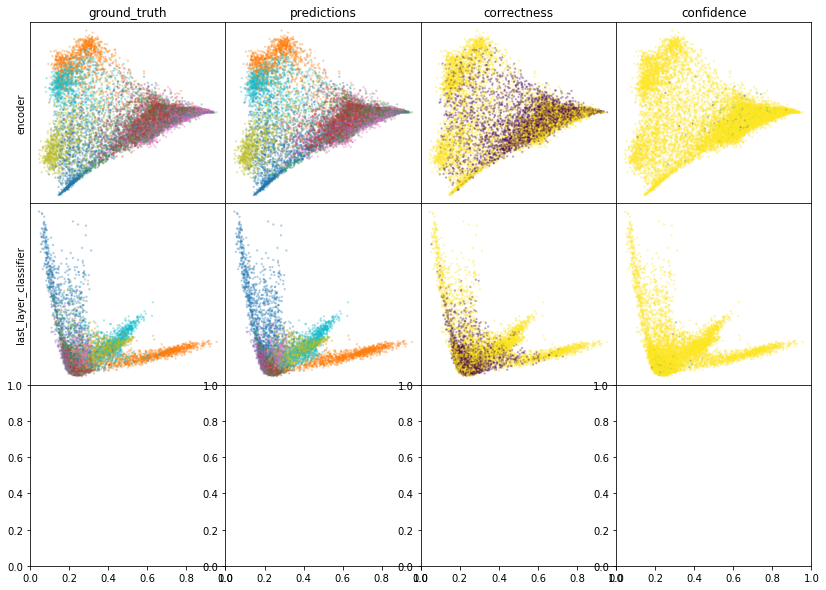

W0808 08:19:10.895978 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:12.813978 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:14.587920 140336071132928 legend.py:1282] No handles with labels found to put in legend.


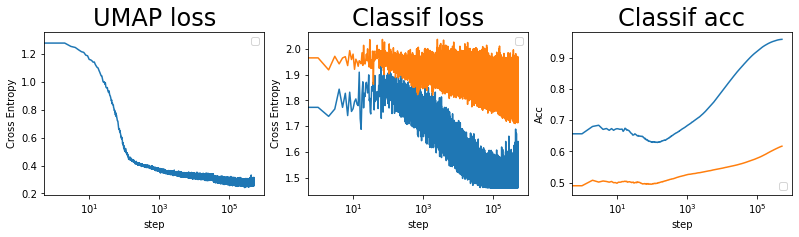

batch: 519000 | train acc: 0.9581 | val acc: 0.6166


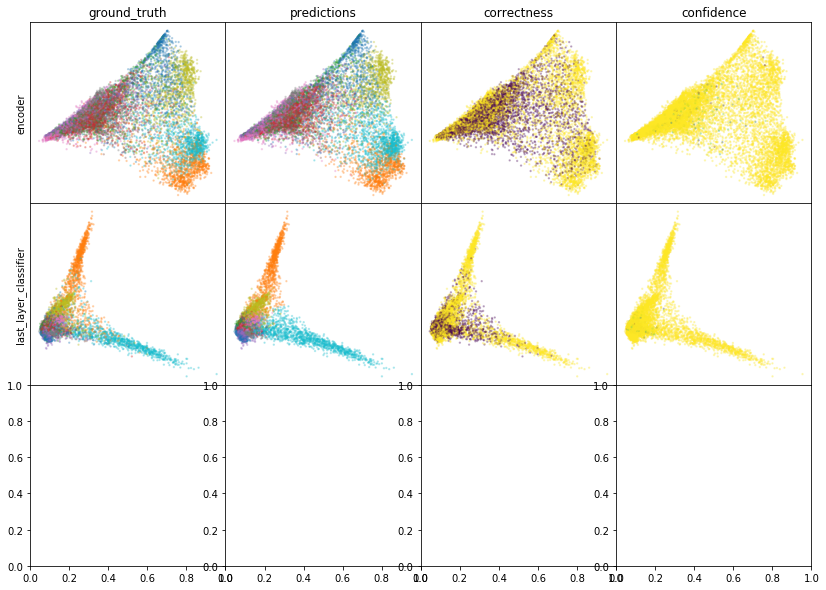

W0808 08:26:43.695547 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:26:45.554290 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:26:47.230580 140336071132928 legend.py:1282] No handles with labels found to put in legend.


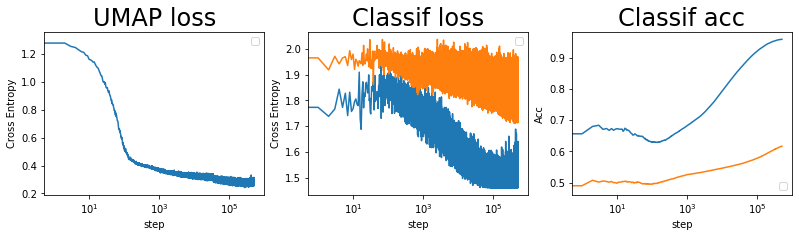

batch: 520000 | train acc: 0.9581 | val acc: 0.6167


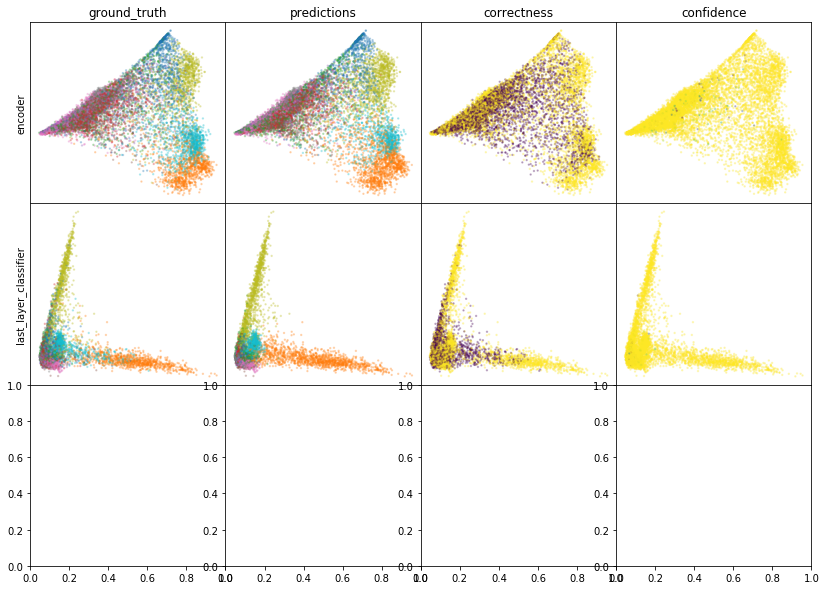

W0808 08:33:38.971160 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:33:40.897404 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:33:42.653682 140336071132928 legend.py:1282] No handles with labels found to put in legend.


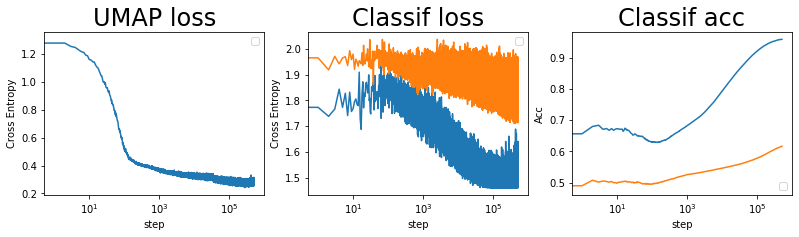

batch: 521000 | train acc: 0.9581 | val acc: 0.6167


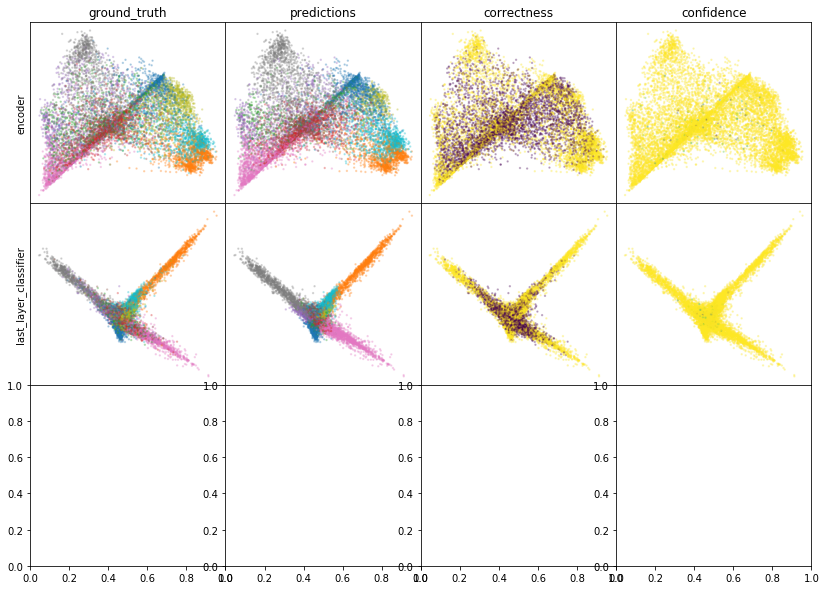

W0808 08:40:59.972685 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:41:01.833034 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:41:03.537404 140336071132928 legend.py:1282] No handles with labels found to put in legend.


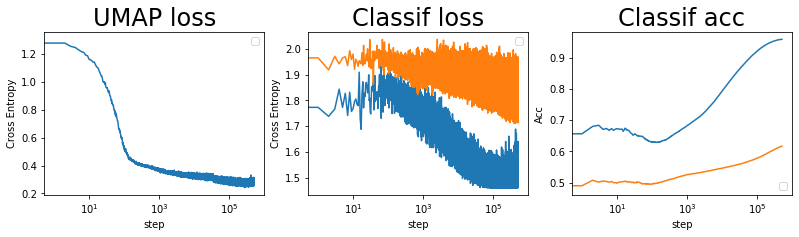

batch: 522000 | train acc: 0.9581 | val acc: 0.6168


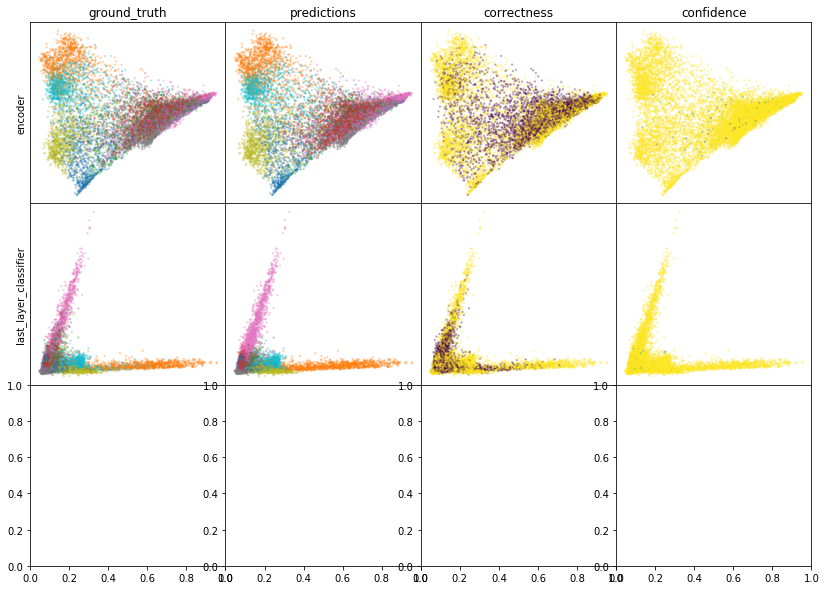

W0808 08:47:25.763399 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:47:27.686833 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 08:47:29.400081 140336071132928 legend.py:1282] No handles with labels found to put in legend.


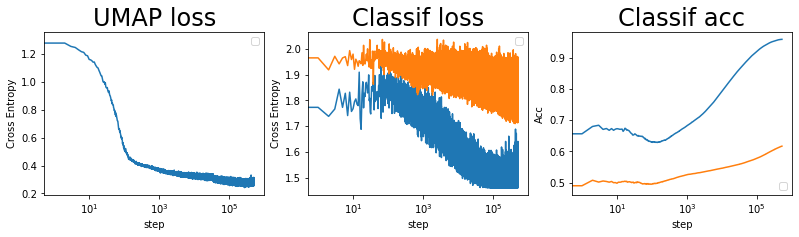

batch: 523000 | train acc: 0.9581 | val acc: 0.6168


In [ ]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):
        
        # redo augmentation if on average, 
        if samples_left <= 0:
            X_train_aug = next(img_data_gen.flow(X_train, shuffle=False, batch_size=len(X_train)))
            samples_left = len(X_train)*repeat_augment_tolerance
        samples_left -= batch_size*2
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train_aug[np.array(batch_to)], batch_from=X_train_aug[np.array(batch_from)], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [83]:
test_enc = model_data(X_test, batch_size, model.encoder)

In [84]:
y_pred = model_data(test_enc, batch_size, model.classifier)

In [85]:
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.6419


In [86]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [87]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Sat Aug  8 13:31:22 2020 Finding Nearest Neighbors
Sat Aug  8 13:31:22 2020 Building RP forest with 15 trees
Sat Aug  8 13:31:22 2020 parallel NN descent for 15 iterations
	 0  /  15
	 1  /  15
	 2  /  15
	 3  /  15
Sat Aug  8 13:31:25 2020 Finished Nearest Neighbor Search
Sat Aug  8 13:31:25 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Aug  8 13:31:55 2020 Finished embedding


In [88]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.6394


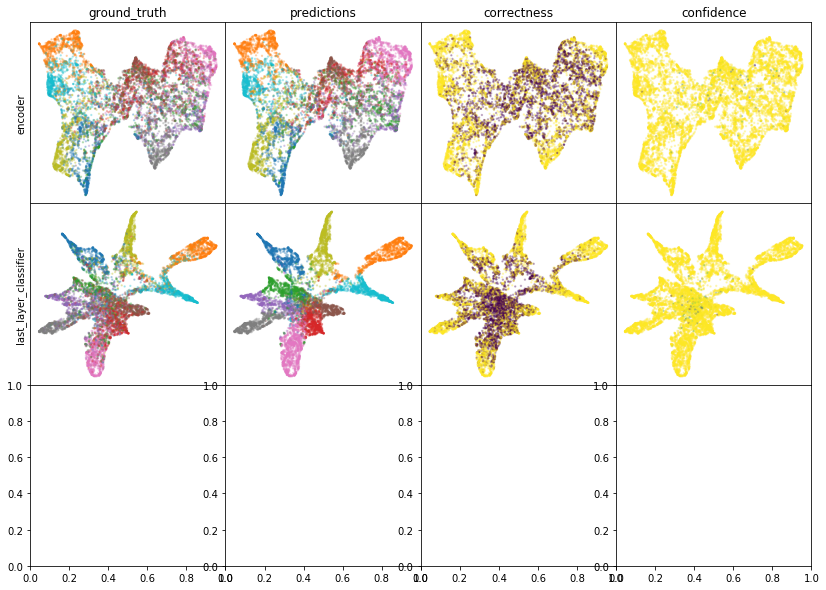

W0808 13:36:42.364480 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 13:36:44.227085 140336071132928 legend.py:1282] No handles with labels found to put in legend.
W0808 13:36:45.932951 140336071132928 legend.py:1282] No handles with labels found to put in legend.


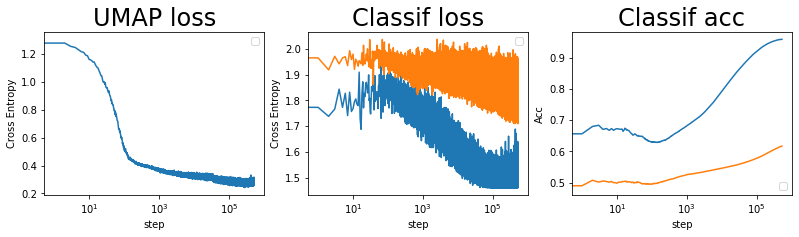

In [89]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')